# Setup

In [1]:
%pip install ultralytics
import ultralytics
ultralytics.checks()

Ultralytics YOLOv8.2.79  Python-3.11.7 torch-2.3.1+cpu CPU (Intel Core(TM) i5-4300U 1.90GHz)
Setup complete  (4 CPUs, 7.9 GB RAM, 157.1/237.9 GB disk)


In [40]:
%pip install supervision pytube

   ---------------------------------------- 0.0/57.6 kB ? eta -:--:--
   ---------------------------------------- 0.0/57.6 kB ? eta -:--:--
   ---------------------------------------- 0.0/57.6 kB ? eta -:--:--
   ---------------------------------------- 0.0/57.6 kB ? eta -:--:--
   ------- -------------------------------- 10.2/57.6 kB ? eta -:--:--
   ------- -------------------------------- 10.2/57.6 kB ? eta -:--:--
   ------- -------------------------------- 10.2/57.6 kB ? eta -:--:--
   ------- -------------------------------- 10.2/57.6 kB ? eta -:--:--
   ------- -------------------------------- 10.2/57.6 kB ? eta -:--:--
   ------- -------------------------------- 10.2/57.6 kB ? eta -:--:--
   ------- -------------------------------- 10.2/57.6 kB ? eta -:--:--
   ------- -------------------------------- 10.2/57.6 kB ? eta -:--:--
   ---------------------------- ----------- 41.0/57.6 kB 75.7 kB/s eta 0:00:01
   ---------------------------- ----------- 41.0/57.6 kB 75.7 kB/s eta 0:


[notice] A new release of pip is available: 24.1.2 -> 24.2
[notice] To update, run: python.exe -m pip install --upgrade pip


# 1st Dataset from Roboflow

In [ ]:
!pip install roboflow

from roboflow import Roboflow
rf = Roboflow(api_key="IJqopp3PgIEHEhg8XFkZ")
project = rf.workspace("cc-tv-footage-annotation-b10").project("cc-tv-footage-annotation-b10")
version = project.version(4)
dataset = version.download("yolov8-obb")

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 78.8/78.8 kB 7.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 54.5/54.5 kB 5.8 MB/s eta 0:00:00
loading Roboflow workspace...
loading Roboflow project...



Extracting Dataset Version Zip to CC-TV-Footage-Annotation-B10-4 in yolov8-obb:: 100%|██████████| 5988/5988 [00:00<00:00, 6460.58it/s]


# Train YOLOv8m on 1st version of Dataset

In [ ]:
from ultralytics import YOLO

# Load a model
model = YOLO('yolov8m.pt')  # load a pretrained model
# Use the model
results = model.train(data='/content/CC-TV-Footage-Annotation-B10-4/data.yaml', epochs=50)  # train the model
results = model.val()  # evaluate model performance on the validation set

100%|██████████| 49.7M/49.7M [00:00<00:00, 604MB/s]


Ultralytics YOLOv8.2.77 🚀 Python-3.10.12 torch-2.3.1+cu121 CUDA:0 (NVIDIA L4, 22700MiB)
engine/trainer: task=detect, mode=train, model=yolov8m.pt, data=/content/CC-TV-Footage-Annotation-B10-4/data.yaml, epochs=50, time=None, patience=100, batch=16, imgsz=640, save=True, save_period=-1, cache=False, device=None, workers=8, project=None, name=train, exist_ok=False, pretrained=True, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, multi_scale=False, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, vid_stride=1, stream_buffer=False, visualize=False, augment=False, agnostic_nms=False, classes=None, retina_masks=False, embed=None, show=False, save_frames=False, save_txt=False, save_conf=False, save_crop=False, show_labels=Tru

100%|██████████| 755k/755k [00:00<00:00, 143MB/s]


Overriding model.yaml nc=80 with nc=5

                   from  n    params  module                                       arguments                     
  0                  -1  1      1392  ultralytics.nn.modules.conv.Conv             [3, 48, 3, 2]                 
  1                  -1  1     41664  ultralytics.nn.modules.conv.Conv             [48, 96, 3, 2]                
  2                  -1  2    111360  ultralytics.nn.modules.block.C2f             [96, 96, 2, True]             
  3                  -1  1    166272  ultralytics.nn.modules.conv.Conv             [96, 192, 3, 2]               
  4                  -1  4    813312  ultralytics.nn.modules.block.C2f             [192, 192, 4, True]           
  5                  -1  1    664320  ultralytics.nn.modules.conv.Conv             [192, 384, 3, 2]              
  6                  -1  4   3248640  ultralytics.nn.modules.block.C2f             [384, 384, 4, True]           
  7                  -1  1   1991808  ultralytics

100%|██████████| 6.25M/6.25M [00:00<00:00, 338MB/s]


AMP: checks passed ✅


train: Scanning /content/CC-TV-Footage-Annotation-B10-4/train/labels... 2231 images, 0 backgrounds, 0 corrupt: 100%|██████████| 2231/2231 [00:02<00:00, 1108.87it/s]


train: New cache created: /content/CC-TV-Footage-Annotation-B10-4/train/labels.cache
albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01), CLAHE(p=0.01, clip_limit=(1, 4.0), tile_grid_size=(8, 8))


os.fork() was called. os.fork() is incompatible with multithreaded code, and JAX is multithreaded, so this will likely lead to a deadlock.
val: Scanning /content/CC-TV-Footage-Annotation-B10-4/valid/labels... 471 images, 2 backgrounds, 0 corrupt: 100%|██████████| 471/471 [00:00<00:00, 936.89it/s]


val: New cache created: /content/CC-TV-Footage-Annotation-B10-4/valid/labels.cache
Plotting labels to runs/detect/train/labels.jpg... 
optimizer: 'optimizer=auto' found, ignoring 'lr0=0.01' and 'momentum=0.937' and determining best 'optimizer', 'lr0' and 'momentum' automatically... 
optimizer: AdamW(lr=0.001111, momentum=0.9) with parameter groups 77 weight(decay=0.0), 84 weight(decay=0.0005), 83 bias(decay=0.0)
TensorBoard: model graph visualization added ✅
Image sizes 640 train, 640 val
Using 8 dataloader workers
Logging results to runs/detect/train
Starting training for 50 epochs...

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       1/50      6.85G       1.77      2.227      1.831         59        640: 100%|██████████| 140/140 [00:46<00:00,  3.02it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 15/15 [00:05<00:00,  2.80it/s]

                   all        471       1186      0.726       0.12      0.107     0.0271



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       2/50      6.71G      1.674      1.765      1.743         33        640: 100%|██████████| 140/140 [00:42<00:00,  3.26it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 15/15 [00:04<00:00,  3.44it/s]

                   all        471       1186      0.495     0.0677     0.0768     0.0215



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       3/50       6.8G      1.679      1.747      1.735         34        640: 100%|██████████| 140/140 [00:42<00:00,  3.33it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 15/15 [00:04<00:00,  3.44it/s]

                   all        471       1186       0.04      0.128     0.0379     0.0108



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       4/50       6.7G      1.582      1.598      1.662         34        640: 100%|██████████| 140/140 [00:42<00:00,  3.32it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 15/15 [00:04<00:00,  3.45it/s]

                   all        471       1186      0.518      0.117     0.0746     0.0299



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       5/50      6.69G      1.523      1.468      1.616         29        640: 100%|██████████| 140/140 [00:41<00:00,  3.34it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 15/15 [00:04<00:00,  3.36it/s]

                   all        471       1186      0.121      0.173     0.0998     0.0367



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       6/50      6.71G      1.424      1.378      1.542         35        640: 100%|██████████| 140/140 [00:42<00:00,  3.33it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 15/15 [00:04<00:00,  3.47it/s]

                   all        471       1186      0.326      0.141     0.0906     0.0476



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       7/50      6.71G      1.373      1.299      1.512         26        640: 100%|██████████| 140/140 [00:42<00:00,  3.33it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 15/15 [00:04<00:00,  3.48it/s]

                   all        471       1186      0.788     0.0849      0.107      0.052



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       8/50      6.71G      1.323      1.222      1.481         43        640: 100%|██████████| 140/140 [00:42<00:00,  3.32it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 15/15 [00:04<00:00,  3.50it/s]

                   all        471       1186      0.245      0.131      0.154     0.0699



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       9/50       6.7G      1.294      1.191      1.461         30        640: 100%|██████████| 140/140 [00:41<00:00,  3.33it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 15/15 [00:04<00:00,  3.49it/s]

                   all        471       1186      0.528      0.105       0.14     0.0709



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      10/50      6.71G      1.239      1.116      1.433         27        640: 100%|██████████| 140/140 [00:42<00:00,  3.33it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 15/15 [00:04<00:00,  3.52it/s]

                   all        471       1186      0.333      0.116      0.137     0.0626



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      11/50       6.7G      1.234      1.088      1.421         36        640: 100%|██████████| 140/140 [00:42<00:00,  3.33it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 15/15 [00:04<00:00,  3.50it/s]

                   all        471       1186      0.711      0.114      0.157     0.0706



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      12/50      6.71G      1.191      1.038      1.405         29        640: 100%|██████████| 140/140 [00:42<00:00,  3.33it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 15/15 [00:04<00:00,  3.50it/s]

                   all        471       1186      0.339      0.128      0.145     0.0678



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      13/50       6.7G      1.164      1.025      1.379         31        640: 100%|██████████| 140/140 [00:41<00:00,  3.34it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 15/15 [00:04<00:00,  3.48it/s]

                   all        471       1186      0.243      0.149      0.139     0.0628



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      14/50       6.7G      1.139     0.9899      1.361         26        640: 100%|██████████| 140/140 [00:42<00:00,  3.33it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 15/15 [00:04<00:00,  3.47it/s]

                   all        471       1186      0.231      0.139      0.146     0.0716



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      15/50       6.7G      1.096     0.9396      1.343         31        640: 100%|██████████| 140/140 [00:42<00:00,  3.32it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 15/15 [00:04<00:00,  3.49it/s]

                   all        471       1186      0.361      0.138       0.15     0.0588



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      16/50      6.71G      1.074     0.9372      1.318         39        640: 100%|██████████| 140/140 [00:41<00:00,  3.34it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 15/15 [00:04<00:00,  3.44it/s]

                   all        471       1186      0.277      0.151      0.172     0.0721



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      17/50       6.7G      1.037     0.8794      1.294         33        640: 100%|██████████| 140/140 [00:42<00:00,  3.33it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 15/15 [00:04<00:00,  3.50it/s]

                   all        471       1186      0.258       0.18      0.189     0.0819



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      18/50      6.71G       1.04     0.8811      1.305         32        640: 100%|██████████| 140/140 [00:41<00:00,  3.34it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 15/15 [00:04<00:00,  3.50it/s]

                   all        471       1186      0.371       0.15      0.173     0.0789



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      19/50       6.7G      1.001     0.8484      1.278         27        640: 100%|██████████| 140/140 [00:41<00:00,  3.34it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 15/15 [00:04<00:00,  3.53it/s]

                   all        471       1186      0.382      0.131      0.155     0.0833



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      20/50       6.7G      1.004     0.8356      1.288         27        640: 100%|██████████| 140/140 [00:42<00:00,  3.33it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 15/15 [00:04<00:00,  3.49it/s]

                   all        471       1186       0.35       0.14      0.151     0.0618



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      21/50      6.71G     0.9582     0.7995      1.253         51        640: 100%|██████████| 140/140 [00:41<00:00,  3.34it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 15/15 [00:04<00:00,  3.52it/s]

                   all        471       1186       0.36      0.124      0.129     0.0704



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      22/50       6.7G     0.9517     0.7828      1.244         38        640: 100%|██████████| 140/140 [00:41<00:00,  3.34it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 15/15 [00:04<00:00,  3.50it/s]

                   all        471       1186       0.23      0.148      0.139     0.0646



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      23/50      6.71G     0.9323     0.7582      1.238         41        640: 100%|██████████| 140/140 [00:41<00:00,  3.34it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 15/15 [00:04<00:00,  3.51it/s]

                   all        471       1186      0.338      0.167      0.189     0.0803



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      24/50       6.7G     0.9081     0.7475      1.222         31        640: 100%|██████████| 140/140 [00:41<00:00,  3.34it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 15/15 [00:04<00:00,  3.53it/s]

                   all        471       1186      0.208      0.156      0.154     0.0729



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      25/50       6.7G     0.8949     0.7254      1.209         23        640: 100%|██████████| 140/140 [00:41<00:00,  3.34it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 15/15 [00:04<00:00,  3.53it/s]

                   all        471       1186      0.402      0.131      0.182     0.0871



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      26/50      6.71G      0.882     0.7141      1.203         32        640: 100%|██████████| 140/140 [00:41<00:00,  3.33it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 15/15 [00:04<00:00,  3.51it/s]

                   all        471       1186      0.311      0.152      0.162     0.0719



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      27/50       6.7G     0.8585     0.6996      1.185         32        640: 100%|██████████| 140/140 [00:41<00:00,  3.34it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 15/15 [00:04<00:00,  3.53it/s]

                   all        471       1186      0.298      0.128      0.137     0.0689



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      28/50       6.7G     0.8426     0.6855      1.173         33        640: 100%|██████████| 140/140 [00:41<00:00,  3.34it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 15/15 [00:04<00:00,  3.54it/s]

                   all        471       1186      0.346      0.132      0.142      0.071



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      29/50       6.7G     0.8335     0.6611      1.167         35        640: 100%|██████████| 140/140 [00:41<00:00,  3.34it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 15/15 [00:04<00:00,  3.54it/s]

                   all        471       1186      0.588      0.138      0.149     0.0707



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      30/50      6.71G      0.814     0.6505      1.155         44        640: 100%|██████████| 140/140 [00:41<00:00,  3.34it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 15/15 [00:04<00:00,  3.53it/s]

                   all        471       1186      0.355      0.133      0.137     0.0685



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      31/50      6.71G     0.8055     0.6449      1.146         40        640: 100%|██████████| 140/140 [00:41<00:00,  3.34it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 15/15 [00:04<00:00,  3.50it/s]

                   all        471       1186      0.341       0.14      0.161     0.0756



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      32/50      6.71G     0.7928     0.6354      1.141         35        640: 100%|██████████| 140/140 [00:41<00:00,  3.34it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 15/15 [00:04<00:00,  3.54it/s]

                   all        471       1186      0.338      0.145      0.155     0.0723



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      33/50       6.7G     0.7757     0.6109      1.132         36        640: 100%|██████████| 140/140 [00:41<00:00,  3.34it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 15/15 [00:04<00:00,  3.56it/s]

                   all        471       1186      0.483      0.129      0.152     0.0757



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      34/50       6.7G     0.7656     0.6034       1.12         45        640: 100%|██████████| 140/140 [00:41<00:00,  3.34it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 15/15 [00:04<00:00,  3.55it/s]

                   all        471       1186     0.0935      0.387      0.166      0.075



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      35/50       6.7G     0.7447     0.5845       1.12         32        640: 100%|██████████| 140/140 [00:41<00:00,  3.34it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 15/15 [00:04<00:00,  3.54it/s]

                   all        471       1186      0.377      0.116      0.138     0.0638



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      36/50       6.7G     0.7347     0.5836      1.104         34        640: 100%|██████████| 140/140 [00:41<00:00,  3.34it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 15/15 [00:04<00:00,  3.51it/s]

                   all        471       1186       0.09      0.238      0.143     0.0705



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      37/50      6.69G      0.713      0.564      1.101         26        640: 100%|██████████| 140/140 [00:41<00:00,  3.34it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 15/15 [00:04<00:00,  3.54it/s]

                   all        471       1186      0.308      0.141      0.147     0.0711



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      38/50       6.7G     0.7057     0.5516      1.092         44        640: 100%|██████████| 140/140 [00:42<00:00,  3.33it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 15/15 [00:04<00:00,  3.56it/s]

                   all        471       1186      0.098        0.3      0.149     0.0723



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      39/50      6.69G     0.6966     0.5417      1.086         22        640: 100%|██████████| 140/140 [00:41<00:00,  3.34it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 15/15 [00:04<00:00,  3.51it/s]

                   all        471       1186      0.622     0.0903      0.119     0.0625



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      40/50       6.7G     0.6759     0.5326      1.074         32        640: 100%|██████████| 140/140 [00:41<00:00,  3.34it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 15/15 [00:04<00:00,  3.48it/s]

                   all        471       1186      0.571      0.129      0.151     0.0779


Closing dataloader mosaic
albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01), CLAHE(p=0.01, clip_limit=(1, 4.0), tile_grid_size=(8, 8))


os.fork() was called. os.fork() is incompatible with multithreaded code, and JAX is multithreaded, so this will likely lead to a deadlock.



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      41/50      6.69G     0.6038     0.3926      1.045         16        640: 100%|██████████| 140/140 [00:42<00:00,  3.26it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 15/15 [00:04<00:00,  3.48it/s]

                   all        471       1186      0.659      0.104      0.134     0.0694



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      42/50      6.69G     0.5792      0.369      1.023         21        640: 100%|██████████| 140/140 [00:41<00:00,  3.35it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 15/15 [00:04<00:00,  3.56it/s]

                   all        471       1186      0.655      0.121      0.154     0.0797



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      43/50       6.7G     0.5526     0.3554     0.9998         16        640: 100%|██████████| 140/140 [00:41<00:00,  3.35it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 15/15 [00:04<00:00,  3.52it/s]

                   all        471       1186      0.526      0.145      0.172     0.0816



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      44/50       6.7G      0.545     0.3457          1         16        640: 100%|██████████| 140/140 [00:41<00:00,  3.34it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 15/15 [00:04<00:00,  3.54it/s]

                   all        471       1186      0.324      0.136      0.164      0.083



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      45/50       6.7G     0.5308     0.3287      0.991         27        640: 100%|██████████| 140/140 [00:41<00:00,  3.35it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 15/15 [00:04<00:00,  3.57it/s]

                   all        471       1186      0.288       0.14      0.163     0.0797



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      46/50      6.69G     0.5034     0.3165     0.9691         14        640: 100%|██████████| 140/140 [00:41<00:00,  3.35it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 15/15 [00:04<00:00,  3.56it/s]

                   all        471       1186      0.289      0.144      0.165     0.0824



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      47/50       6.7G     0.4977     0.3077     0.9708         13        640: 100%|██████████| 140/140 [00:41<00:00,  3.35it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 15/15 [00:04<00:00,  3.56it/s]

                   all        471       1186      0.233      0.146      0.151     0.0767



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      48/50      6.69G     0.4749     0.2952     0.9596         22        640: 100%|██████████| 140/140 [00:41<00:00,  3.34it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 15/15 [00:04<00:00,  3.56it/s]

                   all        471       1186       0.26      0.137      0.155     0.0814



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      49/50       6.7G     0.4699     0.2967     0.9564         17        640: 100%|██████████| 140/140 [00:41<00:00,  3.34it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 15/15 [00:04<00:00,  3.56it/s]

                   all        471       1186      0.299      0.139      0.163     0.0829



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      50/50      6.69G     0.4501     0.2785     0.9432         12        640: 100%|██████████| 140/140 [00:41<00:00,  3.35it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 15/15 [00:04<00:00,  3.57it/s]

                   all        471       1186      0.258      0.149      0.165      0.084



50 epochs completed in 0.662 hours.
Optimizer stripped from runs/detect/train/weights/last.pt, 52.0MB
Optimizer stripped from runs/detect/train/weights/best.pt, 52.0MB

Validating runs/detect/train/weights/best.pt...
Ultralytics YOLOv8.2.77 🚀 Python-3.10.12 torch-2.3.1+cu121 CUDA:0 (NVIDIA L4, 22700MiB)
Model summary (fused): 218 layers, 25,842,655 parameters, 0 gradients, 78.7 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 15/15 [00:05<00:00,  2.61it/s]


                   all        471       1186      0.401       0.13      0.182     0.0873
      Customer-Bagpack          1          1          0          0          0          0
               Product        259        315      0.511    0.00635     0.0563     0.0173
        Product-Picked        244        296      0.697     0.0878      0.256     0.0977
               Regular        362        479      0.495      0.441      0.432      0.244
           Shoplifting         92         95      0.304      0.116      0.166     0.0774
Speed: 0.2ms preprocess, 5.4ms inference, 0.0ms loss, 3.9ms postprocess per image
Results saved to runs/detect/train
Ultralytics YOLOv8.2.77 🚀 Python-3.10.12 torch-2.3.1+cu121 CUDA:0 (NVIDIA L4, 22700MiB)
Model summary (fused): 218 layers, 25,842,655 parameters, 0 gradients, 78.7 GFLOPs


val: Scanning /content/CC-TV-Footage-Annotation-B10-4/valid/labels.cache... 471 images, 2 backgrounds, 0 corrupt: 100%|██████████| 471/471 [00:00<?, ?it/s]
os.fork() was called. os.fork() is incompatible with multithreaded code, and JAX is multithreaded, so this will likely lead to a deadlock.
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 30/30 [00:07<00:00,  3.78it/s]


                   all        471       1186      0.401      0.131      0.182     0.0872
      Customer-Bagpack          1          1          0          0          0          0
               Product        259        315       0.51    0.00635     0.0563     0.0172
        Product-Picked        244        296      0.697     0.0878      0.256     0.0977
               Regular        362        479      0.496      0.443      0.432      0.244
           Shoplifting         92         95      0.304      0.116      0.166      0.077
Speed: 0.2ms preprocess, 10.0ms inference, 0.0ms loss, 3.4ms postprocess per image
Results saved to runs/detect/train2


# Metrics Evaluation on 1st version Dataset

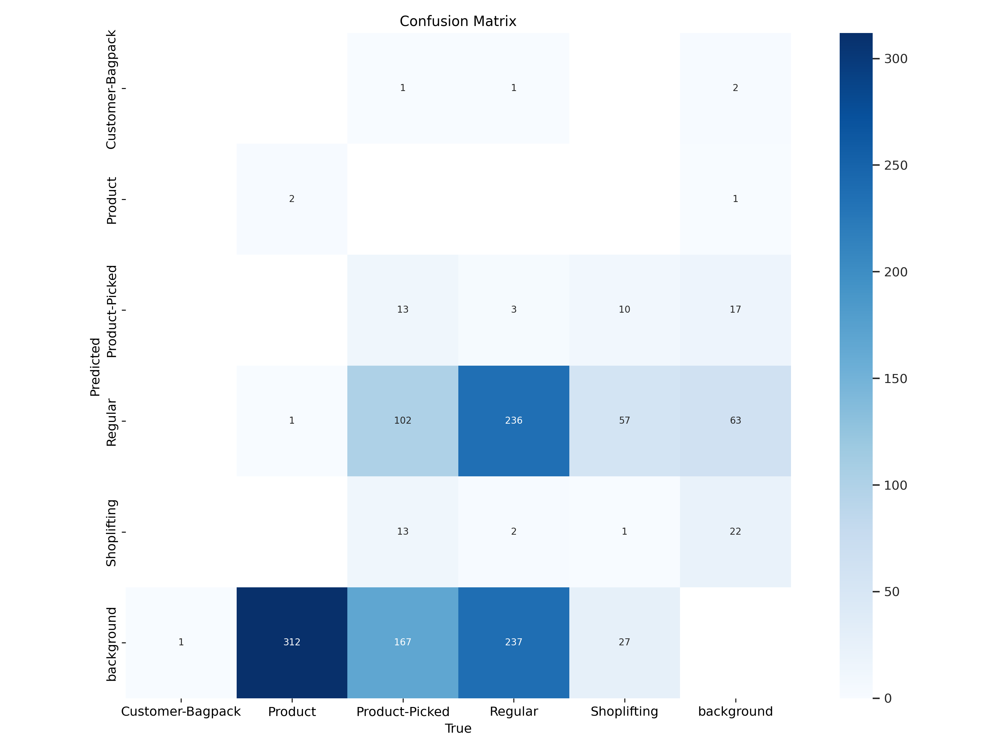

In [ ]:
from IPython.display import display, Image
Image(filename='/content/runs/detect/train2/confusion_matrix.png', width=600)

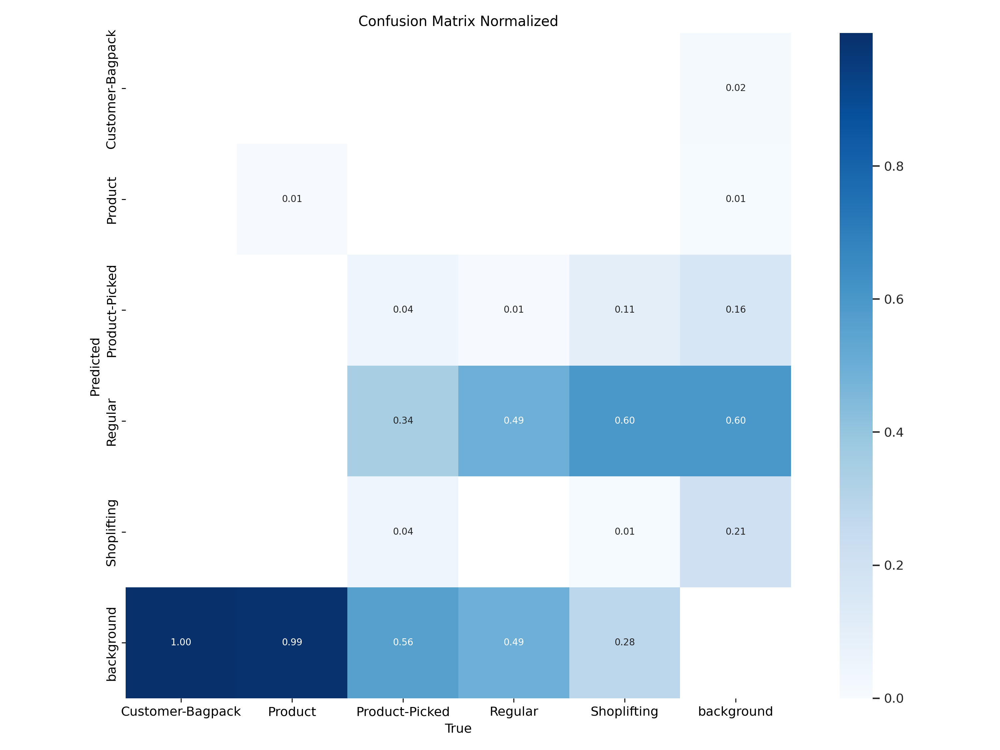

In [ ]:
Image(filename='/content/runs/detect/train2/confusion_matrix_normalized.png', width=600)

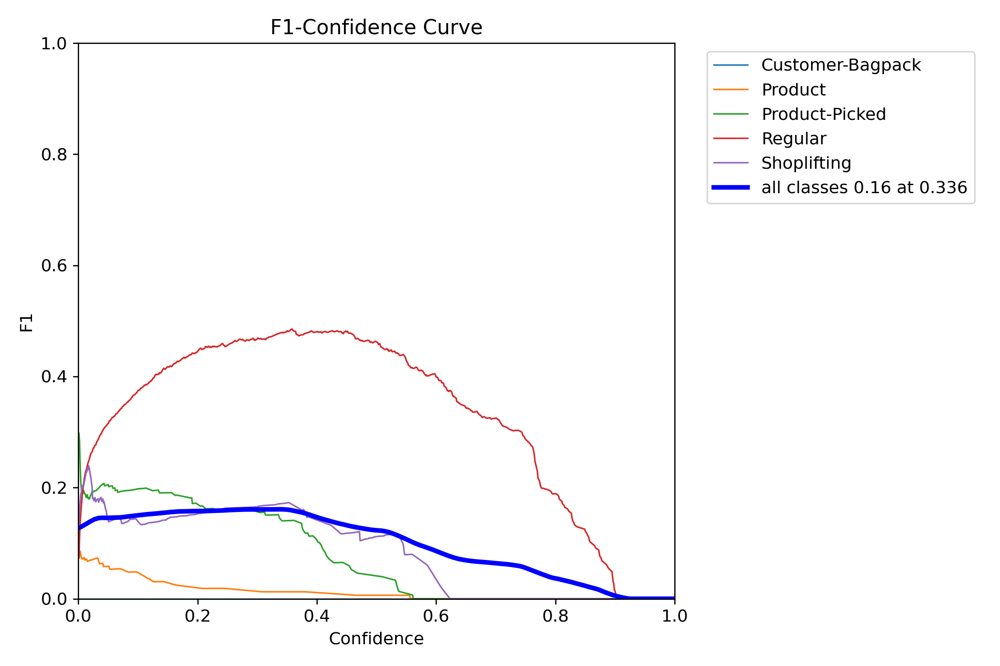

In [ ]:
Image(filename='/content/runs/detect/train2/F1_curve.png', width=600)

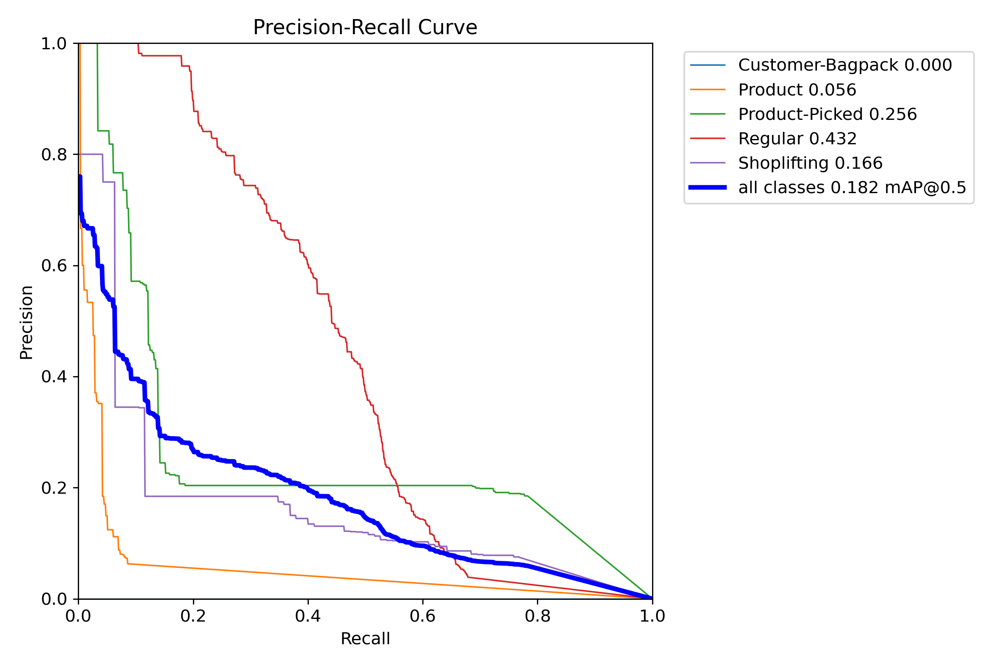

In [ ]:
Image(filename='/content/runs/detect/train2/PR_curve.png', width=600)

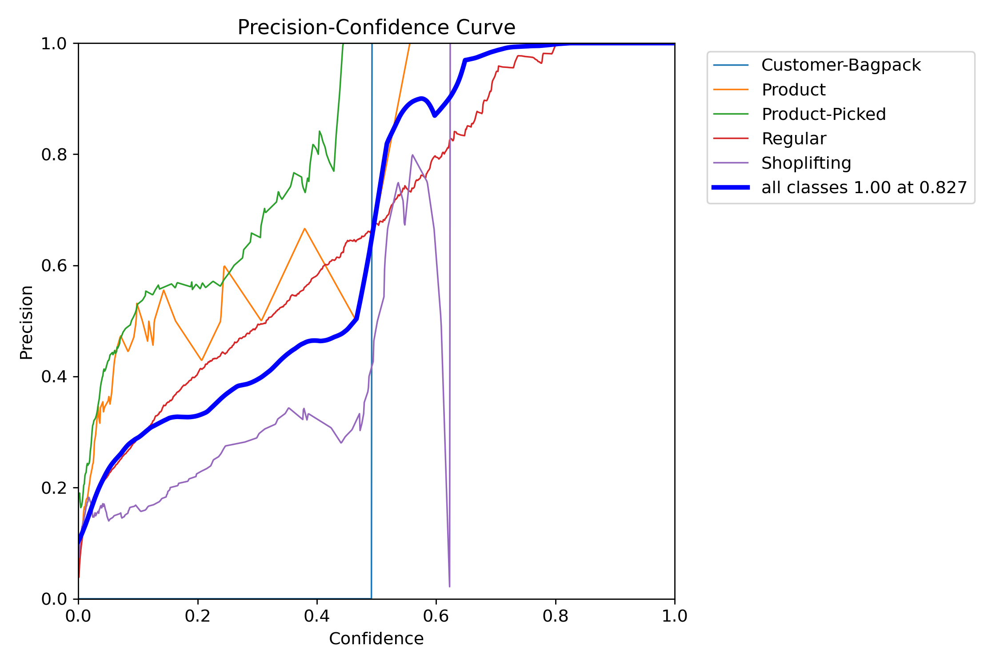

In [ ]:
Image(filename='/content/runs/detect/train2/P_curve.png', width=600)

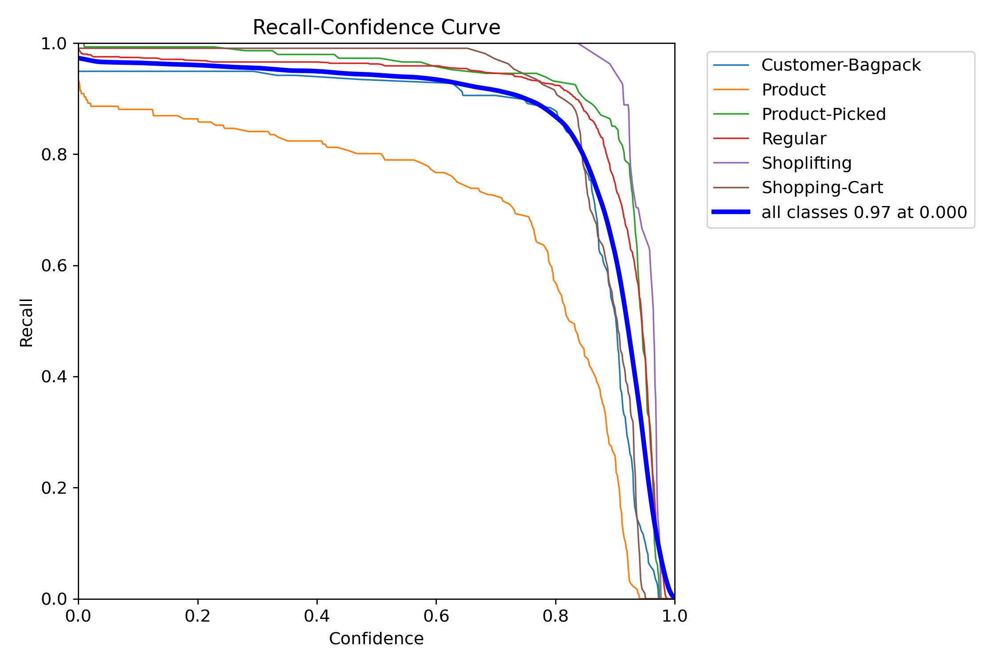

In [ ]:
Image(filename='/content/runs/detect/train82/R_curve.png', width=600)

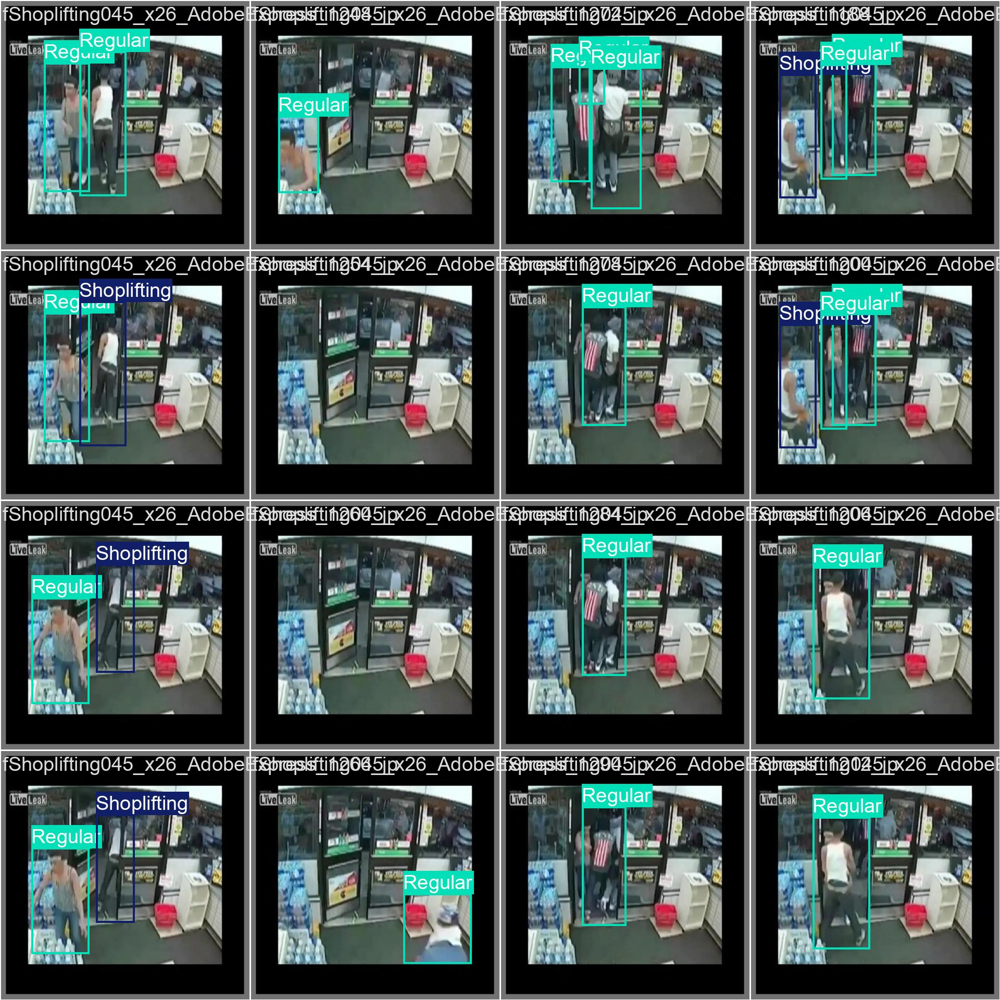

In [ ]:
Image(filename='/content/runs/detect/train2/val_batch2_labels.jpg', width=600)

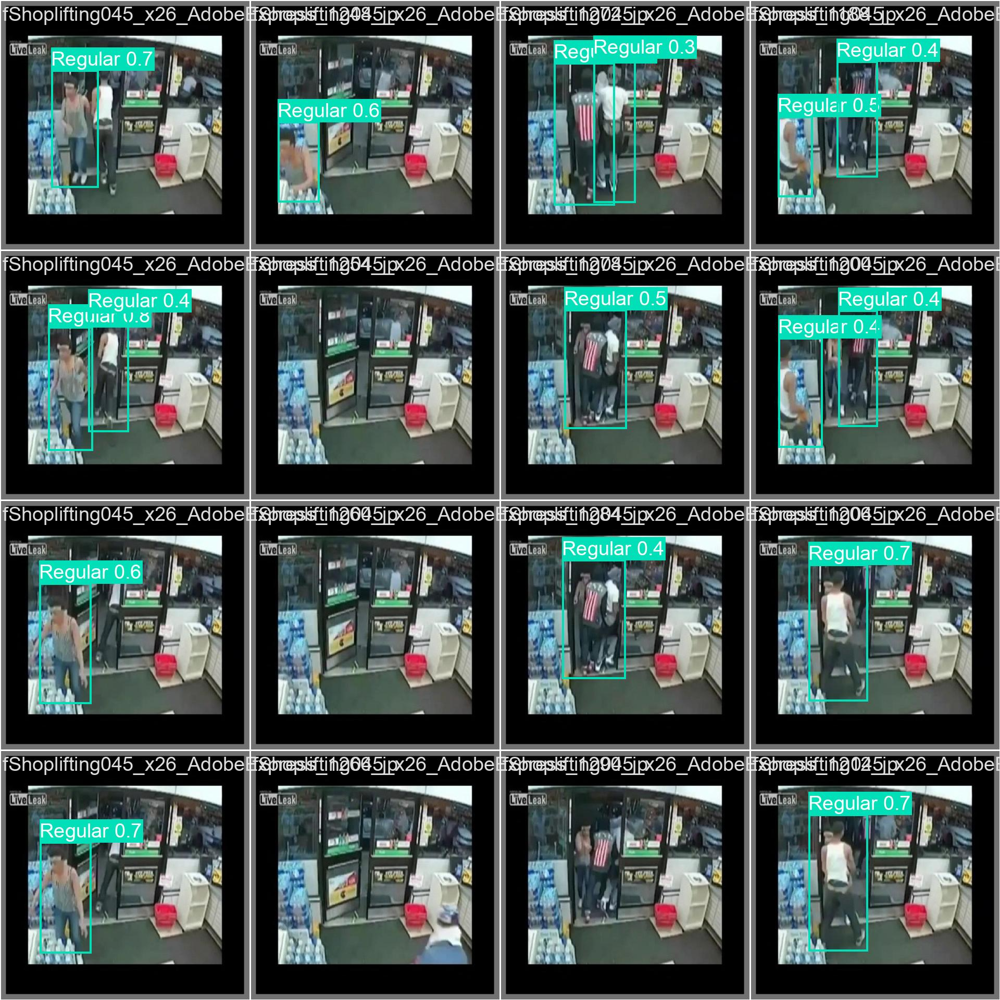

In [ ]:
Image(filename='/content/runs/detect/train2/val_batch2_pred.jpg', width=600)

# Train Yolov8n on 1st version of Dataset

In [ ]:
from ultralytics import YOLO

# Load a model
model = YOLO('yolov8n.pt')  # load a pretrained model
# Use the model
results = model.train(data='/content/CC-TV-Footage-Annotation-B10-4/data.yaml', epochs=50)  # train the model
results = model.val()  # evaluate model performance on the validation set

Ultralytics YOLOv8.2.77 🚀 Python-3.10.12 torch-2.3.1+cu121 CUDA:0 (NVIDIA L4, 22700MiB)
engine/trainer: task=detect, mode=train, model=yolov8n.pt, data=/content/CC-TV-Footage-Annotation-B10-4/data.yaml, epochs=50, time=None, patience=100, batch=16, imgsz=640, save=True, save_period=-1, cache=False, device=None, workers=8, project=None, name=train3, exist_ok=False, pretrained=True, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, multi_scale=False, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, vid_stride=1, stream_buffer=False, visualize=False, augment=False, agnostic_nms=False, classes=None, retina_masks=False, embed=None, show=False, save_frames=False, save_txt=False, save_conf=False, save_crop=False, show_labels=Tr

train: Scanning /content/CC-TV-Footage-Annotation-B10-4/train/labels.cache... 2231 images, 0 backgrounds, 0 corrupt: 100%|██████████| 2231/2231 [00:00<?, ?it/s]

albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01), CLAHE(p=0.01, clip_limit=(1, 4.0), tile_grid_size=(8, 8))



os.fork() was called. os.fork() is incompatible with multithreaded code, and JAX is multithreaded, so this will likely lead to a deadlock.
val: Scanning /content/CC-TV-Footage-Annotation-B10-4/valid/labels.cache... 471 images, 2 backgrounds, 0 corrupt: 100%|██████████| 471/471 [00:00<?, ?it/s]


Plotting labels to runs/detect/train3/labels.jpg... 
optimizer: 'optimizer=auto' found, ignoring 'lr0=0.01' and 'momentum=0.937' and determining best 'optimizer', 'lr0' and 'momentum' automatically... 
optimizer: AdamW(lr=0.001111, momentum=0.9) with parameter groups 57 weight(decay=0.0), 64 weight(decay=0.0005), 63 bias(decay=0.0)
TensorBoard: model graph visualization added ✅
Image sizes 640 train, 640 val
Using 8 dataloader workers
Logging results to runs/detect/train3
Starting training for 50 epochs...

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       1/50      2.17G      1.846      2.668      1.796         59        640: 100%|██████████| 140/140 [00:17<00:00,  7.84it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 15/15 [00:02<00:00,  5.80it/s]

                   all        471       1186      0.165      0.132      0.108     0.0399



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       2/50       2.1G      1.618      2.002      1.589         33        640: 100%|██████████| 140/140 [00:14<00:00,  9.74it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 15/15 [00:02<00:00,  6.48it/s]


                   all        471       1186      0.259      0.112     0.0623      0.026

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       3/50      2.11G      1.602      1.816      1.549         34        640: 100%|██████████| 140/140 [00:13<00:00, 10.22it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 15/15 [00:02<00:00,  6.94it/s]

                   all        471       1186      0.253      0.123      0.139     0.0643



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       4/50      2.11G      1.533       1.66      1.515         34        640: 100%|██████████| 140/140 [00:13<00:00, 10.15it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 15/15 [00:02<00:00,  7.12it/s]

                   all        471       1186      0.691     0.0668      0.077     0.0346



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       5/50      2.11G      1.479      1.504      1.466         29        640: 100%|██████████| 140/140 [00:13<00:00, 10.01it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 15/15 [00:02<00:00,  7.21it/s]

                   all        471       1186      0.227      0.108      0.117     0.0606



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       6/50      2.24G      1.419      1.416      1.428         35        640: 100%|██████████| 140/140 [00:13<00:00, 10.00it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 15/15 [00:02<00:00,  7.05it/s]

                   all        471       1186      0.172      0.266      0.166     0.0708



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       7/50       2.1G      1.384       1.35      1.408         26        640: 100%|██████████| 140/140 [00:14<00:00,  9.98it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 15/15 [00:02<00:00,  7.26it/s]

                   all        471       1186      0.199      0.154      0.151     0.0663



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       8/50       2.1G      1.335      1.275      1.378         43        640: 100%|██████████| 140/140 [00:14<00:00,  9.97it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 15/15 [00:02<00:00,  7.26it/s]

                   all        471       1186      0.715      0.121       0.14      0.067



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       9/50       2.1G      1.318      1.258      1.366         30        640: 100%|██████████| 140/140 [00:14<00:00,  9.99it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 15/15 [00:02<00:00,  7.10it/s]

                   all        471       1186      0.223      0.143      0.147     0.0716



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      10/50       2.1G      1.287      1.191      1.343         27        640: 100%|██████████| 140/140 [00:13<00:00, 10.22it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 15/15 [00:02<00:00,  7.25it/s]

                   all        471       1186      0.342      0.129      0.138     0.0639



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      11/50       2.1G      1.265      1.161      1.328         36        640: 100%|██████████| 140/140 [00:13<00:00, 10.28it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 15/15 [00:02<00:00,  7.17it/s]

                   all        471       1186      0.141      0.237      0.135     0.0544



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      12/50       2.1G       1.24      1.117      1.313         29        640: 100%|██████████| 140/140 [00:13<00:00, 10.24it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 15/15 [00:02<00:00,  7.20it/s]

                   all        471       1186      0.696      0.113      0.138     0.0628



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      13/50       2.1G      1.216      1.107      1.301         31        640: 100%|██████████| 140/140 [00:13<00:00, 10.10it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 15/15 [00:02<00:00,  7.38it/s]

                   all        471       1186      0.267       0.15      0.159     0.0751



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      14/50      2.11G      1.195      1.067      1.284         26        640: 100%|██████████| 140/140 [00:13<00:00, 10.21it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 15/15 [00:02<00:00,  7.37it/s]

                   all        471       1186      0.446      0.116      0.126     0.0554



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      15/50      2.21G      1.169      1.039      1.266         31        640: 100%|██████████| 140/140 [00:13<00:00, 10.13it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 15/15 [00:02<00:00,  7.18it/s]

                   all        471       1186      0.135       0.19       0.14     0.0674



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      16/50      2.21G      1.157      1.035      1.264         39        640: 100%|██████████| 140/140 [00:13<00:00, 10.10it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 15/15 [00:02<00:00,  7.04it/s]

                   all        471       1186      0.461      0.129      0.157     0.0746



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      17/50      2.11G      1.129     0.9907      1.246         33        640: 100%|██████████| 140/140 [00:13<00:00, 10.07it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 15/15 [00:02<00:00,  7.25it/s]

                   all        471       1186      0.217      0.142      0.165     0.0758



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      18/50      2.21G      1.134      0.978      1.246         32        640: 100%|██████████| 140/140 [00:14<00:00,  9.98it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 15/15 [00:02<00:00,  7.13it/s]

                   all        471       1186      0.151      0.203       0.17     0.0748



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      19/50      2.21G      1.093     0.9505       1.23         27        640: 100%|██████████| 140/140 [00:13<00:00, 10.13it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 15/15 [00:02<00:00,  7.21it/s]

                   all        471       1186      0.213      0.114      0.129     0.0629



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      20/50      2.21G      1.102     0.9555      1.239         27        640: 100%|██████████| 140/140 [00:13<00:00, 10.27it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 15/15 [00:02<00:00,  7.18it/s]

                   all        471       1186      0.382      0.177      0.139     0.0609



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      21/50       2.2G      1.071     0.9236      1.214         51        640: 100%|██████████| 140/140 [00:13<00:00, 10.15it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 15/15 [00:02<00:00,  7.34it/s]

                   all        471       1186      0.294      0.137      0.154     0.0738



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      22/50       2.2G      1.059     0.9008      1.204         38        640: 100%|██████████| 140/140 [00:13<00:00, 10.27it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 15/15 [00:02<00:00,  7.38it/s]

                   all        471       1186      0.235      0.191      0.213     0.0919



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      23/50       2.2G      1.043     0.8752        1.2         41        640: 100%|██████████| 140/140 [00:13<00:00, 10.07it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 15/15 [00:02<00:00,  7.33it/s]

                   all        471       1186      0.176      0.173      0.176     0.0766



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      24/50       2.2G      1.021     0.8686      1.187         31        640: 100%|██████████| 140/140 [00:14<00:00,  9.93it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 15/15 [00:02<00:00,  7.30it/s]

                   all        471       1186      0.258      0.131      0.153     0.0693



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      25/50      2.21G      1.019     0.8646      1.183         23        640: 100%|██████████| 140/140 [00:13<00:00, 10.03it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 15/15 [00:02<00:00,  7.37it/s]

                   all        471       1186      0.297       0.14      0.168     0.0764



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      26/50       2.2G      1.016     0.8479      1.182         32        640: 100%|██████████| 140/140 [00:13<00:00, 10.04it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 15/15 [00:02<00:00,  7.35it/s]

                   all        471       1186      0.332      0.135      0.171     0.0729



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      27/50      2.21G     0.9852     0.8316      1.168         32        640: 100%|██████████| 140/140 [00:13<00:00, 10.04it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 15/15 [00:02<00:00,  7.25it/s]

                   all        471       1186      0.437      0.158      0.179     0.0835



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      28/50       2.2G     0.9635     0.8105      1.156         33        640: 100%|██████████| 140/140 [00:13<00:00, 10.13it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 15/15 [00:02<00:00,  7.10it/s]

                   all        471       1186      0.524      0.121      0.143     0.0729



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      29/50       2.2G     0.9659     0.7972      1.153         35        640: 100%|██████████| 140/140 [00:13<00:00, 10.41it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 15/15 [00:02<00:00,  7.22it/s]

                   all        471       1186      0.536       0.12      0.136     0.0622



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      30/50       2.2G     0.9445     0.7899      1.149         44        640: 100%|██████████| 140/140 [00:13<00:00, 10.20it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 15/15 [00:02<00:00,  7.19it/s]

                   all        471       1186      0.513      0.136      0.149     0.0757



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      31/50       2.2G     0.9348     0.7771      1.141         40        640: 100%|██████████| 140/140 [00:13<00:00, 10.13it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 15/15 [00:02<00:00,  7.23it/s]

                   all        471       1186      0.463      0.145       0.17     0.0834



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      32/50       2.2G     0.9358     0.7674      1.144         35        640: 100%|██████████| 140/140 [00:13<00:00, 10.06it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 15/15 [00:02<00:00,  7.32it/s]

                   all        471       1186      0.476      0.125       0.15     0.0766



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      33/50      2.21G     0.9249     0.7523      1.139         36        640: 100%|██████████| 140/140 [00:13<00:00, 10.07it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 15/15 [00:02<00:00,  7.45it/s]

                   all        471       1186      0.458      0.135      0.143     0.0728



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      34/50       2.2G      0.907     0.7407      1.125         45        640: 100%|██████████| 140/140 [00:13<00:00, 10.06it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 15/15 [00:02<00:00,  7.37it/s]

                   all        471       1186      0.143      0.159       0.14     0.0619



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      35/50       2.2G     0.8877     0.7233      1.122         32        640: 100%|██████████| 140/140 [00:14<00:00,  9.91it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 15/15 [00:02<00:00,  7.41it/s]

                   all        471       1186      0.549      0.124      0.154     0.0698



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      36/50      2.21G      0.889     0.7283      1.117         34        640: 100%|██████████| 140/140 [00:13<00:00, 10.06it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 15/15 [00:02<00:00,  7.32it/s]

                   all        471       1186      0.229      0.136      0.154     0.0707



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      37/50       2.2G     0.8666     0.7041      1.104         26        640: 100%|██████████| 140/140 [00:13<00:00, 10.05it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 15/15 [00:02<00:00,  7.25it/s]

                   all        471       1186      0.221      0.144      0.143     0.0666



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      38/50      2.24G     0.8741     0.7074      1.102         44        640: 100%|██████████| 140/140 [00:13<00:00, 10.13it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 15/15 [00:02<00:00,  7.38it/s]

                   all        471       1186       0.18       0.15      0.145       0.07



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      39/50      2.24G     0.8563     0.6972      1.098         22        640: 100%|██████████| 140/140 [00:13<00:00, 10.26it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 15/15 [00:02<00:00,  7.27it/s]

                   all        471       1186      0.216      0.163      0.157     0.0709



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      40/50       2.1G      0.847     0.6851      1.095         32        640: 100%|██████████| 140/140 [00:13<00:00, 10.19it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 15/15 [00:02<00:00,  7.31it/s]

                   all        471       1186      0.568      0.113      0.135     0.0704


Closing dataloader mosaic
albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01), CLAHE(p=0.01, clip_limit=(1, 4.0), tile_grid_size=(8, 8))


os.fork() was called. os.fork() is incompatible with multithreaded code, and JAX is multithreaded, so this will likely lead to a deadlock.



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      41/50      2.11G     0.7708     0.5275      1.079         16        640: 100%|██████████| 140/140 [00:14<00:00,  9.38it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 15/15 [00:02<00:00,  7.19it/s]

                   all        471       1186      0.213      0.156      0.142     0.0704



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      42/50       2.1G     0.7448     0.5017      1.066         21        640: 100%|██████████| 140/140 [00:13<00:00, 10.43it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 15/15 [00:02<00:00,  7.28it/s]

                   all        471       1186      0.254      0.146      0.152     0.0745



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      43/50       2.1G     0.7254     0.4824      1.052         16        640: 100%|██████████| 140/140 [00:13<00:00, 10.38it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 15/15 [00:02<00:00,  7.20it/s]

                   all        471       1186      0.269      0.146      0.157     0.0781



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      44/50       2.1G     0.7122     0.4771      1.045         16        640: 100%|██████████| 140/140 [00:13<00:00, 10.29it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 15/15 [00:02<00:00,  7.34it/s]

                   all        471       1186      0.321      0.144      0.158     0.0807



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      45/50       2.1G     0.6974     0.4604       1.04         27        640: 100%|██████████| 140/140 [00:13<00:00, 10.28it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 15/15 [00:02<00:00,  7.41it/s]

                   all        471       1186      0.266      0.141      0.142     0.0724



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      46/50      2.11G     0.6821     0.4524      1.023         14        640: 100%|██████████| 140/140 [00:13<00:00, 10.31it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 15/15 [00:02<00:00,  7.46it/s]

                   all        471       1186      0.306      0.143      0.151     0.0768



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      47/50      2.11G     0.6768     0.4455      1.021         13        640: 100%|██████████| 140/140 [00:13<00:00, 10.50it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 15/15 [00:02<00:00,  7.26it/s]

                   all        471       1186      0.337       0.13      0.146     0.0734



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      48/50       2.1G     0.6529     0.4336      1.015         22        640: 100%|██████████| 140/140 [00:13<00:00, 10.64it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 15/15 [00:02<00:00,  7.38it/s]

                   all        471       1186      0.289      0.144       0.15     0.0775



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      49/50      2.11G     0.6525     0.4277      1.014         17        640: 100%|██████████| 140/140 [00:13<00:00, 10.52it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 15/15 [00:02<00:00,  7.33it/s]

                   all        471       1186      0.258      0.138      0.141      0.072



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      50/50      2.11G     0.6407     0.4139      1.008         12        640: 100%|██████████| 140/140 [00:13<00:00, 10.37it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 15/15 [00:02<00:00,  7.44it/s]

                   all        471       1186      0.278      0.147      0.145     0.0744



50 epochs completed in 0.259 hours.
Optimizer stripped from runs/detect/train3/weights/last.pt, 6.3MB
Optimizer stripped from runs/detect/train3/weights/best.pt, 6.2MB

Validating runs/detect/train3/weights/best.pt...
Ultralytics YOLOv8.2.77 🚀 Python-3.10.12 torch-2.3.1+cu121 CUDA:0 (NVIDIA L4, 22700MiB)
Model summary (fused): 168 layers, 3,006,623 parameters, 0 gradients, 8.1 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 15/15 [00:03<00:00,  3.88it/s]


                   all        471       1186      0.236       0.19      0.213     0.0921
      Customer-Bagpack          1          1          0          0          0          0
               Product        259        315     0.0368    0.00952    0.00575    0.00119
        Product-Picked        244        296      0.681      0.282      0.482       0.15
               Regular        362        479      0.336      0.522      0.473      0.252
           Shoplifting         92         95      0.125      0.137      0.105     0.0572
Speed: 0.2ms preprocess, 0.9ms inference, 0.0ms loss, 3.1ms postprocess per image
Results saved to runs/detect/train3
Ultralytics YOLOv8.2.77 🚀 Python-3.10.12 torch-2.3.1+cu121 CUDA:0 (NVIDIA L4, 22700MiB)
Model summary (fused): 168 layers, 3,006,623 parameters, 0 gradients, 8.1 GFLOPs


val: Scanning /content/CC-TV-Footage-Annotation-B10-4/valid/labels.cache... 471 images, 2 backgrounds, 0 corrupt: 100%|██████████| 471/471 [00:00<?, ?it/s]
os.fork() was called. os.fork() is incompatible with multithreaded code, and JAX is multithreaded, so this will likely lead to a deadlock.
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 30/30 [00:04<00:00,  6.73it/s]


                   all        471       1186      0.236       0.19      0.212     0.0921
      Customer-Bagpack          1          1          0          0          0          0
               Product        259        315      0.037    0.00952    0.00554    0.00116
        Product-Picked        244        296      0.682      0.283      0.478       0.15
               Regular        362        479      0.336      0.522      0.473      0.253
           Shoplifting         92         95      0.125      0.137      0.105     0.0567
Speed: 0.2ms preprocess, 2.1ms inference, 0.0ms loss, 3.9ms postprocess per image
Results saved to runs/detect/train32


# Evaluation Metrics of YOLOv8n model for 1st version Dataset

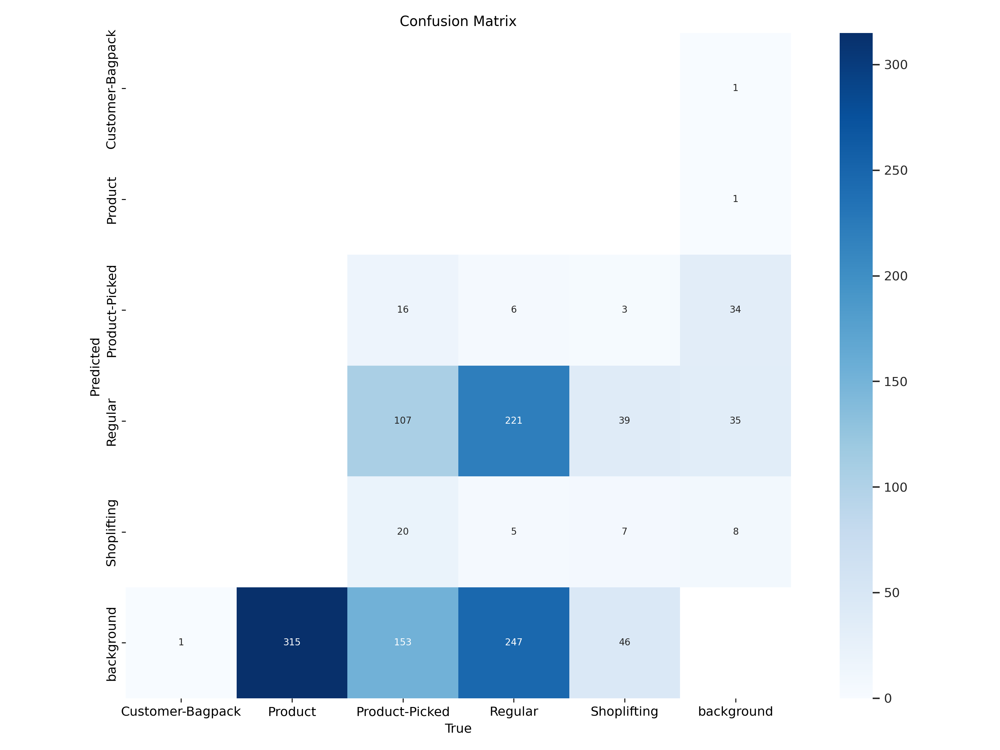

In [ ]:
Image(filename='/content/runs/detect/train32/confusion_matrix.png', width=600)

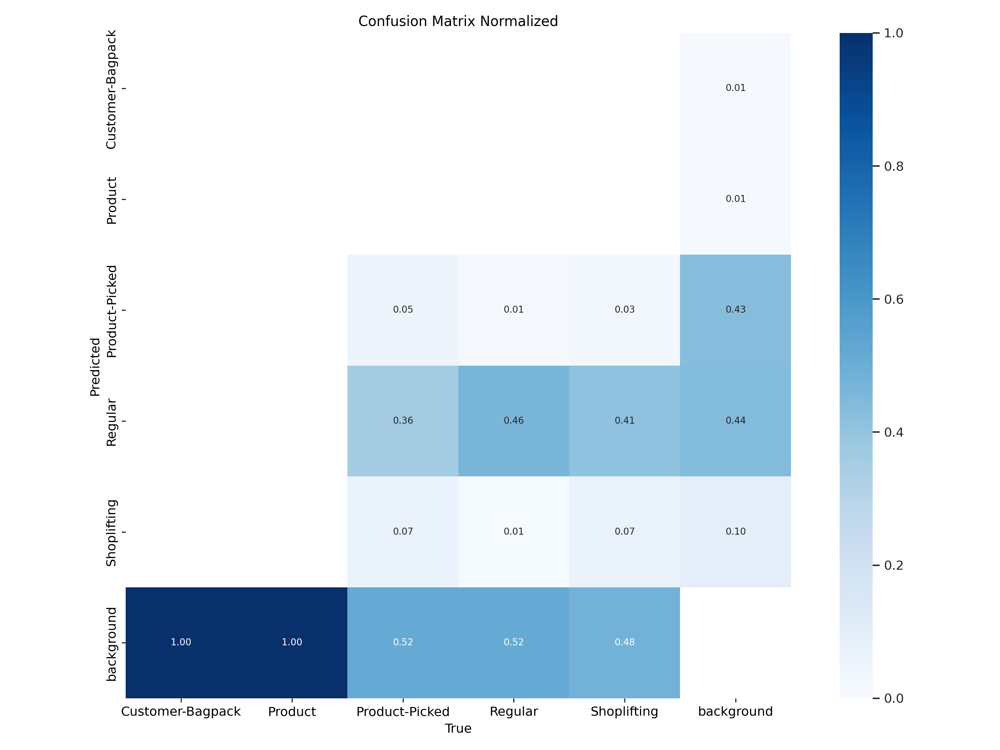

In [ ]:
Image(filename='/content/runs/detect/train32/confusion_matrix_normalized.png', width=600)

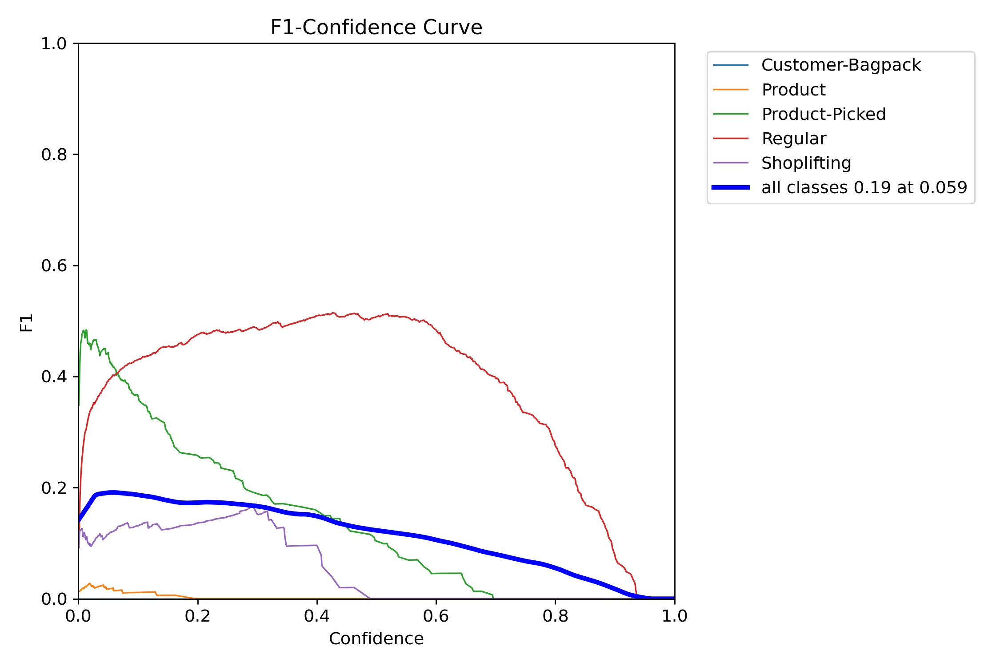

In [ ]:
Image(filename='/content/runs/detect/train32/F1_curve.png', width=600)

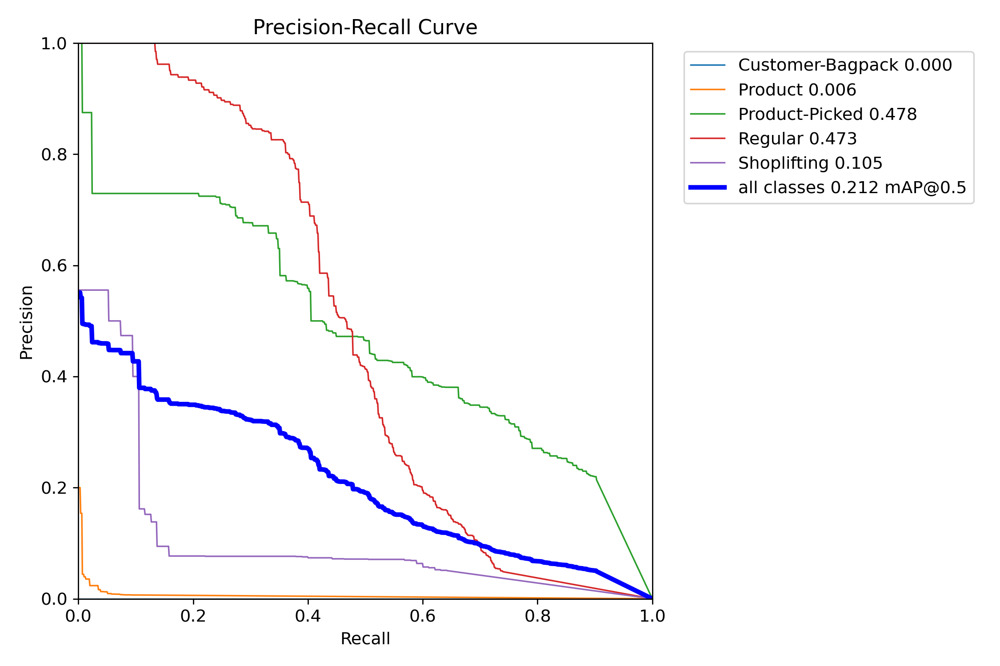

In [ ]:
Image(filename='/content/runs/detect/train32/PR_curve.png', width=600)

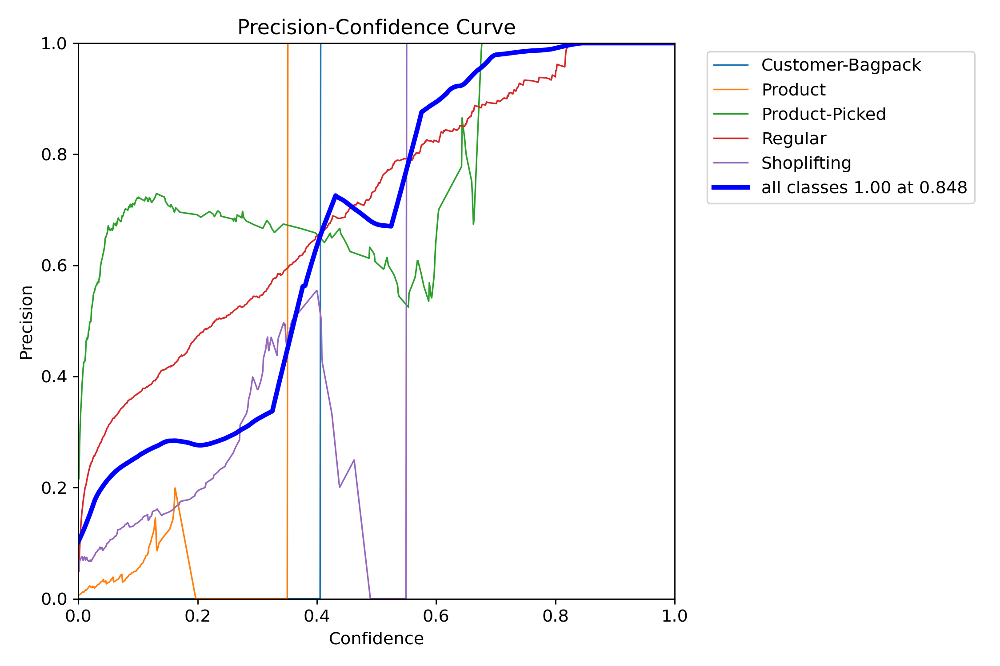

In [ ]:
Image(filename='/content/runs/detect/train32/P_curve.png', width=600)

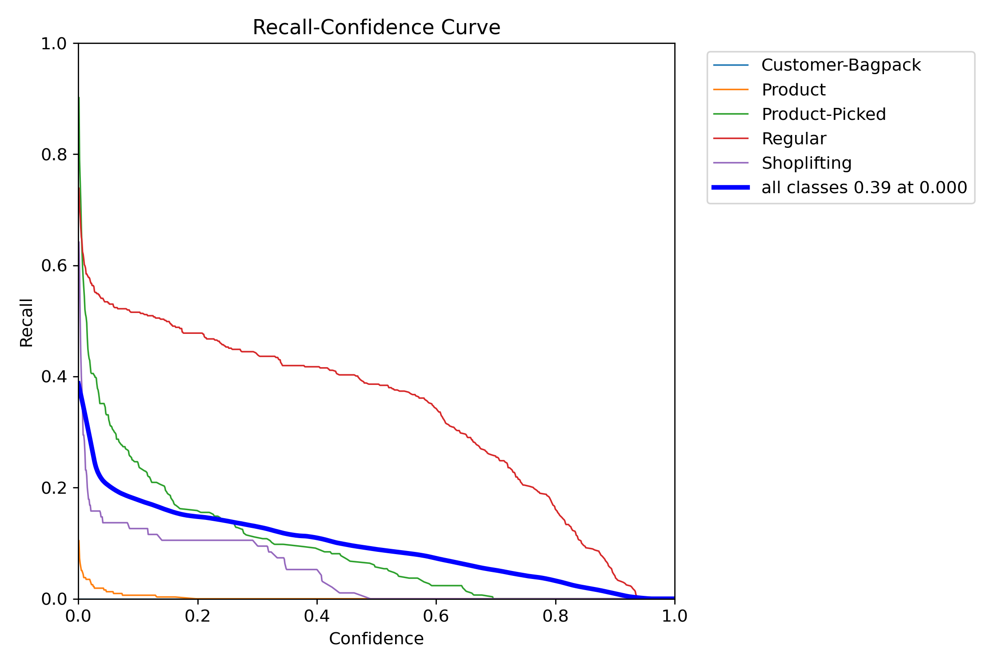

In [ ]:
Image(filename='/content/runs/detect/train32/R_curve.png', width=600)

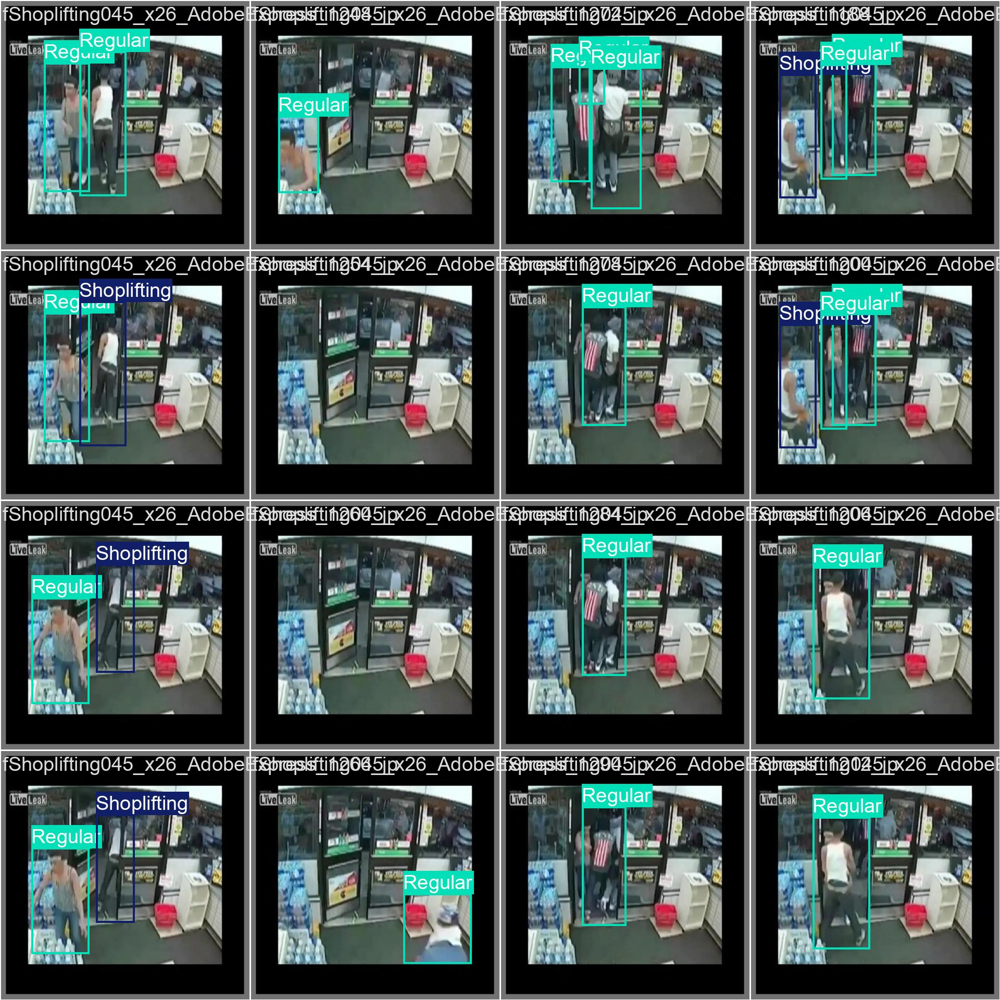

In [ ]:
Image(filename='/content/runs/detect/train32/val_batch2_labels.jpg', width=600)

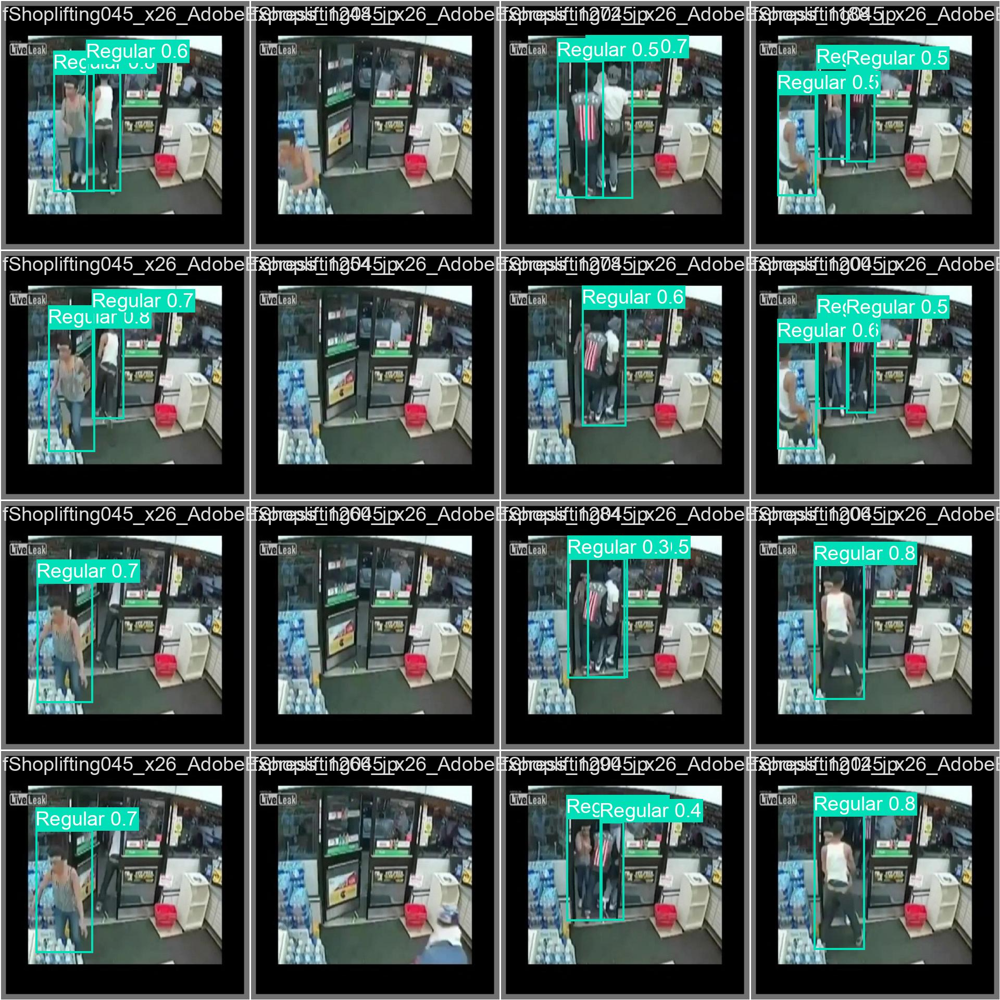

In [ ]:
Image(filename='/content/runs/detect/train32/val_batch2_pred.jpg', width=600)

# Prediction for YOLOv8m

In [ ]:
import locale
def getpreferredencoding(do_setlocale = True):
    return "UTF-8"
locale.getpreferredencoding = getpreferredencoding
!yolo predict model=/content/runs/detect/train/weights/best.pt source=/content/shoplifting_test.png

Ultralytics YOLOv8.2.77 🚀 Python-3.10.12 torch-2.3.1+cu121 CUDA:0 (NVIDIA L4, 22700MiB)
Model summary (fused): 218 layers, 25,842,655 parameters, 0 gradients, 78.7 GFLOPs

image 1/1 /content/shoplifting_test.png: 352x640 1 Regular, 151.6ms
Speed: 3.8ms preprocess, 151.6ms inference, 559.2ms postprocess per image at shape (1, 3, 352, 640)
Results saved to runs/detect/predict
💡 Learn more at https://docs.ultralytics.com/modes/predict


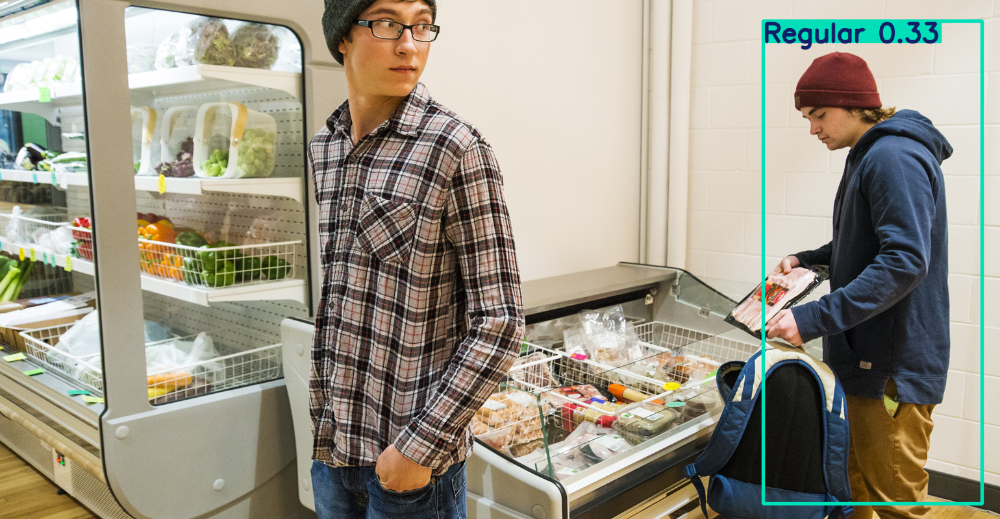

In [ ]:
Image(filename='/content/runs/detect/predict/shoplifting_test.png', width=600)

# Prediction for YOLOv8n

In [ ]:
!yolo predict model=/content/runs/detect/train3/weights/best.pt source=/content/shoplifting_test.png

Ultralytics YOLOv8.2.77 🚀 Python-3.10.12 torch-2.3.1+cu121 CUDA:0 (NVIDIA L4, 22700MiB)
Model summary (fused): 168 layers, 3,006,623 parameters, 0 gradients, 8.1 GFLOPs

image 1/1 /content/shoplifting_test.png: 352x640 1 Regular, 140.8ms
Speed: 5.7ms preprocess, 140.8ms inference, 609.0ms postprocess per image at shape (1, 3, 352, 640)
Results saved to runs/detect/predict2
💡 Learn more at https://docs.ultralytics.com/modes/predict


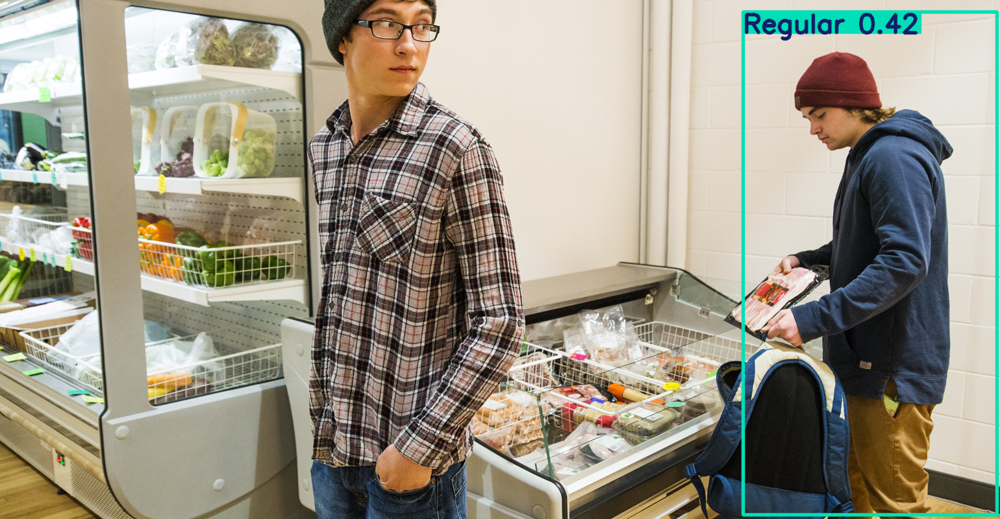

In [ ]:
Image(filename='/content/runs/detect/predict2/shoplifting_test.png', width=600)

# 2nd Dataset from Roboflow

In [ ]:
!pip install roboflow

from roboflow import Roboflow
rf = Roboflow(api_key="IJqopp3PgIEHEhg8XFkZ")
project = rf.workspace("cc-tv-footage-annotation").project("cc-tv-footage-annotation-b8")
version = project.version(1)
dataset = version.download("yolov8-obb")

loading Roboflow workspace...
loading Roboflow project...



Extracting Dataset Version Zip to CC-TV-Footage-Annotation-B8-1 in yolov8-obb:: 100%|██████████| 6005/6005 [00:01<00:00, 5906.04it/s]


# Train YOLOv8n on 2nd version Dataset

In [ ]:
from ultralytics import YOLO

# Load a model
model = YOLO('yolov8n.pt')  # load a pretrained model
# Use the model
results = model.train(data='/content/CC-TV-Footage-Annotation-B8-1/data.yaml', epochs=50)  # train the model
results = model.val()  # evaluate model performance on the validation set

Ultralytics YOLOv8.2.77 🚀 Python-3.10.12 torch-2.3.1+cu121 CUDA:0 (NVIDIA L4, 22700MiB)
engine/trainer: task=detect, mode=train, model=yolov8n.pt, data=/content/CC-TV-Footage-Annotation-B8-1/data.yaml, epochs=50, time=None, patience=100, batch=16, imgsz=640, save=True, save_period=-1, cache=False, device=None, workers=8, project=None, name=train4, exist_ok=False, pretrained=True, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, multi_scale=False, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, vid_stride=1, stream_buffer=False, visualize=False, augment=False, agnostic_nms=False, classes=None, retina_masks=False, embed=None, show=False, save_frames=False, save_txt=False, save_conf=False, save_crop=False, show_labels=Tru

train: Scanning /content/CC-TV-Footage-Annotation-B8-1/train/labels... 2398 images, 1 backgrounds, 0 corrupt: 100%|██████████| 2398/2398 [00:02<00:00, 1060.77it/s]


train: New cache created: /content/CC-TV-Footage-Annotation-B8-1/train/labels.cache
albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01), CLAHE(p=0.01, clip_limit=(1, 4.0), tile_grid_size=(8, 8))


os.fork() was called. os.fork() is incompatible with multithreaded code, and JAX is multithreaded, so this will likely lead to a deadlock.
val: Scanning /content/CC-TV-Footage-Annotation-B8-1/valid/labels... 600 images, 0 backgrounds, 0 corrupt: 100%|██████████| 600/600 [00:00<00:00, 837.49it/s]


val: New cache created: /content/CC-TV-Footage-Annotation-B8-1/valid/labels.cache
Plotting labels to runs/detect/train4/labels.jpg... 
optimizer: 'optimizer=auto' found, ignoring 'lr0=0.01' and 'momentum=0.937' and determining best 'optimizer', 'lr0' and 'momentum' automatically... 
optimizer: AdamW(lr=0.001, momentum=0.9) with parameter groups 57 weight(decay=0.0), 64 weight(decay=0.0005), 63 bias(decay=0.0)
TensorBoard: model graph visualization added ✅
Image sizes 640 train, 640 val
Using 8 dataloader workers
Logging results to runs/detect/train4
Starting training for 50 epochs...

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       1/50       2.6G      1.684      2.691      1.729         81        640: 100%|██████████| 150/150 [00:18<00:00,  8.19it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 19/19 [00:03<00:00,  5.80it/s]

                   all        600       2074      0.467      0.265      0.329      0.174



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       2/50      2.55G       1.51      1.821      1.542         80        640: 100%|██████████| 150/150 [00:15<00:00,  9.44it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 19/19 [00:02<00:00,  6.40it/s]


                   all        600       2074      0.471       0.44      0.446      0.227

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       3/50      2.43G      1.451      1.628      1.495         83        640: 100%|██████████| 150/150 [00:15<00:00,  9.82it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 19/19 [00:02<00:00,  6.72it/s]


                   all        600       2074      0.702      0.497      0.507      0.301

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       4/50      2.43G        1.4      1.477      1.453         85        640: 100%|██████████| 150/150 [00:15<00:00,  9.98it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 19/19 [00:02<00:00,  6.81it/s]

                   all        600       2074      0.496      0.553      0.539      0.307



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       5/50      2.43G      1.336      1.363        1.4         96        640: 100%|██████████| 150/150 [00:15<00:00,  9.89it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 19/19 [00:02<00:00,  6.83it/s]

                   all        600       2074      0.641      0.538      0.547      0.318



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       6/50      2.43G      1.322      1.279      1.389         77        640: 100%|██████████| 150/150 [00:15<00:00,  9.80it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 19/19 [00:02<00:00,  6.87it/s]

                   all        600       2074      0.612      0.523      0.564      0.331



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       7/50      2.43G       1.27      1.233      1.355         79        640: 100%|██████████| 150/150 [00:15<00:00,  9.93it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 19/19 [00:02<00:00,  6.82it/s]

                   all        600       2074      0.579      0.631      0.629      0.375



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       8/50      2.43G      1.231      1.167      1.332        107        640: 100%|██████████| 150/150 [00:15<00:00,  9.88it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 19/19 [00:02<00:00,  6.74it/s]

                   all        600       2074      0.675      0.622      0.662      0.412



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       9/50      2.43G      1.199      1.127      1.309         83        640: 100%|██████████| 150/150 [00:15<00:00,  9.98it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 19/19 [00:02<00:00,  6.75it/s]

                   all        600       2074      0.645      0.635      0.668      0.422



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      10/50      2.43G      1.182      1.094      1.301        114        640: 100%|██████████| 150/150 [00:15<00:00,  9.86it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 19/19 [00:02<00:00,  6.88it/s]

                   all        600       2074      0.667      0.674      0.706      0.453



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      11/50      2.43G      1.153      1.063      1.286         87        640: 100%|██████████| 150/150 [00:15<00:00,  9.93it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 19/19 [00:02<00:00,  6.83it/s]

                   all        600       2074      0.679      0.671        0.7      0.458



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      12/50      2.43G      1.138       1.03      1.273         91        640: 100%|██████████| 150/150 [00:15<00:00,  9.92it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 19/19 [00:02<00:00,  6.73it/s]

                   all        600       2074      0.698      0.676      0.712      0.464



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      13/50      2.43G      1.114     0.9973      1.261         71        640: 100%|██████████| 150/150 [00:15<00:00,  9.92it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 19/19 [00:02<00:00,  6.85it/s]

                   all        600       2074      0.721      0.678      0.733      0.475



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      14/50      2.43G      1.096     0.9693      1.249         97        640: 100%|██████████| 150/150 [00:15<00:00,  9.88it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 19/19 [00:02<00:00,  6.79it/s]

                   all        600       2074      0.693      0.677       0.71       0.46



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      15/50      2.43G      1.069     0.9472      1.226         73        640: 100%|██████████| 150/150 [00:15<00:00,  9.90it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 19/19 [00:02<00:00,  6.64it/s]

                   all        600       2074      0.703      0.672      0.732      0.486



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      16/50      2.43G      1.077     0.9506      1.237         79        640: 100%|██████████| 150/150 [00:15<00:00,  9.89it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 19/19 [00:02<00:00,  6.79it/s]

                   all        600       2074      0.752      0.679      0.752      0.499



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      17/50      2.43G      1.048     0.9105       1.22         89        640: 100%|██████████| 150/150 [00:15<00:00,  9.80it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 19/19 [00:02<00:00,  6.89it/s]

                   all        600       2074      0.768      0.703      0.766      0.512



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      18/50      2.43G      1.024     0.9083      1.208         76        640: 100%|██████████| 150/150 [00:15<00:00,  9.86it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 19/19 [00:02<00:00,  6.65it/s]

                   all        600       2074      0.766      0.723      0.773       0.53



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      19/50      2.43G      1.014     0.8903      1.201         74        640: 100%|██████████| 150/150 [00:15<00:00,  9.89it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 19/19 [00:02<00:00,  6.81it/s]

                   all        600       2074      0.768      0.684      0.764      0.525



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      20/50      2.43G      1.008     0.8759       1.19         79        640: 100%|██████████| 150/150 [00:15<00:00,  9.90it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 19/19 [00:02<00:00,  6.88it/s]

                   all        600       2074      0.739      0.748      0.793      0.539



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      21/50      2.43G     0.9827     0.8513      1.184         72        640: 100%|██████████| 150/150 [00:14<00:00, 10.02it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 19/19 [00:02<00:00,  6.83it/s]

                   all        600       2074      0.748      0.742      0.793      0.549



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      22/50      2.43G     0.9743     0.8365      1.179         89        640: 100%|██████████| 150/150 [00:15<00:00,  9.96it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 19/19 [00:02<00:00,  6.84it/s]

                   all        600       2074      0.783      0.732      0.803      0.544



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      23/50      2.43G     0.9752     0.8371      1.177         93        640: 100%|██████████| 150/150 [00:15<00:00,  9.96it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 19/19 [00:02<00:00,  6.70it/s]

                   all        600       2074      0.798      0.744      0.809      0.557



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      24/50      2.43G     0.9671      0.823      1.171         94        640: 100%|██████████| 150/150 [00:14<00:00, 10.05it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 19/19 [00:02<00:00,  6.88it/s]

                   all        600       2074      0.804      0.751      0.819      0.576



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      25/50      2.43G     0.9448     0.8052      1.158         85        640: 100%|██████████| 150/150 [00:14<00:00, 10.02it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 19/19 [00:02<00:00,  6.79it/s]

                   all        600       2074      0.807      0.756       0.82      0.583



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      26/50      2.43G     0.9211     0.7796      1.143         81        640: 100%|██████████| 150/150 [00:15<00:00, 10.00it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 19/19 [00:02<00:00,  6.86it/s]

                   all        600       2074      0.806      0.756      0.829      0.595



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      27/50      2.56G     0.9242     0.7877      1.148         90        640: 100%|██████████| 150/150 [00:14<00:00, 10.03it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 19/19 [00:02<00:00,  6.62it/s]

                   all        600       2074        0.8      0.792      0.831      0.595



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      28/50      2.43G     0.9061     0.7722       1.14         93        640: 100%|██████████| 150/150 [00:15<00:00,  9.95it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 19/19 [00:02<00:00,  6.66it/s]

                   all        600       2074       0.79      0.756      0.817      0.581



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      29/50      2.56G     0.8914     0.7479      1.131         75        640: 100%|██████████| 150/150 [00:15<00:00, 10.00it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 19/19 [00:02<00:00,  6.79it/s]

                   all        600       2074      0.806      0.783      0.843        0.6



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      30/50      2.43G     0.8942     0.7461       1.13         92        640: 100%|██████████| 150/150 [00:15<00:00,  9.94it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 19/19 [00:02<00:00,  6.83it/s]

                   all        600       2074      0.816       0.79      0.845      0.608



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      31/50      2.44G      0.882     0.7394      1.124         82        640: 100%|██████████| 150/150 [00:14<00:00, 10.09it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 19/19 [00:02<00:00,  6.80it/s]

                   all        600       2074      0.824      0.759      0.842       0.61



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      32/50      2.43G     0.8811     0.7353      1.127         70        640: 100%|██████████| 150/150 [00:14<00:00, 10.02it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 19/19 [00:02<00:00,  6.79it/s]

                   all        600       2074      0.787      0.812      0.842      0.614



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      33/50      2.43G     0.8716     0.7248      1.124         71        640: 100%|██████████| 150/150 [00:14<00:00, 10.03it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 19/19 [00:02<00:00,  6.75it/s]

                   all        600       2074      0.787      0.825      0.851      0.624



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      34/50      2.43G     0.8596     0.7167      1.112         94        640: 100%|██████████| 150/150 [00:14<00:00, 10.03it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 19/19 [00:02<00:00,  6.82it/s]

                   all        600       2074       0.83        0.8       0.86       0.63



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      35/50      2.43G     0.8518      0.708       1.11         91        640: 100%|██████████| 150/150 [00:14<00:00, 10.00it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 19/19 [00:02<00:00,  6.80it/s]

                   all        600       2074      0.821      0.805      0.857      0.638



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      36/50      2.43G     0.8443     0.6894      1.107         84        640: 100%|██████████| 150/150 [00:14<00:00, 10.05it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 19/19 [00:02<00:00,  6.84it/s]

                   all        600       2074       0.82      0.811      0.859      0.638



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      37/50      2.43G     0.8276     0.6867      1.098         81        640: 100%|██████████| 150/150 [00:14<00:00, 10.09it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 19/19 [00:02<00:00,  6.78it/s]

                   all        600       2074      0.793      0.836      0.858      0.635



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      38/50      2.43G     0.8146     0.6658      1.092         86        640: 100%|██████████| 150/150 [00:15<00:00,  9.89it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 19/19 [00:02<00:00,  6.85it/s]

                   all        600       2074      0.842        0.8      0.866      0.645



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      39/50      2.43G     0.8101     0.6713      1.091        119        640: 100%|██████████| 150/150 [00:14<00:00, 10.08it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 19/19 [00:02<00:00,  6.75it/s]

                   all        600       2074      0.856      0.823      0.877       0.65



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      40/50      2.43G     0.7957     0.6487      1.082         86        640: 100%|██████████| 150/150 [00:15<00:00,  9.84it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 19/19 [00:02<00:00,  6.83it/s]

                   all        600       2074      0.842      0.831      0.873      0.643


Closing dataloader mosaic
albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01), CLAHE(p=0.01, clip_limit=(1, 4.0), tile_grid_size=(8, 8))


os.fork() was called. os.fork() is incompatible with multithreaded code, and JAX is multithreaded, so this will likely lead to a deadlock.



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      41/50      2.43G     0.7592     0.5422      1.086         45        640: 100%|██████████| 150/150 [00:16<00:00,  9.29it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 19/19 [00:02<00:00,  6.66it/s]

                   all        600       2074      0.818      0.837      0.869      0.658



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      42/50      2.43G       0.72     0.5141       1.07         51        640: 100%|██████████| 150/150 [00:14<00:00, 10.28it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 19/19 [00:02<00:00,  6.70it/s]

                   all        600       2074      0.843      0.835      0.873      0.657



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      43/50      2.43G     0.7137     0.5082      1.065         32        640: 100%|██████████| 150/150 [00:14<00:00, 10.44it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 19/19 [00:02<00:00,  6.57it/s]

                   all        600       2074      0.818      0.841      0.881      0.663



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      44/50      2.43G     0.7016     0.4921      1.058         46        640: 100%|██████████| 150/150 [00:14<00:00, 10.20it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 19/19 [00:02<00:00,  6.79it/s]

                   all        600       2074      0.848      0.849      0.887      0.676



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      45/50      2.43G     0.6831     0.4822      1.046         55        640: 100%|██████████| 150/150 [00:14<00:00, 10.18it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 19/19 [00:02<00:00,  6.64it/s]

                   all        600       2074      0.862       0.83      0.887       0.68



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      46/50      2.43G     0.6845     0.4791      1.052         47        640: 100%|██████████| 150/150 [00:14<00:00, 10.35it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 19/19 [00:02<00:00,  6.74it/s]

                   all        600       2074      0.866       0.84      0.896      0.684



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      47/50      2.43G     0.6651     0.4655      1.035         45        640: 100%|██████████| 150/150 [00:14<00:00, 10.30it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 19/19 [00:02<00:00,  6.60it/s]

                   all        600       2074      0.856      0.845      0.896      0.684



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      48/50      2.43G     0.6537     0.4575      1.036         46        640: 100%|██████████| 150/150 [00:14<00:00, 10.38it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 19/19 [00:02<00:00,  6.58it/s]

                   all        600       2074      0.857      0.857      0.893      0.683



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      49/50      2.43G     0.6437      0.448      1.028         47        640: 100%|██████████| 150/150 [00:14<00:00, 10.31it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 19/19 [00:02<00:00,  6.76it/s]

                   all        600       2074      0.866      0.857      0.897      0.689



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      50/50      2.42G     0.6371     0.4392       1.02         65        640: 100%|██████████| 150/150 [00:14<00:00, 10.37it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 19/19 [00:02<00:00,  6.78it/s]

                   all        600       2074      0.876      0.843      0.897      0.692



50 epochs completed in 0.298 hours.
Optimizer stripped from runs/detect/train4/weights/last.pt, 6.3MB
Optimizer stripped from runs/detect/train4/weights/best.pt, 6.3MB

Validating runs/detect/train4/weights/best.pt...
Ultralytics YOLOv8.2.77 🚀 Python-3.10.12 torch-2.3.1+cu121 CUDA:0 (NVIDIA L4, 22700MiB)
Model summary (fused): 168 layers, 3,006,818 parameters, 0 gradients, 8.1 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 19/19 [00:05<00:00,  3.35it/s]


                   all        600       2074      0.874      0.843      0.896      0.692
      Customer-Bagpack        147        169       0.89      0.864      0.913      0.595
               Product        211        221      0.828      0.543      0.699      0.381
        Product-Picked        207        219      0.861      0.863       0.91       0.82
               Regular        507       1319      0.944      0.956      0.979      0.849
           Shoplifting         87        107      0.761       0.86      0.899      0.775
         Shopping-Cart         39         39      0.959      0.974      0.978      0.728
Speed: 0.2ms preprocess, 1.0ms inference, 0.0ms loss, 3.9ms postprocess per image
Results saved to runs/detect/train4
Ultralytics YOLOv8.2.77 🚀 Python-3.10.12 torch-2.3.1+cu121 CUDA:0 (NVIDIA L4, 22700MiB)
Model summary (fused): 168 layers, 3,006,818 parameters, 0 gradients, 8.1 GFLOPs


val: Scanning /content/CC-TV-Footage-Annotation-B8-1/valid/labels.cache... 600 images, 0 backgrounds, 0 corrupt: 100%|██████████| 600/600 [00:00<?, ?it/s]
os.fork() was called. os.fork() is incompatible with multithreaded code, and JAX is multithreaded, so this will likely lead to a deadlock.
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 38/38 [00:06<00:00,  5.71it/s]


                   all        600       2074      0.873      0.842      0.896      0.692
      Customer-Bagpack        147        169       0.89      0.864      0.913      0.593
               Product        211        221       0.82      0.537      0.694      0.385
        Product-Picked        207        219      0.861      0.863       0.91      0.819
               Regular        507       1319      0.944      0.956      0.979      0.849
           Shoplifting         87        107      0.766       0.86      0.899      0.776
         Shopping-Cart         39         39      0.959      0.974      0.979       0.73
Speed: 0.2ms preprocess, 2.0ms inference, 0.0ms loss, 4.9ms postprocess per image
Results saved to runs/detect/train42


# Fine Tune the Trained (YOLOv8m - 1st Version Dataset) model on 2nd Version of Dataset

In [ ]:
from ultralytics import YOLO

# Load a model
model = YOLO('/content/runs/detect/train/weights/best.pt')  # load a pretrained model
# Use the model
results = model.train(data='/content/CC-TV-Footage-Annotation-B8-1/data.yaml', epochs=50)  # train the model
results = model.val()  # evaluate model performance on the validation set

Ultralytics YOLOv8.2.77 🚀 Python-3.10.12 torch-2.3.1+cu121 CUDA:0 (NVIDIA L4, 22700MiB)
engine/trainer: task=detect, mode=train, model=/content/runs/detect/train/weights/best.pt, data=/content/CC-TV-Footage-Annotation-B8-1/data.yaml, epochs=50, time=None, patience=100, batch=16, imgsz=640, save=True, save_period=-1, cache=False, device=None, workers=8, project=None, name=train5, exist_ok=False, pretrained=True, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, multi_scale=False, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, vid_stride=1, stream_buffer=False, visualize=False, augment=False, agnostic_nms=False, classes=None, retina_masks=False, embed=None, show=False, save_frames=False, save_txt=False, save_conf=False, 

train: Scanning /content/CC-TV-Footage-Annotation-B8-1/train/labels.cache... 2398 images, 1 backgrounds, 0 corrupt: 100%|██████████| 2398/2398 [00:00<?, ?it/s]

albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01), CLAHE(p=0.01, clip_limit=(1, 4.0), tile_grid_size=(8, 8))



os.fork() was called. os.fork() is incompatible with multithreaded code, and JAX is multithreaded, so this will likely lead to a deadlock.
val: Scanning /content/CC-TV-Footage-Annotation-B8-1/valid/labels.cache... 600 images, 0 backgrounds, 0 corrupt: 100%|██████████| 600/600 [00:00<?, ?it/s]


Plotting labels to runs/detect/train5/labels.jpg... 
optimizer: 'optimizer=auto' found, ignoring 'lr0=0.01' and 'momentum=0.937' and determining best 'optimizer', 'lr0' and 'momentum' automatically... 
optimizer: AdamW(lr=0.001, momentum=0.9) with parameter groups 77 weight(decay=0.0), 84 weight(decay=0.0005), 83 bias(decay=0.0)
TensorBoard: model graph visualization added ✅
Image sizes 640 train, 640 val
Using 8 dataloader workers
Logging results to runs/detect/train5
Starting training for 50 epochs...

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       1/50      6.83G      1.668      2.462      1.774         81        640: 100%|██████████| 150/150 [00:49<00:00,  3.03it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 19/19 [00:05<00:00,  3.33it/s]

                   all        600       2074      0.506      0.501      0.398      0.212



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       2/50      6.81G      1.366      1.487      1.511         80        640: 100%|██████████| 150/150 [00:45<00:00,  3.27it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 19/19 [00:05<00:00,  3.38it/s]

                   all        600       2074      0.581      0.502      0.542      0.328



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       3/50      6.71G      1.281      1.303      1.455         83        640: 100%|██████████| 150/150 [00:45<00:00,  3.29it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 19/19 [00:05<00:00,  3.40it/s]

                   all        600       2074      0.652      0.529      0.575       0.35



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       4/50       6.8G      1.231      1.196      1.415         85        640: 100%|██████████| 150/150 [00:45<00:00,  3.31it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 19/19 [00:05<00:00,  3.40it/s]

                   all        600       2074      0.591      0.596      0.628      0.385



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       5/50      6.79G      1.162      1.109      1.367         96        640: 100%|██████████| 150/150 [00:45<00:00,  3.31it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 19/19 [00:05<00:00,  3.39it/s]

                   all        600       2074       0.74      0.608      0.686      0.424



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       6/50      6.81G      1.154      1.063      1.363         77        640: 100%|██████████| 150/150 [00:45<00:00,  3.31it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 19/19 [00:05<00:00,  3.41it/s]

                   all        600       2074      0.649      0.608      0.656      0.423



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       7/50       6.8G       1.11      1.029      1.329         79        640: 100%|██████████| 150/150 [00:45<00:00,  3.31it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 19/19 [00:05<00:00,  3.39it/s]

                   all        600       2074      0.684      0.717      0.726      0.468



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       8/50       6.8G      1.069     0.9644      1.311        107        640: 100%|██████████| 150/150 [00:45<00:00,  3.31it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 19/19 [00:05<00:00,  3.37it/s]

                   all        600       2074      0.741      0.695       0.74      0.481



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       9/50       6.8G      1.038     0.9364      1.286         83        640: 100%|██████████| 150/150 [00:45<00:00,  3.31it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 19/19 [00:05<00:00,  3.40it/s]

                   all        600       2074      0.794      0.713      0.776      0.521



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      10/50      6.79G       1.02     0.9134      1.273        114        640: 100%|██████████| 150/150 [00:45<00:00,  3.31it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 19/19 [00:05<00:00,  3.40it/s]

                   all        600       2074      0.772        0.7      0.767      0.527



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      11/50       6.8G     0.9802     0.8765      1.256         87        640: 100%|██████████| 150/150 [00:45<00:00,  3.32it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 19/19 [00:05<00:00,  3.40it/s]

                   all        600       2074      0.782      0.727        0.8      0.545



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      12/50      6.79G     0.9703     0.8575      1.245         91        640: 100%|██████████| 150/150 [00:45<00:00,  3.31it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 19/19 [00:05<00:00,  3.41it/s]

                   all        600       2074      0.735      0.758      0.806      0.552



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      13/50       6.8G      0.954     0.8291      1.239         71        640: 100%|██████████| 150/150 [00:45<00:00,  3.32it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 19/19 [00:05<00:00,  3.41it/s]

                   all        600       2074      0.767      0.757      0.802      0.556



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      14/50      6.81G     0.9349     0.8039      1.227         97        640: 100%|██████████| 150/150 [00:45<00:00,  3.31it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 19/19 [00:05<00:00,  3.41it/s]

                   all        600       2074      0.756      0.776      0.814      0.562



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      15/50      6.82G     0.9165     0.7827      1.211         73        640: 100%|██████████| 150/150 [00:45<00:00,  3.31it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 19/19 [00:05<00:00,  3.40it/s]

                   all        600       2074       0.81      0.778      0.835      0.581



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      16/50      6.79G     0.9082     0.7731        1.2         79        640: 100%|██████████| 150/150 [00:45<00:00,  3.31it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 19/19 [00:05<00:00,  3.41it/s]

                   all        600       2074      0.793       0.78      0.818      0.581



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      17/50      6.79G     0.8854     0.7501      1.191         89        640: 100%|██████████| 150/150 [00:45<00:00,  3.31it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 19/19 [00:05<00:00,  3.39it/s]

                   all        600       2074      0.799      0.798      0.839      0.604



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      18/50       6.8G     0.8595     0.7318      1.177         76        640: 100%|██████████| 150/150 [00:45<00:00,  3.31it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 19/19 [00:05<00:00,  3.42it/s]

                   all        600       2074      0.812      0.784      0.844       0.61



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      19/50       6.8G     0.8472     0.7254      1.171         74        640: 100%|██████████| 150/150 [00:45<00:00,  3.32it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 19/19 [00:05<00:00,  3.39it/s]

                   all        600       2074      0.813      0.813      0.859      0.608



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      20/50      6.81G     0.8356      0.703      1.154         79        640: 100%|██████████| 150/150 [00:45<00:00,  3.31it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 19/19 [00:05<00:00,  3.38it/s]

                   all        600       2074      0.799      0.792      0.836      0.615



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      21/50       6.8G     0.8166     0.6857      1.144         72        640: 100%|██████████| 150/150 [00:45<00:00,  3.31it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 19/19 [00:05<00:00,  3.41it/s]

                   all        600       2074      0.831      0.795      0.845      0.618



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      22/50       6.8G     0.8106     0.6711      1.143         89        640: 100%|██████████| 150/150 [00:45<00:00,  3.31it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 19/19 [00:05<00:00,  3.41it/s]

                   all        600       2074      0.821      0.798      0.855      0.619



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      23/50       6.8G     0.7964     0.6693       1.13         93        640: 100%|██████████| 150/150 [00:45<00:00,  3.31it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 19/19 [00:05<00:00,  3.42it/s]

                   all        600       2074      0.826      0.822      0.861      0.634



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      24/50      6.79G     0.7926     0.6485      1.126         94        640: 100%|██████████| 150/150 [00:45<00:00,  3.31it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 19/19 [00:05<00:00,  3.42it/s]

                   all        600       2074      0.843      0.815      0.868      0.638



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      25/50      6.79G     0.7755     0.6411      1.119         85        640: 100%|██████████| 150/150 [00:45<00:00,  3.31it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 19/19 [00:05<00:00,  3.42it/s]

                   all        600       2074      0.851      0.806       0.87      0.646



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      26/50      6.79G     0.7485      0.612      1.105         81        640: 100%|██████████| 150/150 [00:45<00:00,  3.31it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 19/19 [00:05<00:00,  3.41it/s]

                   all        600       2074      0.837      0.819      0.867      0.642



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      27/50      6.79G     0.7502     0.6193      1.102         90        640: 100%|██████████| 150/150 [00:45<00:00,  3.31it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 19/19 [00:05<00:00,  3.39it/s]

                   all        600       2074      0.822      0.857      0.873      0.656



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      28/50      6.81G      0.735     0.6052      1.094         93        640: 100%|██████████| 150/150 [00:45<00:00,  3.31it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 19/19 [00:05<00:00,  3.37it/s]

                   all        600       2074      0.821      0.835      0.866      0.644



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      29/50      6.79G     0.7197     0.5799      1.087         75        640: 100%|██████████| 150/150 [00:45<00:00,  3.31it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 19/19 [00:05<00:00,  3.39it/s]

                   all        600       2074      0.864      0.838      0.883      0.664



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      30/50      6.78G     0.7134     0.5783      1.079         92        640: 100%|██████████| 150/150 [00:45<00:00,  3.31it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 19/19 [00:05<00:00,  3.40it/s]

                   all        600       2074      0.871      0.837      0.886       0.67



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      31/50       6.8G     0.7025     0.5667      1.077         82        640: 100%|██████████| 150/150 [00:45<00:00,  3.31it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 19/19 [00:05<00:00,  3.41it/s]

                   all        600       2074      0.869      0.815      0.877      0.673



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      32/50       6.8G     0.7014     0.5605      1.081         70        640: 100%|██████████| 150/150 [00:45<00:00,  3.31it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 19/19 [00:05<00:00,  3.41it/s]

                   all        600       2074      0.877      0.844      0.889      0.679



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      33/50      6.79G     0.6952     0.5576      1.071         71        640: 100%|██████████| 150/150 [00:45<00:00,  3.31it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 19/19 [00:05<00:00,  3.41it/s]

                   all        600       2074      0.836      0.848      0.891      0.686



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      34/50      6.78G      0.678     0.5441      1.059         94        640: 100%|██████████| 150/150 [00:45<00:00,  3.32it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 19/19 [00:05<00:00,  3.40it/s]

                   all        600       2074      0.853      0.863      0.905      0.709



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      35/50       6.8G     0.6632     0.5367      1.052         91        640: 100%|██████████| 150/150 [00:45<00:00,  3.32it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 19/19 [00:05<00:00,  3.34it/s]

                   all        600       2074      0.876      0.847      0.904      0.704



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      36/50      6.79G     0.6662     0.5272      1.053         84        640: 100%|██████████| 150/150 [00:45<00:00,  3.31it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 19/19 [00:05<00:00,  3.39it/s]

                   all        600       2074      0.889      0.862      0.908      0.703



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      37/50      6.81G     0.6425     0.5159      1.045         81        640: 100%|██████████| 150/150 [00:45<00:00,  3.32it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 19/19 [00:05<00:00,  3.40it/s]

                   all        600       2074      0.871      0.863      0.901      0.702



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      38/50      6.78G     0.6355     0.5031      1.037         86        640: 100%|██████████| 150/150 [00:45<00:00,  3.30it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 19/19 [00:05<00:00,  3.41it/s]

                   all        600       2074      0.899      0.827       0.89      0.693



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      39/50      6.81G     0.6269     0.5044      1.034        119        640: 100%|██████████| 150/150 [00:45<00:00,  3.31it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 19/19 [00:05<00:00,  3.41it/s]

                   all        600       2074      0.884      0.847      0.903      0.708



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      40/50      6.79G     0.6098     0.4798      1.025         86        640: 100%|██████████| 150/150 [00:45<00:00,  3.31it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 19/19 [00:05<00:00,  3.42it/s]

                   all        600       2074      0.853      0.871      0.905       0.71


Closing dataloader mosaic
albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01), CLAHE(p=0.01, clip_limit=(1, 4.0), tile_grid_size=(8, 8))


os.fork() was called. os.fork() is incompatible with multithreaded code, and JAX is multithreaded, so this will likely lead to a deadlock.



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      41/50      6.79G     0.5738     0.3787      1.012         45        640: 100%|██████████| 150/150 [00:46<00:00,  3.23it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 19/19 [00:05<00:00,  3.41it/s]

                   all        600       2074      0.854       0.87      0.903      0.719



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      42/50      6.79G     0.5426     0.3536     0.9978         51        640: 100%|██████████| 150/150 [00:45<00:00,  3.33it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 19/19 [00:05<00:00,  3.42it/s]

                   all        600       2074      0.882      0.865      0.907      0.716



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      43/50      6.79G     0.5294     0.3513     0.9902         32        640: 100%|██████████| 150/150 [00:45<00:00,  3.33it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 19/19 [00:05<00:00,  3.40it/s]

                   all        600       2074      0.886      0.874      0.918      0.727



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      44/50      6.79G     0.5161     0.3364     0.9822         46        640: 100%|██████████| 150/150 [00:45<00:00,  3.32it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 19/19 [00:05<00:00,  3.39it/s]

                   all        600       2074      0.898      0.869      0.918      0.733



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      45/50      6.81G     0.5003     0.3224     0.9683         55        640: 100%|██████████| 150/150 [00:45<00:00,  3.33it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 19/19 [00:05<00:00,  3.40it/s]

                   all        600       2074      0.891      0.867      0.917      0.738



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      46/50      6.78G     0.5067     0.3226     0.9789         47        640: 100%|██████████| 150/150 [00:45<00:00,  3.33it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 19/19 [00:05<00:00,  3.39it/s]

                   all        600       2074      0.894      0.875      0.921      0.743



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      47/50      6.79G     0.4809      0.311     0.9558         45        640: 100%|██████████| 150/150 [00:45<00:00,  3.33it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 19/19 [00:05<00:00,  3.39it/s]

                   all        600       2074      0.892       0.87       0.92       0.74



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      48/50      6.78G     0.4644     0.3003     0.9515         46        640: 100%|██████████| 150/150 [00:45<00:00,  3.33it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 19/19 [00:05<00:00,  3.39it/s]

                   all        600       2074      0.898       0.88      0.922       0.75



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      49/50      6.81G     0.4609     0.2929     0.9492         47        640: 100%|██████████| 150/150 [00:45<00:00,  3.33it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 19/19 [00:05<00:00,  3.41it/s]

                   all        600       2074      0.907      0.868      0.923      0.751



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      50/50      6.78G     0.4499      0.287     0.9433         65        640: 100%|██████████| 150/150 [00:45<00:00,  3.33it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 19/19 [00:05<00:00,  3.41it/s]

                   all        600       2074      0.884      0.887      0.924      0.749



50 epochs completed in 0.767 hours.
Optimizer stripped from runs/detect/train5/weights/last.pt, 52.0MB
Optimizer stripped from runs/detect/train5/weights/best.pt, 52.0MB

Validating runs/detect/train5/weights/best.pt...
Ultralytics YOLOv8.2.77 🚀 Python-3.10.12 torch-2.3.1+cu121 CUDA:0 (NVIDIA L4, 22700MiB)
Model summary (fused): 218 layers, 25,843,234 parameters, 0 gradients, 78.7 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 19/19 [00:08<00:00,  2.35it/s]


                   all        600       2074      0.907      0.868      0.923      0.751
      Customer-Bagpack        147        169      0.924      0.864      0.941      0.677
               Product        211        221      0.858      0.683      0.786      0.483
        Product-Picked        207        219      0.894      0.888      0.925       0.87
               Regular        507       1319      0.962      0.948      0.981      0.891
           Shoplifting         87        107      0.803       0.86       0.91       0.82
         Shopping-Cart         39         39          1      0.967      0.993      0.763
Speed: 0.2ms preprocess, 5.4ms inference, 0.0ms loss, 4.5ms postprocess per image
Results saved to runs/detect/train5
Ultralytics YOLOv8.2.77 🚀 Python-3.10.12 torch-2.3.1+cu121 CUDA:0 (NVIDIA L4, 22700MiB)
Model summary (fused): 218 layers, 25,843,234 parameters, 0 gradients, 78.7 GFLOPs


val: Scanning /content/CC-TV-Footage-Annotation-B8-1/valid/labels.cache... 600 images, 0 backgrounds, 0 corrupt: 100%|██████████| 600/600 [00:00<?, ?it/s]
os.fork() was called. os.fork() is incompatible with multithreaded code, and JAX is multithreaded, so this will likely lead to a deadlock.
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 38/38 [00:10<00:00,  3.57it/s]


                   all        600       2074      0.908      0.869      0.923      0.751
      Customer-Bagpack        147        169      0.924      0.864      0.941      0.679
               Product        211        221      0.864      0.687       0.79      0.482
        Product-Picked        207        219      0.894      0.888      0.925      0.871
               Regular        507       1319      0.962      0.948      0.981      0.891
           Shoplifting         87        107      0.803       0.86       0.91       0.82
         Shopping-Cart         39         39          1      0.967      0.993      0.763
Speed: 0.2ms preprocess, 11.3ms inference, 0.0ms loss, 2.5ms postprocess per image
Results saved to runs/detect/train52


# YOLOv8n Metrics Evaluation on 2nd version of Dataset

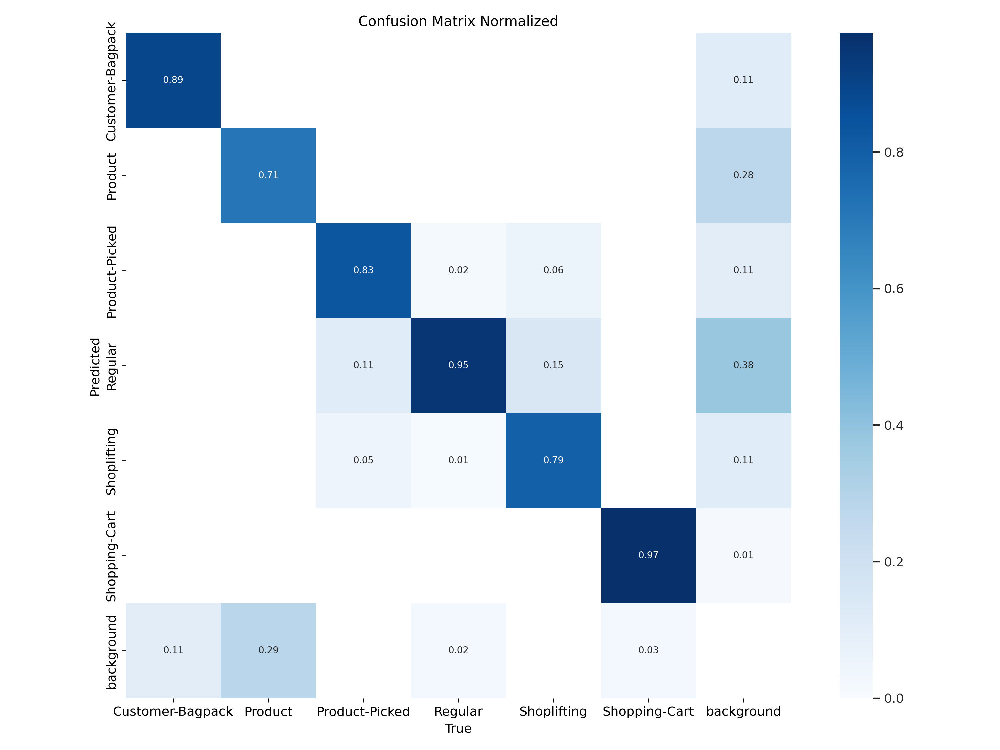

In [ ]:
from IPython.display import display, Image
Image(filename='/content/runs/detect/train42/confusion_matrix_normalized.png', width=600)

# Matrics Evaluation of Fine Tune Trained (YOLOv8m - 1st version of Dataset) on 2nd version Dataset


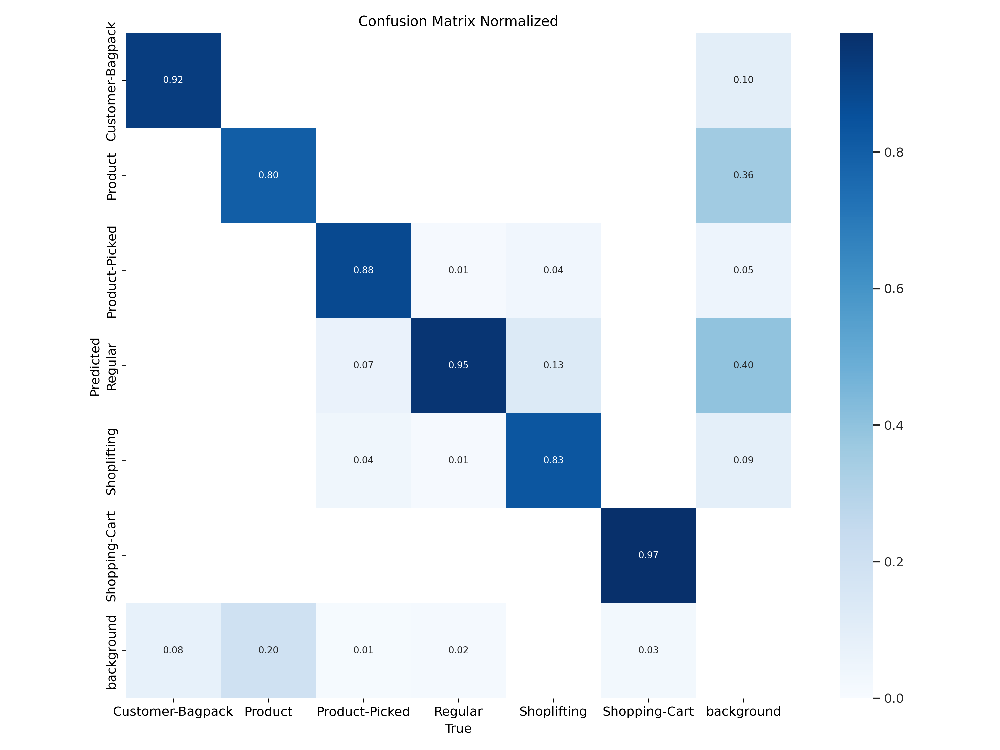

In [ ]:
Image(filename='/content/runs/detect/train52/confusion_matrix_normalized.png', width=600)

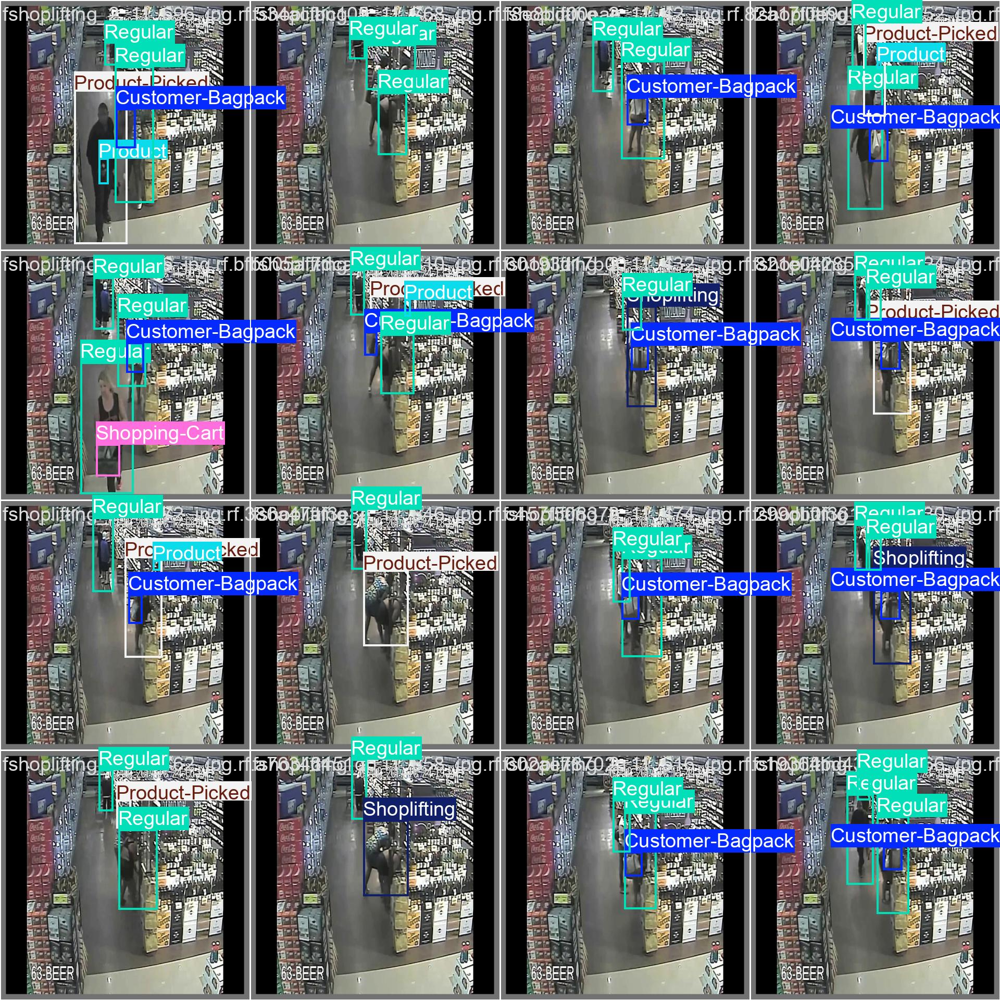

In [ ]:
Image(filename='/content/runs/detect/train42/val_batch2_labels.jpg', width=600)

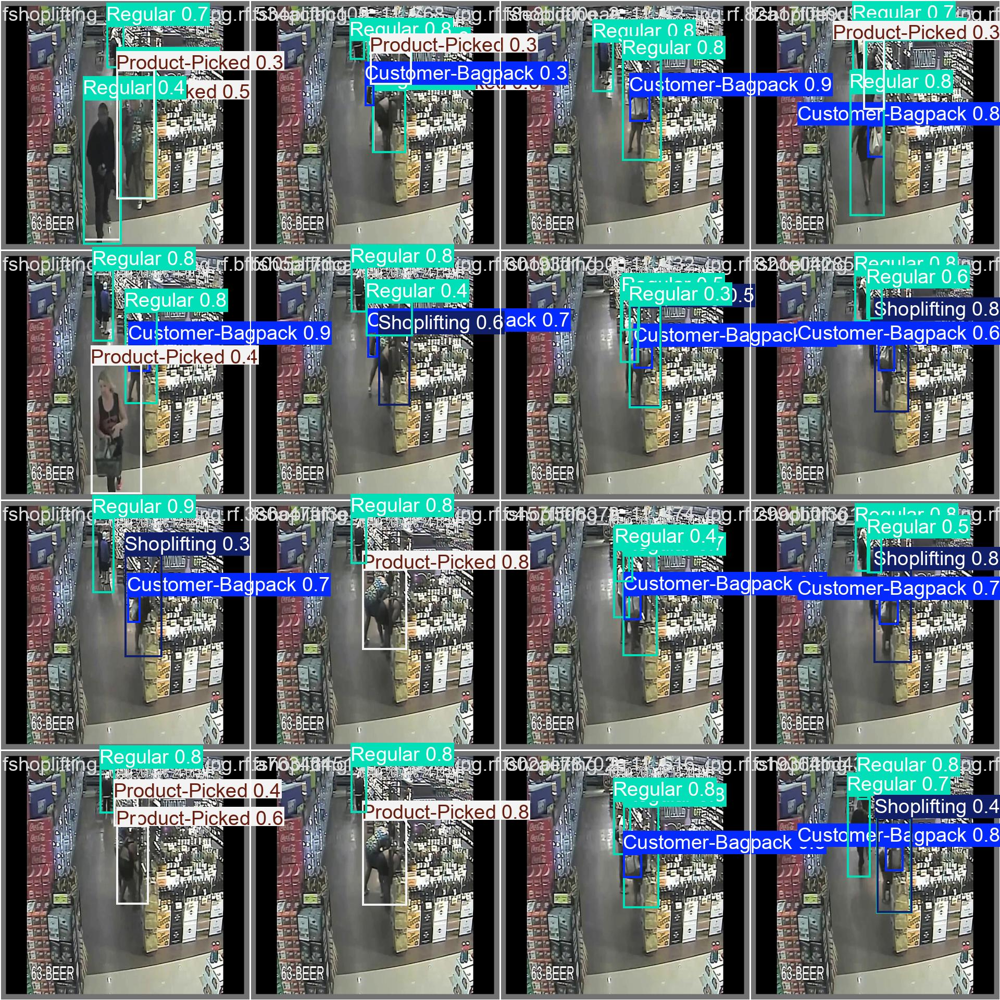

In [ ]:
# Nano
Image(filename='/content/runs/detect/train42/val_batch2_pred.jpg', width=600)

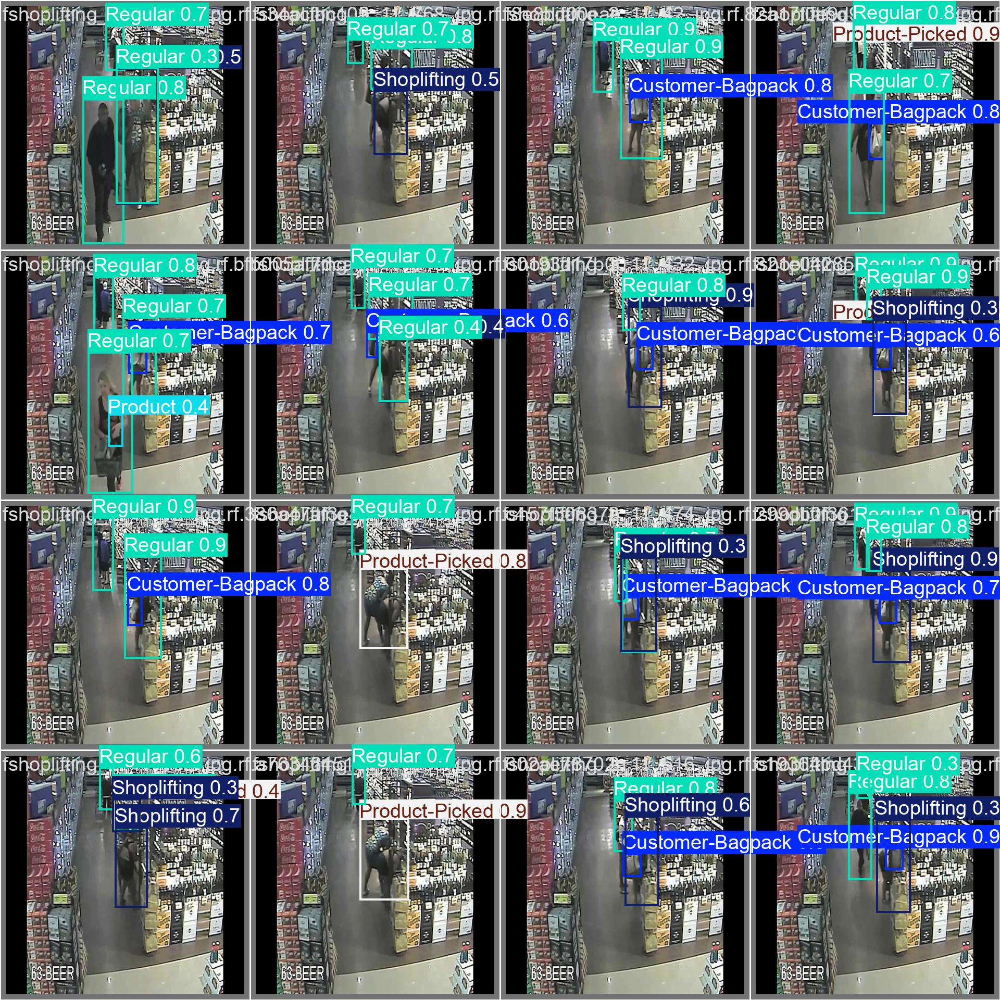

In [ ]:
# Fine Tune on 1st version Dataset
Image(filename='/content/runs/detect/train52/val_batch2_pred.jpg', width=600)

# 3rd Dataset from Roboflow

In [ ]:
!pip install roboflow

from roboflow import Roboflow
rf = Roboflow(api_key="IJqopp3PgIEHEhg8XFkZ")
project = rf.workspace("cc-tv-footage-annotation").project("cc-tv-footage-annotation-b7")
version = project.version(1)
dataset = version.download("yolov8-obb")

loading Roboflow workspace...
loading Roboflow project...



Extracting Dataset Version Zip to CC-TV-Footage-Annotation-B7-1 in yolov8-obb:: 100%|██████████| 5739/5739 [00:00<00:00, 5965.73it/s]


# Fine Tune Trained (YOLOv8m - 2nd version Dataset) model on 3rd version Dataset

In [ ]:
from ultralytics import YOLO

# Load a model
model = YOLO('/content/runs/detect/train5/weights/best.pt')  # load a pretrained model
# Use the model
results = model.train(data='/content/CC-TV-Footage-Annotation-B7-1/data.yaml', epochs=80)  # train the model
results = model.val()  # evaluate model performance on the validation set

Ultralytics YOLOv8.2.77 🚀 Python-3.10.12 torch-2.3.1+cu121 CUDA:0 (NVIDIA L4, 22700MiB)
engine/trainer: task=detect, mode=train, model=/content/runs/detect/train5/weights/best.pt, data=/content/CC-TV-Footage-Annotation-B7-1/data.yaml, epochs=80, time=None, patience=100, batch=16, imgsz=640, save=True, save_period=-1, cache=False, device=None, workers=8, project=None, name=train7, exist_ok=False, pretrained=True, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, multi_scale=False, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, vid_stride=1, stream_buffer=False, visualize=False, augment=False, agnostic_nms=False, classes=None, retina_masks=False, embed=None, show=False, save_frames=False, save_txt=False, save_conf=False,

train: Scanning /content/CC-TV-Footage-Annotation-B7-1/train/labels... 2292 images, 5 backgrounds, 0 corrupt: 100%|██████████| 2292/2292 [00:02<00:00, 1056.46it/s]

train: New cache created: /content/CC-TV-Footage-Annotation-B7-1/train/labels.cache


albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01), CLAHE(p=0.01, clip_limit=(1, 4.0), tile_grid_size=(8, 8))


os.fork() was called. os.fork() is incompatible with multithreaded code, and JAX is multithreaded, so this will likely lead to a deadlock.
val: Scanning /content/CC-TV-Footage-Annotation-B7-1/valid/labels... 573 images, 3 backgrounds, 0 corrupt: 100%|██████████| 573/573 [00:00<00:00, 880.55it/s]

val: New cache created: /content/CC-TV-Footage-Annotation-B7-1/valid/labels.cache


Plotting labels to runs/detect/train7/labels.jpg... 
optimizer: 'optimizer=auto' found, ignoring 'lr0=0.01' and 'momentum=0.937' and determining best 'optimizer', 'lr0' and 'momentum' automatically... 
optimizer: AdamW(lr=0.001, momentum=0.9) with parameter groups 77 weight(decay=0.0), 84 weight(decay=0.0005), 83 bias(decay=0.0)
TensorBoard: model graph visualization added ✅
Image sizes 640 train, 640 val
Using 8 dataloader workers
Logging results to runs/detect/train7
Starting training for 80 epochs...

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       1/80      7.14G      2.096      2.332      2.046         27        640: 100%|██████████| 144/144 [00:47<00:00,  3.01it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 18/18 [00:05<00:00,  3.35it/s]

                   all        573       1751      0.596      0.458      0.513      0.255



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       2/80      7.18G      1.622      1.404      1.648         17        640: 100%|██████████| 144/144 [00:43<00:00,  3.28it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 18/18 [00:05<00:00,  3.34it/s]

                   all        573       1751      0.721      0.595      0.671      0.363



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       3/80      7.18G      1.491      1.236      1.561         35        640: 100%|██████████| 144/144 [00:43<00:00,  3.29it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 18/18 [00:05<00:00,  3.37it/s]

                   all        573       1751      0.721      0.662      0.722      0.408



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       4/80      7.19G      1.447      1.165      1.533         16        640: 100%|██████████| 144/144 [00:43<00:00,  3.31it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 18/18 [00:05<00:00,  3.36it/s]

                   all        573       1751      0.789      0.661      0.751      0.418



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       5/80      7.18G      1.373      1.101      1.478         23        640: 100%|██████████| 144/144 [00:43<00:00,  3.32it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 18/18 [00:05<00:00,  3.36it/s]

                   all        573       1751      0.766      0.712      0.774      0.448



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       6/80      7.18G      1.323      1.028      1.435         32        640: 100%|██████████| 144/144 [00:43<00:00,  3.31it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 18/18 [00:05<00:00,  3.38it/s]

                   all        573       1751       0.81      0.744      0.814      0.481



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       7/80      7.18G      1.307      1.011      1.435         16        640: 100%|██████████| 144/144 [00:43<00:00,  3.33it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 18/18 [00:05<00:00,  3.40it/s]

                   all        573       1751      0.774      0.729      0.783      0.454



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       8/80      7.18G      1.288     0.9877      1.426         30        640: 100%|██████████| 144/144 [00:43<00:00,  3.33it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 18/18 [00:05<00:00,  3.38it/s]

                   all        573       1751      0.794      0.758      0.813      0.489



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       9/80      7.18G      1.231     0.9436      1.386         15        640: 100%|██████████| 144/144 [00:43<00:00,  3.32it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 18/18 [00:05<00:00,  3.39it/s]

                   all        573       1751      0.794      0.775      0.845      0.508



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      10/80      7.17G      1.213     0.9339      1.361         40        640: 100%|██████████| 144/144 [00:43<00:00,  3.32it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 18/18 [00:05<00:00,  3.38it/s]

                   all        573       1751      0.848       0.76      0.835      0.516



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      11/80      7.19G       1.19     0.8926      1.348         22        640: 100%|██████████| 144/144 [00:43<00:00,  3.32it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 18/18 [00:05<00:00,  3.40it/s]

                   all        573       1751      0.818      0.805      0.856      0.532



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      12/80      7.18G      1.142      0.834      1.318         34        640: 100%|██████████| 144/144 [00:43<00:00,  3.33it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 18/18 [00:05<00:00,  3.40it/s]

                   all        573       1751      0.854      0.833      0.874      0.551



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      13/80      7.18G      1.125     0.8213      1.309         27        640: 100%|██████████| 144/144 [00:43<00:00,  3.33it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 18/18 [00:05<00:00,  3.38it/s]

                   all        573       1751      0.854      0.795      0.857       0.54



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      14/80      7.17G      1.105     0.8153      1.289         21        640: 100%|██████████| 144/144 [00:43<00:00,  3.32it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 18/18 [00:05<00:00,  3.38it/s]

                   all        573       1751      0.868      0.824      0.884      0.563



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      15/80      7.18G      1.087      0.794      1.282         17        640: 100%|██████████| 144/144 [00:43<00:00,  3.33it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 18/18 [00:05<00:00,  3.40it/s]

                   all        573       1751      0.844      0.794      0.867      0.548



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      16/80      7.17G      1.084     0.7837      1.273         22        640: 100%|██████████| 144/144 [00:43<00:00,  3.32it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 18/18 [00:05<00:00,  3.36it/s]

                   all        573       1751      0.843      0.826      0.877      0.564



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      17/80      7.18G      1.061     0.7596      1.264         16        640: 100%|██████████| 144/144 [00:43<00:00,  3.33it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 18/18 [00:05<00:00,  3.33it/s]

                   all        573       1751      0.863      0.821      0.881      0.568



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      18/80      7.18G      1.025      0.734      1.247         16        640: 100%|██████████| 144/144 [00:43<00:00,  3.33it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 18/18 [00:05<00:00,  3.40it/s]

                   all        573       1751      0.859      0.837      0.893      0.589



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      19/80      7.18G      1.025      0.757      1.256         15        640: 100%|██████████| 144/144 [00:43<00:00,  3.32it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 18/18 [00:05<00:00,  3.39it/s]

                   all        573       1751      0.864      0.856      0.898      0.586



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      20/80      7.18G      1.008     0.7155       1.24         24        640: 100%|██████████| 144/144 [00:43<00:00,  3.32it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 18/18 [00:05<00:00,  3.41it/s]

                   all        573       1751      0.861      0.825      0.891      0.594



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      21/80      7.18G     0.9892     0.6928      1.228         14        640: 100%|██████████| 144/144 [00:43<00:00,  3.33it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 18/18 [00:05<00:00,  3.40it/s]

                   all        573       1751      0.881      0.844      0.915      0.606



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      22/80      7.18G     0.9833      0.702      1.221         15        640: 100%|██████████| 144/144 [00:43<00:00,  3.32it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 18/18 [00:05<00:00,  3.40it/s]

                   all        573       1751      0.861      0.857      0.904      0.594



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      23/80      7.18G     0.9687     0.6964       1.21         35        640: 100%|██████████| 144/144 [00:43<00:00,  3.33it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 18/18 [00:05<00:00,  3.40it/s]

                   all        573       1751      0.876      0.865      0.895      0.605



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      24/80      7.18G     0.9572     0.6815      1.201         24        640: 100%|██████████| 144/144 [00:43<00:00,  3.32it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 18/18 [00:05<00:00,  3.39it/s]

                   all        573       1751      0.894      0.854      0.906       0.62



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      25/80      7.18G      0.948     0.6667      1.194         19        640: 100%|██████████| 144/144 [00:43<00:00,  3.32it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 18/18 [00:05<00:00,  3.39it/s]

                   all        573       1751      0.882      0.863      0.906      0.618



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      26/80      7.18G     0.9426     0.6576       1.19         29        640: 100%|██████████| 144/144 [00:43<00:00,  3.33it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 18/18 [00:05<00:00,  3.41it/s]

                   all        573       1751      0.876      0.866       0.91      0.617



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      27/80      7.18G     0.9264     0.6457      1.183         25        640: 100%|██████████| 144/144 [00:43<00:00,  3.33it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 18/18 [00:05<00:00,  3.40it/s]

                   all        573       1751      0.874       0.86      0.898      0.614



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      28/80      7.18G     0.9154     0.6373      1.181         30        640: 100%|██████████| 144/144 [00:43<00:00,  3.33it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 18/18 [00:05<00:00,  3.40it/s]

                   all        573       1751      0.887       0.87      0.907      0.633



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      29/80      7.18G     0.9167     0.6488      1.185         26        640: 100%|██████████| 144/144 [00:43<00:00,  3.32it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 18/18 [00:05<00:00,  3.39it/s]

                   all        573       1751      0.863       0.87      0.911      0.645



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      30/80      7.18G     0.8936       0.62      1.155         13        640: 100%|██████████| 144/144 [00:43<00:00,  3.32it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 18/18 [00:05<00:00,  3.38it/s]

                   all        573       1751      0.887      0.872      0.915      0.633



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      31/80      7.18G     0.8856     0.6178      1.157         20        640: 100%|██████████| 144/144 [00:43<00:00,  3.32it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 18/18 [00:05<00:00,  3.37it/s]

                   all        573       1751      0.898      0.863      0.912      0.623



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      32/80      7.17G     0.8942     0.6206      1.166         20        640: 100%|██████████| 144/144 [00:43<00:00,  3.31it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 18/18 [00:05<00:00,  3.37it/s]

                   all        573       1751       0.91      0.866      0.915      0.628



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      33/80      7.18G     0.8841     0.6265      1.157         29        640: 100%|██████████| 144/144 [00:43<00:00,  3.33it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 18/18 [00:05<00:00,  3.38it/s]

                   all        573       1751      0.901      0.864      0.919      0.646



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      34/80      7.18G     0.8672     0.5985      1.139         25        640: 100%|██████████| 144/144 [00:43<00:00,  3.31it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 18/18 [00:05<00:00,  3.40it/s]

                   all        573       1751      0.895      0.888      0.916      0.647



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      35/80      7.19G     0.8514     0.5986      1.136         21        640: 100%|██████████| 144/144 [00:43<00:00,  3.32it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 18/18 [00:05<00:00,  3.40it/s]

                   all        573       1751      0.911      0.875       0.92      0.659



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      36/80      7.19G     0.8387     0.5797      1.125         21        640: 100%|██████████| 144/144 [00:43<00:00,  3.32it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 18/18 [00:05<00:00,  3.37it/s]

                   all        573       1751      0.897      0.871      0.922      0.649



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      37/80      7.18G     0.8344     0.5785      1.128         18        640: 100%|██████████| 144/144 [00:43<00:00,  3.32it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 18/18 [00:05<00:00,  3.41it/s]

                   all        573       1751      0.909      0.874      0.916      0.643



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      38/80      7.18G     0.8318     0.5768      1.127         34        640: 100%|██████████| 144/144 [00:43<00:00,  3.32it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 18/18 [00:05<00:00,  3.38it/s]

                   all        573       1751      0.909      0.868       0.92      0.657



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      39/80      7.18G     0.8073     0.5623      1.113         19        640: 100%|██████████| 144/144 [00:43<00:00,  3.31it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 18/18 [00:05<00:00,  3.37it/s]

                   all        573       1751      0.908      0.883       0.92      0.659



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      40/80      7.18G     0.8098     0.5555      1.106         24        640: 100%|██████████| 144/144 [00:43<00:00,  3.32it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 18/18 [00:05<00:00,  3.38it/s]

                   all        573       1751      0.882      0.895      0.923      0.667



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      41/80      7.19G     0.7846     0.5365        1.1         25        640: 100%|██████████| 144/144 [00:43<00:00,  3.32it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 18/18 [00:05<00:00,  3.39it/s]

                   all        573       1751      0.906       0.88      0.921      0.663



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      42/80      7.18G     0.7966     0.5506      1.101          7        640: 100%|██████████| 144/144 [00:43<00:00,  3.32it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 18/18 [00:05<00:00,  3.38it/s]

                   all        573       1751      0.918      0.882      0.926      0.663



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      43/80      7.18G     0.7907     0.5449      1.101         17        640: 100%|██████████| 144/144 [00:43<00:00,  3.32it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 18/18 [00:05<00:00,  3.39it/s]

                   all        573       1751      0.899      0.899      0.928      0.667



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      44/80      7.18G     0.7828     0.5346      1.101         21        640: 100%|██████████| 144/144 [00:43<00:00,  3.32it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 18/18 [00:05<00:00,  3.38it/s]

                   all        573       1751        0.9      0.903      0.931      0.675



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      45/80      7.18G     0.7728     0.5297      1.094         19        640: 100%|██████████| 144/144 [00:43<00:00,  3.33it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 18/18 [00:05<00:00,  3.39it/s]

                   all        573       1751      0.911      0.898      0.929      0.669



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      46/80      7.18G     0.7722     0.5355      1.092         29        640: 100%|██████████| 144/144 [00:43<00:00,  3.32it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 18/18 [00:05<00:00,  3.38it/s]

                   all        573       1751      0.908       0.91      0.936      0.682



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      47/80      7.18G     0.7551     0.5193      1.085         14        640: 100%|██████████| 144/144 [00:43<00:00,  3.32it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 18/18 [00:05<00:00,  3.39it/s]

                   all        573       1751       0.91      0.896      0.935       0.68



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      48/80      7.18G     0.7457     0.5146       1.07         21        640: 100%|██████████| 144/144 [00:43<00:00,  3.33it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 18/18 [00:05<00:00,  3.37it/s]

                   all        573       1751       0.92      0.874      0.937      0.693



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      49/80      7.18G     0.7366     0.5088      1.074         26        640: 100%|██████████| 144/144 [00:43<00:00,  3.31it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 18/18 [00:05<00:00,  3.35it/s]

                   all        573       1751      0.915        0.9      0.936       0.69



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      50/80      7.18G     0.7251     0.4951      1.062         24        640: 100%|██████████| 144/144 [00:43<00:00,  3.33it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 18/18 [00:05<00:00,  3.39it/s]

                   all        573       1751      0.919        0.9      0.937      0.676



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      51/80      7.18G     0.7333     0.5018      1.072         37        640: 100%|██████████| 144/144 [00:43<00:00,  3.32it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 18/18 [00:05<00:00,  3.39it/s]

                   all        573       1751      0.914      0.888      0.927      0.688



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      52/80      7.18G     0.7243     0.5006      1.067         15        640: 100%|██████████| 144/144 [00:43<00:00,  3.32it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 18/18 [00:05<00:00,  3.41it/s]

                   all        573       1751      0.904      0.906      0.932      0.677



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      53/80      7.18G      0.718     0.4951      1.066         20        640: 100%|██████████| 144/144 [00:43<00:00,  3.32it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 18/18 [00:05<00:00,  3.36it/s]

                   all        573       1751      0.915      0.907      0.941      0.692



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      54/80      7.18G     0.7072     0.4828      1.057         24        640: 100%|██████████| 144/144 [00:43<00:00,  3.32it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 18/18 [00:05<00:00,  3.41it/s]

                   all        573       1751      0.894      0.917      0.928      0.686



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      55/80      7.18G     0.6985      0.477      1.051         31        640: 100%|██████████| 144/144 [00:43<00:00,  3.32it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 18/18 [00:05<00:00,  3.38it/s]

                   all        573       1751      0.919       0.91       0.94      0.699



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      56/80      7.18G     0.6938     0.4789      1.046         17        640: 100%|██████████| 144/144 [00:43<00:00,  3.32it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 18/18 [00:05<00:00,  3.38it/s]

                   all        573       1751      0.908      0.925      0.941      0.697



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      57/80      7.18G     0.6841     0.4688       1.04         25        640: 100%|██████████| 144/144 [00:43<00:00,  3.30it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 18/18 [00:05<00:00,  3.39it/s]

                   all        573       1751      0.925      0.894      0.941      0.701



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      58/80      7.18G     0.6825     0.4668      1.038         19        640: 100%|██████████| 144/144 [00:43<00:00,  3.31it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 18/18 [00:05<00:00,  3.38it/s]

                   all        573       1751      0.915      0.904      0.937      0.701



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      59/80      7.18G     0.6768     0.4634      1.037         24        640: 100%|██████████| 144/144 [00:43<00:00,  3.32it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 18/18 [00:05<00:00,  3.38it/s]

                   all        573       1751      0.921      0.922      0.948       0.71



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      60/80      7.18G     0.6715     0.4581      1.033         21        640: 100%|██████████| 144/144 [00:43<00:00,  3.32it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 18/18 [00:05<00:00,  3.34it/s]

                   all        573       1751      0.905       0.91      0.939      0.706



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      61/80      7.18G     0.6588     0.4527       1.03         23        640: 100%|██████████| 144/144 [00:43<00:00,  3.32it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 18/18 [00:05<00:00,  3.37it/s]

                   all        573       1751      0.912      0.911      0.932      0.705



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      62/80      7.18G     0.6501     0.4459      1.021         37        640: 100%|██████████| 144/144 [00:43<00:00,  3.32it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 18/18 [00:05<00:00,  3.35it/s]

                   all        573       1751      0.932      0.912      0.939      0.712



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      63/80      7.17G     0.6436      0.441      1.023         32        640: 100%|██████████| 144/144 [00:43<00:00,  3.32it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 18/18 [00:05<00:00,  3.38it/s]

                   all        573       1751      0.931      0.903      0.941      0.715



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      64/80      7.18G     0.6487     0.4423      1.021         34        640: 100%|██████████| 144/144 [00:43<00:00,  3.32it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 18/18 [00:05<00:00,  3.37it/s]

                   all        573       1751      0.915      0.911      0.941      0.714



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      65/80      7.18G     0.6376     0.4334      1.016         16        640: 100%|██████████| 144/144 [00:43<00:00,  3.32it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 18/18 [00:05<00:00,  3.38it/s]

                   all        573       1751      0.943        0.9      0.944      0.729



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      66/80      7.18G     0.6372     0.4439      1.012         17        640: 100%|██████████| 144/144 [00:43<00:00,  3.31it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 18/18 [00:05<00:00,  3.40it/s]

                   all        573       1751      0.929      0.908      0.945       0.72



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      67/80      7.18G     0.6254      0.432      1.014         18        640: 100%|██████████| 144/144 [00:43<00:00,  3.32it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 18/18 [00:05<00:00,  3.40it/s]

                   all        573       1751      0.932      0.912      0.944      0.717



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      68/80      7.18G     0.6186     0.4243      1.011         25        640: 100%|██████████| 144/144 [00:43<00:00,  3.32it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 18/18 [00:05<00:00,  3.40it/s]

                   all        573       1751      0.938      0.902      0.944      0.723



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      69/80      7.18G     0.6204     0.4275       1.01         25        640: 100%|██████████| 144/144 [00:43<00:00,  3.32it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 18/18 [00:05<00:00,  3.40it/s]

                   all        573       1751      0.926      0.917      0.946      0.728



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      70/80      7.18G     0.6147     0.4188      1.002         23        640: 100%|██████████| 144/144 [00:43<00:00,  3.31it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 18/18 [00:05<00:00,  3.40it/s]

                   all        573       1751      0.934      0.913      0.947      0.723


Closing dataloader mosaic
albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01), CLAHE(p=0.01, clip_limit=(1, 4.0), tile_grid_size=(8, 8))


os.fork() was called. os.fork() is incompatible with multithreaded code, and JAX is multithreaded, so this will likely lead to a deadlock.



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      71/80      7.18G     0.5529      0.323     0.9836          9        640: 100%|██████████| 144/144 [00:44<00:00,  3.21it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 18/18 [00:05<00:00,  3.37it/s]

                   all        573       1751      0.908      0.915      0.938       0.71



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      72/80      7.18G     0.5311     0.3042     0.9734          9        640: 100%|██████████| 144/144 [00:43<00:00,  3.34it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 18/18 [00:05<00:00,  3.37it/s]

                   all        573       1751      0.921      0.905      0.944      0.718



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      73/80      7.18G     0.5216     0.3016     0.9691         14        640: 100%|██████████| 144/144 [00:43<00:00,  3.33it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 18/18 [00:05<00:00,  3.34it/s]

                   all        573       1751      0.921      0.914      0.945       0.72



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      74/80      7.18G     0.5172      0.297     0.9681         11        640: 100%|██████████| 144/144 [00:43<00:00,  3.32it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 18/18 [00:05<00:00,  3.38it/s]

                   all        573       1751      0.912      0.929       0.95      0.735



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      75/80      7.18G       0.51     0.2997     0.9603         28        640: 100%|██████████| 144/144 [00:43<00:00,  3.33it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 18/18 [00:05<00:00,  3.33it/s]

                   all        573       1751      0.933      0.914       0.95      0.733



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      76/80      7.18G     0.4958     0.2883      0.954         12        640: 100%|██████████| 144/144 [00:43<00:00,  3.33it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 18/18 [00:05<00:00,  3.35it/s]

                   all        573       1751      0.921      0.916      0.951      0.742



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      77/80      7.18G     0.4928     0.2852     0.9525          9        640: 100%|██████████| 144/144 [00:43<00:00,  3.34it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 18/18 [00:05<00:00,  3.38it/s]

                   all        573       1751      0.903      0.927      0.949      0.741



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      78/80      7.18G     0.4841     0.2776     0.9471         13        640: 100%|██████████| 144/144 [00:43<00:00,  3.34it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 18/18 [00:05<00:00,  3.40it/s]

                   all        573       1751      0.928      0.905      0.946      0.737



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      79/80      7.18G     0.4799     0.2792      0.944         10        640: 100%|██████████| 144/144 [00:43<00:00,  3.34it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 18/18 [00:05<00:00,  3.39it/s]

                   all        573       1751      0.932      0.915      0.949       0.74



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      80/80      7.18G     0.4779     0.2774     0.9448         25        640: 100%|██████████| 144/144 [00:43<00:00,  3.34it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 18/18 [00:05<00:00,  3.40it/s]

                   all        573       1751       0.93      0.913       0.95      0.742



80 epochs completed in 1.114 hours.
Optimizer stripped from runs/detect/train7/weights/last.pt, 52.0MB
Optimizer stripped from runs/detect/train7/weights/best.pt, 52.0MB

Validating runs/detect/train7/weights/best.pt...
Ultralytics YOLOv8.2.77 🚀 Python-3.10.12 torch-2.3.1+cu121 CUDA:0 (NVIDIA L4, 22700MiB)
Model summary (fused): 218 layers, 25,843,234 parameters, 0 gradients, 78.7 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 18/18 [00:08<00:00,  2.03it/s]


                   all        573       1751      0.921      0.916      0.951      0.742
      Customer Bagpack        319        346      0.962      0.908       0.96      0.629
               Product        150        154      0.904      0.825      0.885      0.605
        Product-Picked        144        148      0.916      0.932      0.953        0.9
               Regular        442        969      0.942      0.934      0.971      0.819
           Shoplifting         65         69      0.835      0.899      0.945      0.815
         Shopping-Cart         41         65      0.965          1      0.994      0.685
Speed: 0.2ms preprocess, 5.4ms inference, 0.0ms loss, 6.6ms postprocess per image
Results saved to runs/detect/train7
Ultralytics YOLOv8.2.77 🚀 Python-3.10.12 torch-2.3.1+cu121 CUDA:0 (NVIDIA L4, 22700MiB)
Model summary (fused): 218 layers, 25,843,234 parameters, 0 gradients, 78.7 GFLOPs


val: Scanning /content/CC-TV-Footage-Annotation-B7-1/valid/labels.cache... 573 images, 3 backgrounds, 0 corrupt: 100%|██████████| 573/573 [00:00<?, ?it/s]
os.fork() was called. os.fork() is incompatible with multithreaded code, and JAX is multithreaded, so this will likely lead to a deadlock.
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 36/36 [00:11<00:00,  3.20it/s]


                   all        573       1751      0.918      0.914      0.949      0.743
      Customer Bagpack        319        346      0.962      0.908       0.96      0.628
               Product        150        154      0.902      0.825      0.885      0.606
        Product-Picked        144        148      0.916      0.932      0.953        0.9
               Regular        442        969      0.942      0.934      0.971       0.82
           Shoplifting         65         69      0.834      0.899      0.945      0.816
         Shopping-Cart         41         65      0.953      0.985      0.984      0.685
Speed: 0.2ms preprocess, 11.4ms inference, 0.0ms loss, 3.8ms postprocess per image
Results saved to runs/detect/train72


# Metrics Evaluation on 3rd version Dataset

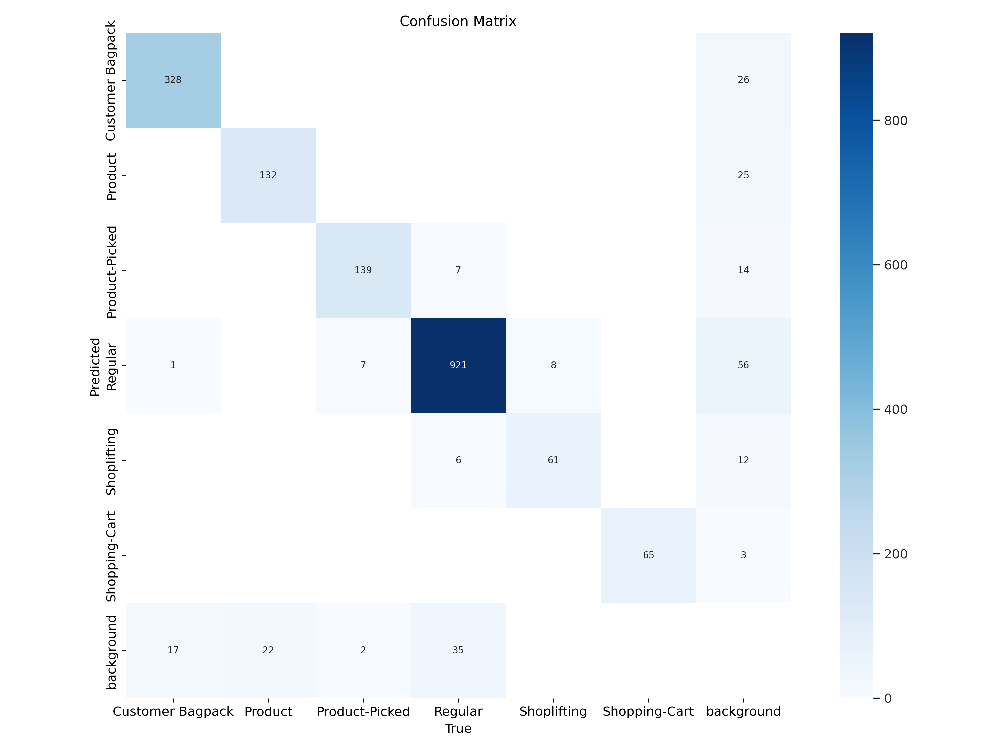

In [ ]:
from IPython.display import display, Image
Image(filename='/content/runs/detect/train72/confusion_matrix.png', width=600)

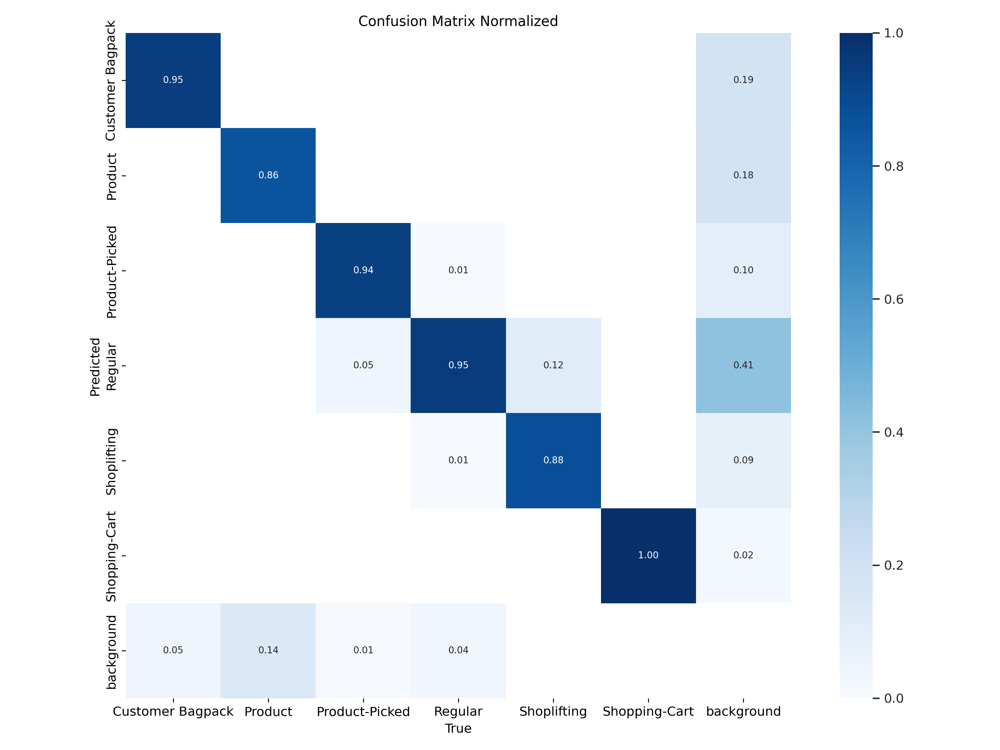

In [ ]:
Image(filename='/content/runs/detect/train72/confusion_matrix_normalized.png', width=600)

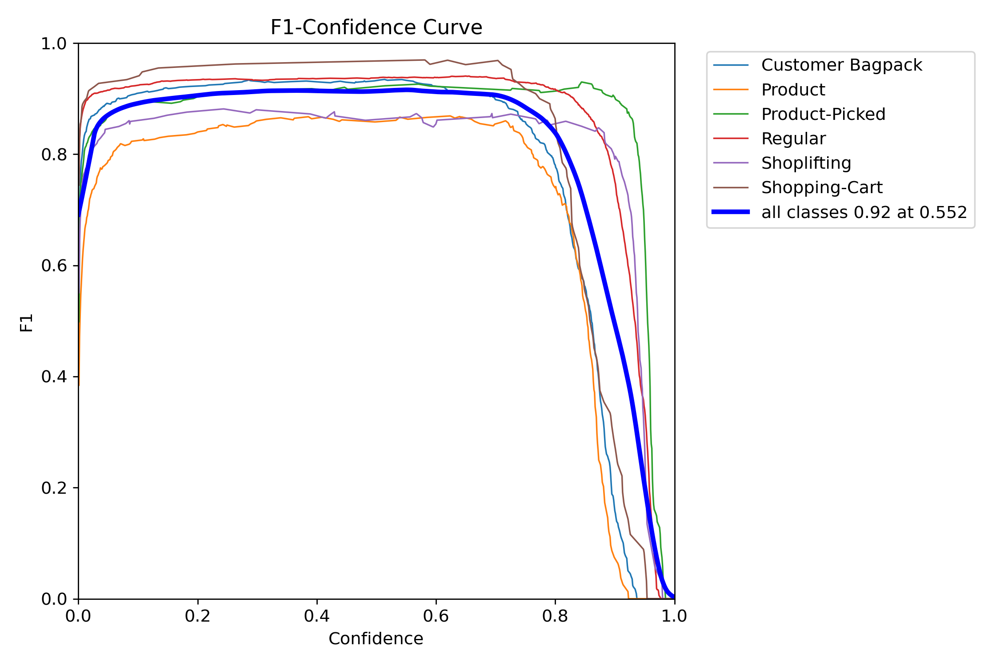

In [ ]:
Image(filename='/content/runs/detect/train72/F1_curve.png', width=600)

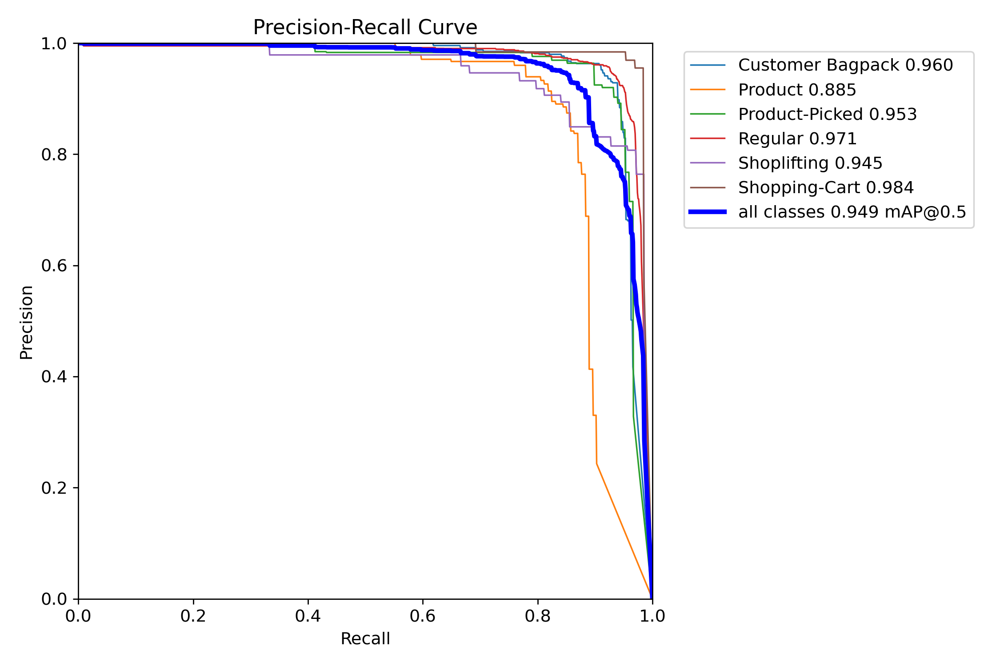

In [ ]:
Image(filename='/content/runs/detect/train72/PR_curve.png', width=600)

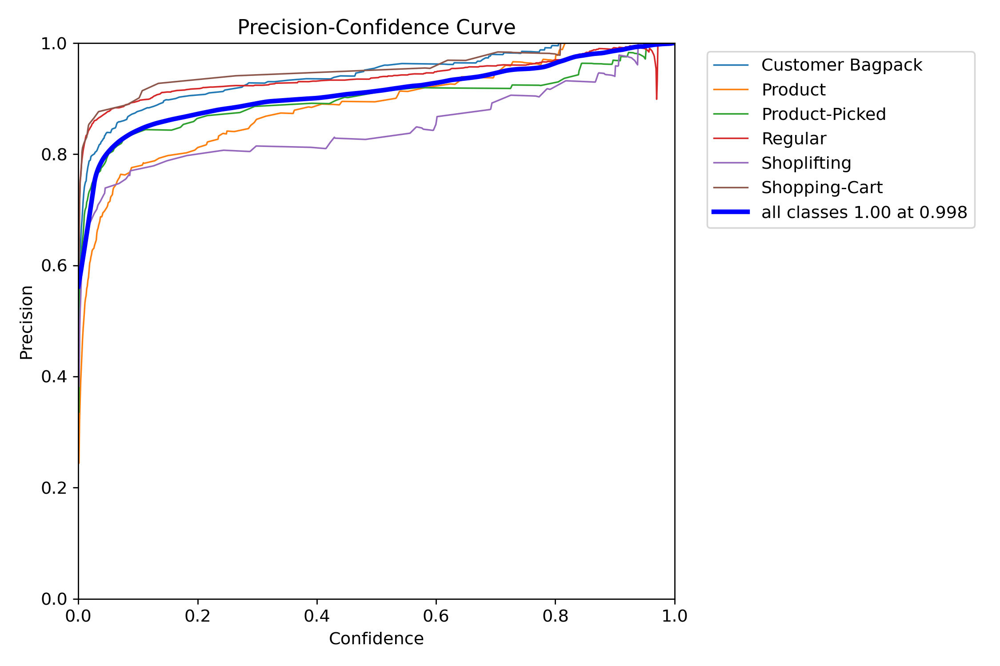

In [ ]:
Image(filename='/content/runs/detect/train72/P_curve.png', width=600)

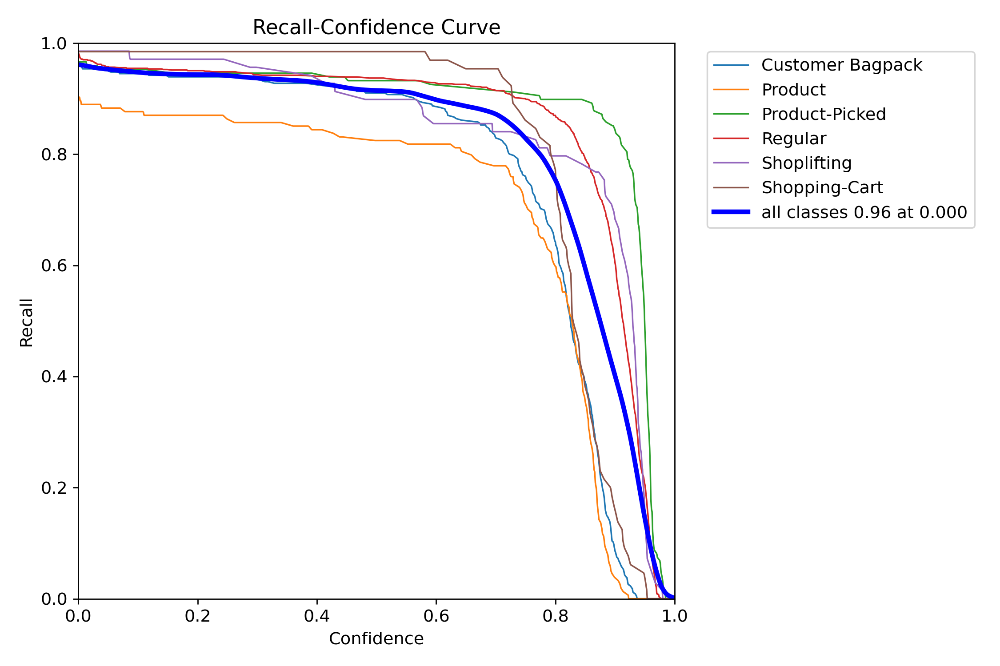

In [ ]:
Image(filename='/content/runs/detect/train72/R_curve.png', width=600)

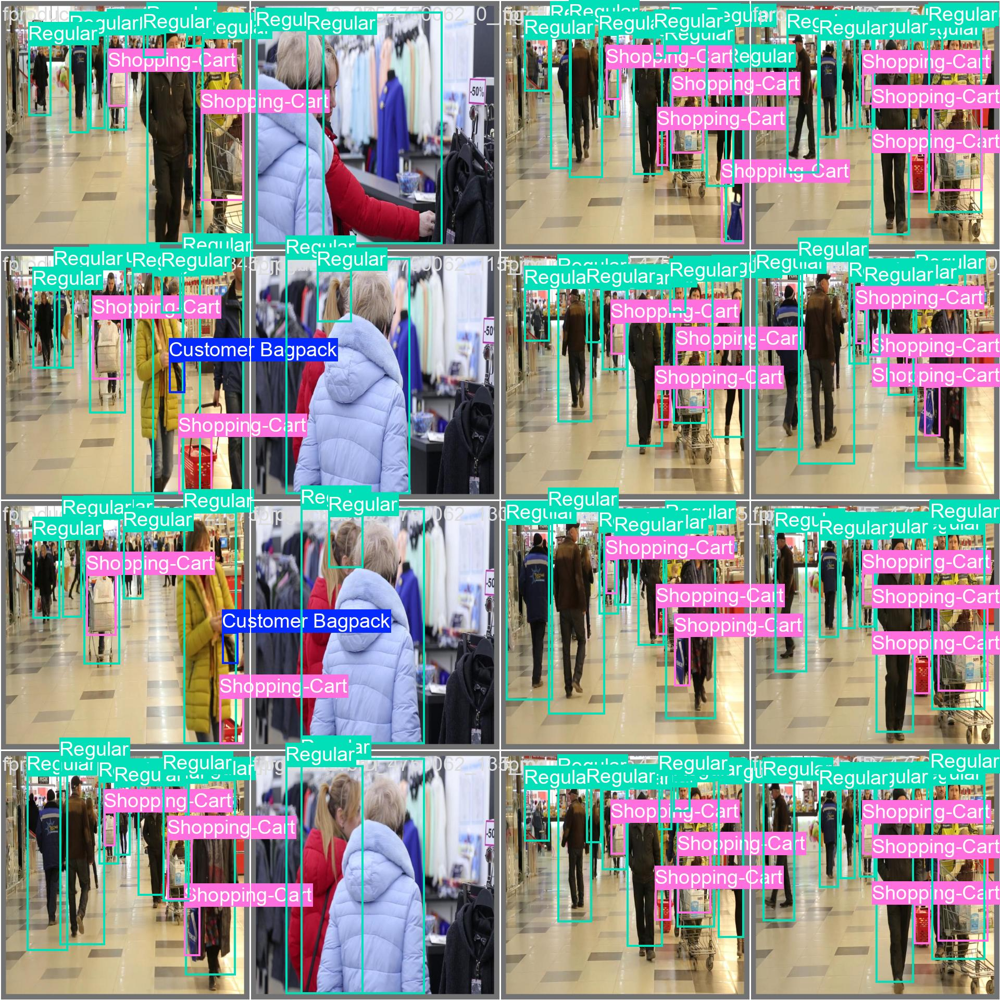

In [ ]:
Image(filename='/content/runs/detect/train72/val_batch2_labels.jpg', width=600)

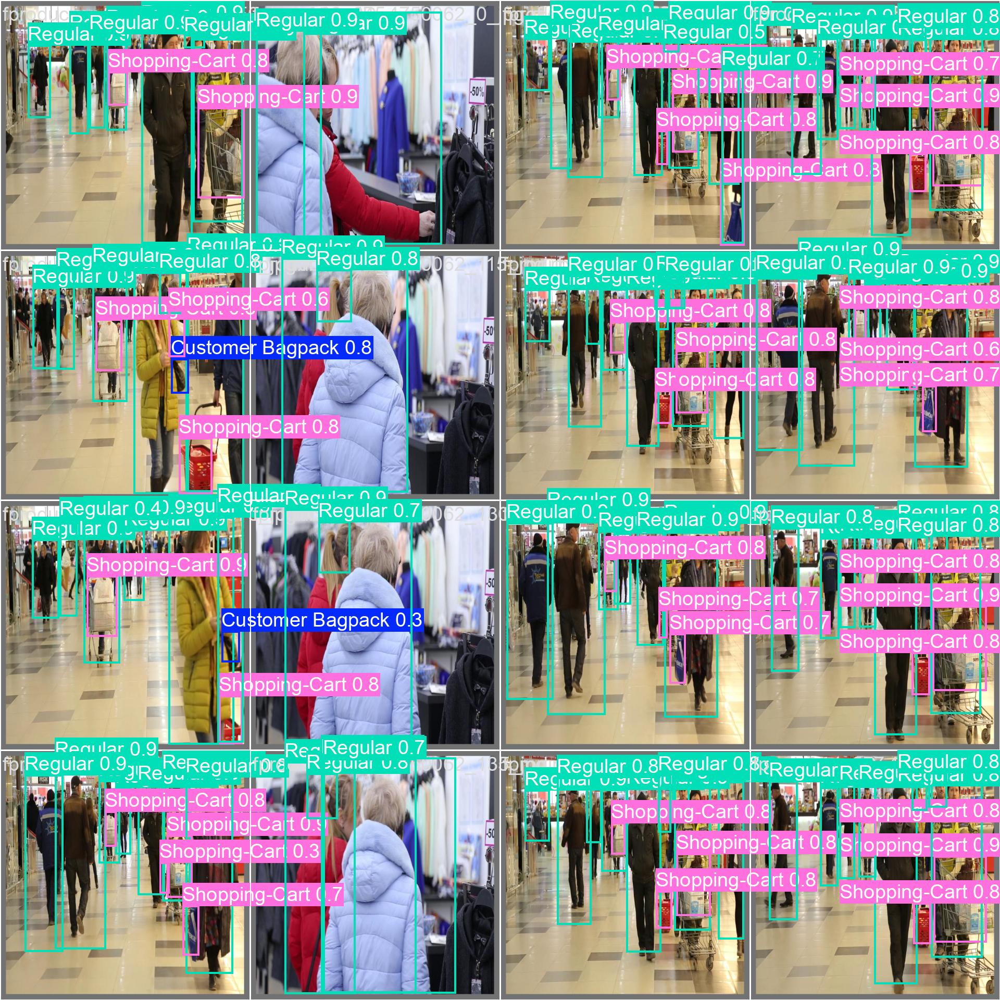

In [ ]:
Image(filename='/content/runs/detect/train72/val_batch2_pred.jpg', width=600)

# Pediction on Fine Tune (YOLOv8m - 3rd version Dataset)

Ultralytics YOLOv8.2.77 🚀 Python-3.10.12 torch-2.3.1+cu121 CUDA:0 (NVIDIA L4, 22700MiB)
Model summary (fused): 218 layers, 25,843,234 parameters, 0 gradients, 78.7 GFLOPs

image 1/1 /content/shoplifting_test.png: 352x640 (no detections), 150.2ms
Speed: 3.7ms preprocess, 150.2ms inference, 25.9ms postprocess per image at shape (1, 3, 352, 640)
Results saved to runs/detect/predict4
💡 Learn more at https://docs.ultralytics.com/modes/predict


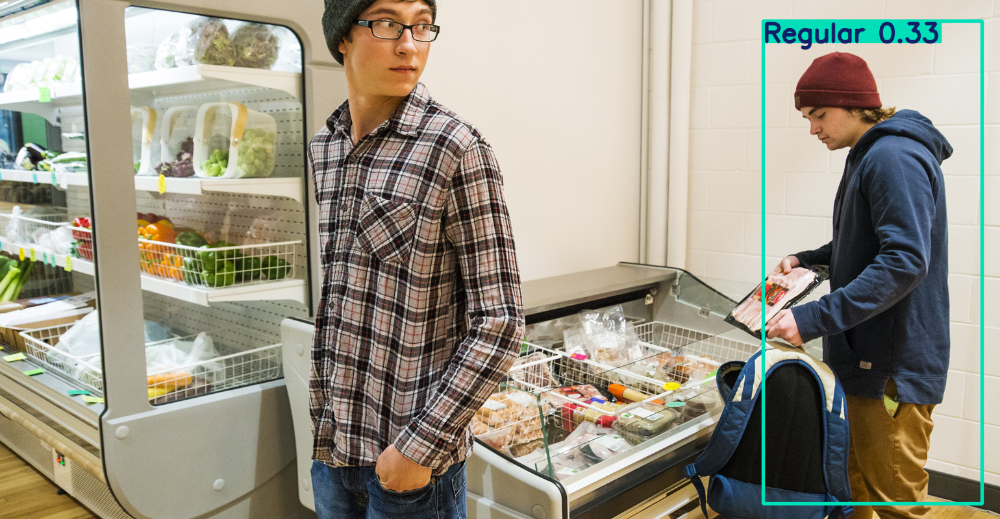

In [ ]:
!yolo predict model=/content/runs/detect/train7/weights/best.pt source=/content/shoplifting_test.png
Image(filename='/content/runs/detect/predict/shoplifting_test.png', width=600)

# 4rth Dataset from Roboflow

In [ ]:
!pip install roboflow

from roboflow import Roboflow
rf = Roboflow(api_key="IJqopp3PgIEHEhg8XFkZ")
project = rf.workspace("cc-tv-footage-annotation-2").project("cc-tv-ai-model-train-b6")
version = project.version(1)
dataset = version.download("yolov8-obb")

loading Roboflow workspace...
loading Roboflow project...



Extracting Dataset Version Zip to CC-TV-AI-Model-Train-B6-1 in yolov8-obb:: 100%|██████████| 5821/5821 [00:01<00:00, 5344.65it/s]


# Fine Tune Trained (YOLOv8m - 3rd Version Dataset) model on 4rth version of Dataset

In [ ]:
from ultralytics import YOLO

# Load a model
model = YOLO('/content/runs/detect/train7/weights/best.pt')  # load a pretrained model
# Use the model
results = model.train(data='/content/CC-TV-AI-Model-Train-B6-1/data.yaml', epochs=100)  # train the model
results = model.val()  # evaluate model performance on the validation set

Ultralytics YOLOv8.2.77 🚀 Python-3.10.12 torch-2.3.1+cu121 CUDA:0 (NVIDIA L4, 22700MiB)
engine/trainer: task=detect, mode=train, model=/content/runs/detect/train7/weights/best.pt, data=/content/CC-TV-AI-Model-Train-B6-1/data.yaml, epochs=100, time=None, patience=100, batch=16, imgsz=640, save=True, save_period=-1, cache=False, device=None, workers=8, project=None, name=train8, exist_ok=False, pretrained=True, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, multi_scale=False, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, vid_stride=1, stream_buffer=False, visualize=False, augment=False, agnostic_nms=False, classes=None, retina_masks=False, embed=None, show=False, save_frames=False, save_txt=False, save_conf=False, sa

train: Scanning /content/CC-TV-AI-Model-Train-B6-1/train/labels... 2325 images, 1 backgrounds, 0 corrupt: 100%|██████████| 2325/2325 [00:02<00:00, 1086.28it/s]

train: New cache created: /content/CC-TV-AI-Model-Train-B6-1/train/labels.cache


albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01), CLAHE(p=0.01, clip_limit=(1, 4.0), tile_grid_size=(8, 8))


os.fork() was called. os.fork() is incompatible with multithreaded code, and JAX is multithreaded, so this will likely lead to a deadlock.
val: Scanning /content/CC-TV-AI-Model-Train-B6-1/valid/labels... 581 images, 2 backgrounds, 0 corrupt: 100%|██████████| 581/581 [00:00<00:00, 924.20it/s]

val: New cache created: /content/CC-TV-AI-Model-Train-B6-1/valid/labels.cache


Plotting labels to runs/detect/train8/labels.jpg... 
optimizer: 'optimizer=auto' found, ignoring 'lr0=0.01' and 'momentum=0.937' and determining best 'optimizer', 'lr0' and 'momentum' automatically... 
optimizer: AdamW(lr=0.001, momentum=0.9) with parameter groups 77 weight(decay=0.0), 84 weight(decay=0.0005), 83 bias(decay=0.0)
TensorBoard: model graph visualization added ✅
Image sizes 640 train, 640 val
Using 8 dataloader workers
Logging results to runs/detect/train8
Starting training for 100 epochs...

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      1/100      7.59G      1.847      2.196      1.953         26        640: 100%|██████████| 146/146 [00:48<00:00,  3.04it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 19/19 [00:05<00:00,  3.37it/s]

                   all        581       1449      0.506      0.521      0.529      0.297



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      2/100      7.32G       1.34      1.282      1.502         24        640: 100%|██████████| 146/146 [00:45<00:00,  3.24it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 19/19 [00:05<00:00,  3.49it/s]

                   all        581       1449      0.681      0.648      0.689      0.407



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      3/100      7.31G      1.197      1.109      1.406         22        640: 100%|██████████| 146/146 [00:44<00:00,  3.31it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 19/19 [00:05<00:00,  3.50it/s]

                   all        581       1449       0.81      0.626      0.734      0.469



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      4/100      7.29G      1.132      1.021       1.37         20        640: 100%|██████████| 146/146 [00:44<00:00,  3.31it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 19/19 [00:05<00:00,  3.47it/s]

                   all        581       1449      0.701      0.709      0.749      0.488



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      5/100      7.32G      1.081     0.9385      1.329         16        640: 100%|██████████| 146/146 [00:43<00:00,  3.32it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 19/19 [00:05<00:00,  3.48it/s]

                   all        581       1449      0.865      0.665      0.771      0.515



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      6/100      7.29G      1.066     0.9239      1.314         19        640: 100%|██████████| 146/146 [00:43<00:00,  3.33it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 19/19 [00:05<00:00,  3.48it/s]

                   all        581       1449      0.813      0.755      0.805      0.552



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      7/100      7.31G      1.029     0.8888      1.289         19        640: 100%|██████████| 146/146 [00:43<00:00,  3.32it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 19/19 [00:05<00:00,  3.51it/s]

                   all        581       1449      0.809      0.817      0.845      0.581



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      8/100      7.28G      1.004     0.8684       1.27         21        640: 100%|██████████| 146/146 [00:44<00:00,  3.31it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 19/19 [00:05<00:00,  3.49it/s]

                   all        581       1449       0.82      0.775      0.865      0.577



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      9/100      7.29G     0.9683     0.8498      1.264         12        640: 100%|██████████| 146/146 [00:44<00:00,  3.32it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 19/19 [00:05<00:00,  3.48it/s]

                   all        581       1449      0.874      0.798      0.877      0.595



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     10/100      7.28G     0.9321     0.7856      1.233         25        640: 100%|██████████| 146/146 [00:43<00:00,  3.32it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 19/19 [00:05<00:00,  3.53it/s]

                   all        581       1449      0.877      0.808      0.878      0.616



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     11/100      7.29G     0.9269     0.7817      1.236         31        640: 100%|██████████| 146/146 [00:43<00:00,  3.33it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 19/19 [00:05<00:00,  3.49it/s]

                   all        581       1449      0.793      0.832      0.859      0.597



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     12/100      7.27G     0.9157     0.7653      1.212         41        640: 100%|██████████| 146/146 [00:43<00:00,  3.33it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 19/19 [00:05<00:00,  3.51it/s]

                   all        581       1449      0.877       0.84       0.89      0.629



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     13/100       7.3G     0.8962     0.7386      1.198         19        640: 100%|██████████| 146/146 [00:43<00:00,  3.32it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 19/19 [00:05<00:00,  3.50it/s]

                   all        581       1449      0.877      0.826      0.885      0.629



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     14/100      7.27G     0.8817     0.7369      1.197         28        640: 100%|██████████| 146/146 [00:43<00:00,  3.32it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 19/19 [00:05<00:00,  3.50it/s]

                   all        581       1449      0.885       0.79      0.866      0.607



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     15/100      7.29G     0.8827     0.7218      1.194         12        640: 100%|██████████| 146/146 [00:43<00:00,  3.32it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 19/19 [00:05<00:00,  3.52it/s]

                   all        581       1449      0.882      0.829      0.877      0.634



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     16/100      7.28G     0.8526     0.6978      1.175         24        640: 100%|██████████| 146/146 [00:43<00:00,  3.32it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 19/19 [00:05<00:00,  3.51it/s]

                   all        581       1449      0.842      0.828      0.879      0.639



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     17/100       7.3G     0.8465     0.6843      1.173         22        640: 100%|██████████| 146/146 [00:43<00:00,  3.32it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 19/19 [00:05<00:00,  3.50it/s]

                   all        581       1449       0.87      0.862      0.904      0.654



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     18/100      7.27G     0.8379     0.6823      1.174         24        640: 100%|██████████| 146/146 [00:43<00:00,  3.33it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 19/19 [00:05<00:00,  3.49it/s]

                   all        581       1449      0.915      0.844      0.914      0.661



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     19/100       7.3G     0.8279     0.6683      1.159         35        640: 100%|██████████| 146/146 [00:43<00:00,  3.33it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 19/19 [00:05<00:00,  3.52it/s]

                   all        581       1449      0.869       0.87      0.906      0.665



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     20/100      7.29G       0.82      0.659      1.155         24        640: 100%|██████████| 146/146 [00:43<00:00,  3.32it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 19/19 [00:05<00:00,  3.52it/s]

                   all        581       1449      0.887      0.861       0.91      0.673



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     21/100       7.3G     0.8035     0.6437      1.139         26        640: 100%|██████████| 146/146 [00:43<00:00,  3.32it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 19/19 [00:05<00:00,  3.53it/s]

                   all        581       1449      0.899      0.876      0.917      0.687



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     22/100      7.28G     0.7956     0.6382      1.139         23        640: 100%|██████████| 146/146 [00:43<00:00,  3.33it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 19/19 [00:05<00:00,  3.48it/s]

                   all        581       1449      0.903      0.869      0.921      0.696



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     23/100       7.3G     0.7948     0.6474      1.139         27        640: 100%|██████████| 146/146 [00:43<00:00,  3.33it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 19/19 [00:05<00:00,  3.48it/s]

                   all        581       1449      0.903      0.881      0.922      0.687



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     24/100      7.29G     0.7828     0.6221      1.126         21        640: 100%|██████████| 146/146 [00:43<00:00,  3.33it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 19/19 [00:05<00:00,  3.54it/s]

                   all        581       1449      0.901      0.845      0.919      0.686



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     25/100      7.31G     0.7766     0.6086      1.125         36        640: 100%|██████████| 146/146 [00:43<00:00,  3.32it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 19/19 [00:05<00:00,  3.53it/s]

                   all        581       1449      0.899      0.857      0.917      0.692



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     26/100      7.28G      0.764     0.6098      1.119         27        640: 100%|██████████| 146/146 [00:43<00:00,  3.33it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 19/19 [00:05<00:00,  3.49it/s]

                   all        581       1449      0.899      0.856      0.921      0.689



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     27/100       7.3G     0.7531      0.595      1.116         24        640: 100%|██████████| 146/146 [00:43<00:00,  3.33it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 19/19 [00:05<00:00,  3.50it/s]

                   all        581       1449       0.91      0.891      0.938      0.711



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     28/100      7.29G     0.7548     0.5953      1.115         23        640: 100%|██████████| 146/146 [00:43<00:00,  3.32it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 19/19 [00:05<00:00,  3.54it/s]

                   all        581       1449      0.881      0.856      0.919      0.691



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     29/100       7.3G     0.7319     0.5821      1.103         24        640: 100%|██████████| 146/146 [00:43<00:00,  3.33it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 19/19 [00:05<00:00,  3.50it/s]

                   all        581       1449       0.89      0.884      0.925      0.708



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     30/100      7.27G     0.7284      0.576        1.1         31        640: 100%|██████████| 146/146 [00:43<00:00,  3.33it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 19/19 [00:05<00:00,  3.52it/s]

                   all        581       1449      0.895        0.9      0.939      0.723



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     31/100      7.31G     0.7257     0.5718      1.103         27        640: 100%|██████████| 146/146 [00:43<00:00,  3.33it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 19/19 [00:05<00:00,  3.50it/s]

                   all        581       1449      0.902      0.894       0.93      0.719



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     32/100      7.28G     0.7158     0.5691      1.094         19        640: 100%|██████████| 146/146 [00:43<00:00,  3.32it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 19/19 [00:05<00:00,  3.52it/s]

                   all        581       1449      0.898      0.897      0.937      0.721



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     33/100       7.3G     0.7038     0.5572      1.085         36        640: 100%|██████████| 146/146 [00:43<00:00,  3.33it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 19/19 [00:05<00:00,  3.53it/s]

                   all        581       1449      0.904      0.901       0.93      0.722



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     34/100      7.28G     0.7127     0.5674       1.09         23        640: 100%|██████████| 146/146 [00:43<00:00,  3.33it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 19/19 [00:05<00:00,  3.51it/s]

                   all        581       1449      0.902      0.885      0.934      0.727



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     35/100       7.3G     0.6965     0.5551      1.088         23        640: 100%|██████████| 146/146 [00:43<00:00,  3.33it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 19/19 [00:05<00:00,  3.50it/s]

                   all        581       1449      0.887      0.922      0.937      0.724



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     36/100      7.27G     0.6886     0.5401      1.077         21        640: 100%|██████████| 146/146 [00:43<00:00,  3.32it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 19/19 [00:05<00:00,  3.52it/s]

                   all        581       1449      0.901      0.896      0.934      0.723



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     37/100      7.29G     0.6969     0.5436       1.08         25        640: 100%|██████████| 146/146 [00:43<00:00,  3.32it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 19/19 [00:05<00:00,  3.51it/s]

                   all        581       1449      0.919      0.896      0.932      0.729



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     38/100      7.27G     0.6793     0.5378      1.072         35        640: 100%|██████████| 146/146 [00:43<00:00,  3.32it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 19/19 [00:05<00:00,  3.50it/s]

                   all        581       1449      0.889      0.911      0.943      0.729



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     39/100      7.29G     0.6814     0.5373      1.076         24        640: 100%|██████████| 146/146 [00:43<00:00,  3.32it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 19/19 [00:05<00:00,  3.48it/s]

                   all        581       1449      0.924      0.893      0.942      0.734



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     40/100      7.27G     0.6567     0.5257      1.064         26        640: 100%|██████████| 146/146 [00:43<00:00,  3.33it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 19/19 [00:05<00:00,  3.51it/s]

                   all        581       1449      0.894      0.905      0.941      0.738



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     41/100       7.3G     0.6595     0.5157      1.061         25        640: 100%|██████████| 146/146 [00:43<00:00,  3.33it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 19/19 [00:05<00:00,  3.51it/s]

                   all        581       1449      0.909      0.926      0.942      0.736



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     42/100      7.28G     0.6677     0.5154      1.061         25        640: 100%|██████████| 146/146 [00:43<00:00,  3.32it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 19/19 [00:05<00:00,  3.52it/s]

                   all        581       1449      0.874      0.921      0.944      0.738



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     43/100      7.29G     0.6505     0.5064      1.056         33        640: 100%|██████████| 146/146 [00:43<00:00,  3.32it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 19/19 [00:05<00:00,  3.49it/s]

                   all        581       1449      0.912      0.928       0.95      0.739



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     44/100      7.28G     0.6447     0.5102      1.051          9        640: 100%|██████████| 146/146 [00:43<00:00,  3.33it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 19/19 [00:05<00:00,  3.51it/s]

                   all        581       1449      0.874      0.916      0.936      0.734



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     45/100      7.31G     0.6456     0.5048      1.046         25        640: 100%|██████████| 146/146 [00:43<00:00,  3.32it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 19/19 [00:05<00:00,  3.53it/s]

                   all        581       1449      0.918      0.899      0.942      0.737



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     46/100      7.28G     0.6511     0.5034      1.054         34        640: 100%|██████████| 146/146 [00:43<00:00,  3.32it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 19/19 [00:05<00:00,  3.52it/s]

                   all        581       1449      0.917      0.911      0.944      0.753



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     47/100       7.3G     0.6341     0.4966      1.045         25        640: 100%|██████████| 146/146 [00:44<00:00,  3.32it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 19/19 [00:05<00:00,  3.51it/s]

                   all        581       1449      0.918      0.926       0.95      0.748



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     48/100      7.28G     0.6329     0.4988      1.047         21        640: 100%|██████████| 146/146 [00:43<00:00,  3.32it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 19/19 [00:05<00:00,  3.52it/s]

                   all        581       1449      0.892      0.928      0.942      0.748



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     49/100      7.29G     0.6324     0.4873      1.042         34        640: 100%|██████████| 146/146 [00:43<00:00,  3.33it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 19/19 [00:05<00:00,  3.52it/s]

                   all        581       1449       0.93      0.911      0.949      0.756



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     50/100      7.26G     0.6333     0.4867       1.04         27        640: 100%|██████████| 146/146 [00:44<00:00,  3.32it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 19/19 [00:05<00:00,  3.51it/s]

                   all        581       1449      0.888       0.92       0.93      0.743



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     51/100      7.28G     0.5967     0.4608      1.023         28        640: 100%|██████████| 146/146 [00:43<00:00,  3.32it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 19/19 [00:05<00:00,  3.49it/s]

                   all        581       1449        0.9      0.915      0.929      0.749



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     52/100      7.28G     0.6179     0.4799      1.039         20        640: 100%|██████████| 146/146 [00:43<00:00,  3.33it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 19/19 [00:05<00:00,  3.49it/s]

                   all        581       1449      0.867      0.931      0.934      0.748



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     53/100      7.31G     0.5997     0.4696       1.02         20        640: 100%|██████████| 146/146 [00:44<00:00,  3.32it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 19/19 [00:05<00:00,  3.51it/s]

                   all        581       1449      0.904      0.921      0.951      0.762



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     54/100      7.27G     0.6026     0.4646      1.024         19        640: 100%|██████████| 146/146 [00:43<00:00,  3.32it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 19/19 [00:05<00:00,  3.51it/s]

                   all        581       1449      0.912      0.903      0.947      0.763



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     55/100       7.3G     0.5991      0.472      1.022         19        640: 100%|██████████| 146/146 [00:43<00:00,  3.32it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 19/19 [00:05<00:00,  3.50it/s]

                   all        581       1449      0.895      0.921      0.948      0.762



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     56/100      7.27G     0.5831     0.4505      1.013         24        640: 100%|██████████| 146/146 [00:43<00:00,  3.32it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 19/19 [00:05<00:00,  3.53it/s]

                   all        581       1449      0.928      0.934      0.951      0.758



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     57/100      7.31G     0.5903     0.4549      1.015         29        640: 100%|██████████| 146/146 [00:43<00:00,  3.32it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 19/19 [00:05<00:00,  3.48it/s]

                   all        581       1449       0.91      0.936      0.954      0.769



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     58/100      7.28G      0.575     0.4379      1.007         25        640: 100%|██████████| 146/146 [00:43<00:00,  3.32it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 19/19 [00:05<00:00,  3.53it/s]

                   all        581       1449      0.913      0.914      0.946      0.765



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     59/100       7.3G     0.5848     0.4458      1.015         29        640: 100%|██████████| 146/146 [00:43<00:00,  3.32it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 19/19 [00:05<00:00,  3.49it/s]

                   all        581       1449      0.905      0.914      0.947      0.764



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     60/100      7.28G     0.5713     0.4489      1.007         20        640: 100%|██████████| 146/146 [00:43<00:00,  3.32it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 19/19 [00:05<00:00,  3.53it/s]

                   all        581       1449      0.913      0.909      0.939      0.755



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     61/100       7.3G     0.5692     0.4405      1.006         26        640: 100%|██████████| 146/146 [00:43<00:00,  3.32it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 19/19 [00:05<00:00,  3.53it/s]

                   all        581       1449      0.925      0.925      0.945      0.758



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     62/100      7.28G     0.5693     0.4368      1.007         34        640: 100%|██████████| 146/146 [00:44<00:00,  3.32it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 19/19 [00:05<00:00,  3.53it/s]

                   all        581       1449      0.919      0.932      0.953      0.773



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     63/100       7.3G     0.5572     0.4279     0.9991         39        640: 100%|██████████| 146/146 [00:43<00:00,  3.32it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 19/19 [00:05<00:00,  3.48it/s]

                   all        581       1449      0.915      0.929      0.959      0.777



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     64/100      7.28G     0.5612     0.4363      1.005         23        640: 100%|██████████| 146/146 [00:43<00:00,  3.32it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 19/19 [00:05<00:00,  3.50it/s]

                   all        581       1449      0.936      0.914      0.955      0.783



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     65/100      7.31G     0.5506     0.4264     0.9994         26        640: 100%|██████████| 146/146 [00:43<00:00,  3.32it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 19/19 [00:05<00:00,  3.52it/s]

                   all        581       1449       0.91      0.935      0.949      0.771



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     66/100      7.28G     0.5492     0.4189     0.9965         19        640: 100%|██████████| 146/146 [00:43<00:00,  3.33it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 19/19 [00:05<00:00,  3.51it/s]

                   all        581       1449      0.916      0.923      0.955      0.779



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     67/100      7.31G     0.5504     0.4296      1.004         23        640: 100%|██████████| 146/146 [00:43<00:00,  3.32it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 19/19 [00:05<00:00,  3.49it/s]

                   all        581       1449      0.916       0.93      0.951      0.777



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     68/100      7.28G     0.5397     0.4182     0.9957         16        640: 100%|██████████| 146/146 [00:43<00:00,  3.32it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 19/19 [00:05<00:00,  3.52it/s]

                   all        581       1449      0.922      0.921      0.949      0.782



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     69/100      7.29G     0.5318     0.4071     0.9938         25        640: 100%|██████████| 146/146 [00:43<00:00,  3.33it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 19/19 [00:05<00:00,  3.51it/s]

                   all        581       1449      0.927      0.919      0.953      0.778



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     70/100      7.28G     0.5297     0.4084      0.988         19        640: 100%|██████████| 146/146 [00:43<00:00,  3.33it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 19/19 [00:05<00:00,  3.54it/s]

                   all        581       1449      0.919       0.93      0.954       0.79



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     71/100      7.32G     0.5287     0.3986     0.9913         16        640: 100%|██████████| 146/146 [00:43<00:00,  3.32it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 19/19 [00:05<00:00,  3.52it/s]

                   all        581       1449      0.931      0.919      0.952      0.784



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     72/100      7.27G     0.5281     0.4035     0.9829         19        640: 100%|██████████| 146/146 [00:43<00:00,  3.33it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 19/19 [00:05<00:00,  3.50it/s]

                   all        581       1449      0.913      0.935      0.949      0.781



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     73/100      7.29G     0.5191     0.3983     0.9813         24        640: 100%|██████████| 146/146 [00:43<00:00,  3.32it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 19/19 [00:05<00:00,  3.52it/s]

                   all        581       1449      0.942      0.918      0.948      0.786



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     74/100      7.29G     0.5148     0.3929     0.9794         14        640: 100%|██████████| 146/146 [00:43<00:00,  3.32it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 19/19 [00:05<00:00,  3.50it/s]

                   all        581       1449       0.93      0.926      0.947      0.781



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     75/100       7.3G     0.5091     0.3956     0.9803         20        640: 100%|██████████| 146/146 [00:43<00:00,  3.32it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 19/19 [00:05<00:00,  3.51it/s]

                   all        581       1449       0.92      0.928      0.951      0.782



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     76/100      7.26G     0.5065     0.3921     0.9706         18        640: 100%|██████████| 146/146 [00:43<00:00,  3.33it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 19/19 [00:05<00:00,  3.52it/s]

                   all        581       1449      0.936      0.933       0.96      0.788



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     77/100       7.3G     0.5102     0.3943     0.9774         22        640: 100%|██████████| 146/146 [00:43<00:00,  3.32it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 19/19 [00:05<00:00,  3.51it/s]

                   all        581       1449      0.925       0.93      0.955       0.79



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     78/100      7.27G     0.4943     0.3831     0.9634         25        640: 100%|██████████| 146/146 [00:44<00:00,  3.32it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 19/19 [00:05<00:00,  3.52it/s]

                   all        581       1449      0.926      0.931      0.962      0.793



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     79/100       7.3G     0.4977     0.3772       0.97         16        640: 100%|██████████| 146/146 [00:43<00:00,  3.32it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 19/19 [00:05<00:00,  3.53it/s]

                   all        581       1449       0.93       0.93      0.956      0.786



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     80/100      7.27G     0.4877     0.3801     0.9678         15        640: 100%|██████████| 146/146 [00:43<00:00,  3.33it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 19/19 [00:05<00:00,  3.52it/s]

                   all        581       1449      0.927      0.927      0.953      0.787



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     81/100      7.31G     0.4959     0.3873     0.9681         21        640: 100%|██████████| 146/146 [00:43<00:00,  3.32it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 19/19 [00:05<00:00,  3.52it/s]

                   all        581       1449      0.917      0.937      0.955      0.792



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     82/100      7.29G     0.4882     0.3718      0.971         29        640: 100%|██████████| 146/146 [00:43<00:00,  3.32it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 19/19 [00:05<00:00,  3.49it/s]

                   all        581       1449       0.93      0.931      0.956      0.796



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     83/100      7.31G     0.4874     0.3765     0.9649         26        640: 100%|██████████| 146/146 [00:43<00:00,  3.32it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 19/19 [00:05<00:00,  3.51it/s]

                   all        581       1449       0.93      0.933      0.957      0.798



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     84/100      7.28G     0.4846     0.3804     0.9694         20        640: 100%|██████████| 146/146 [00:43<00:00,  3.32it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 19/19 [00:05<00:00,  3.52it/s]

                   all        581       1449      0.919      0.944      0.955      0.796



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     85/100      7.29G     0.4712     0.3675     0.9584         23        640: 100%|██████████| 146/146 [00:43<00:00,  3.32it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 19/19 [00:05<00:00,  3.53it/s]

                   all        581       1449      0.922      0.939      0.951      0.792



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     86/100      7.28G     0.4776     0.3669     0.9582         17        640: 100%|██████████| 146/146 [00:43<00:00,  3.32it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 19/19 [00:05<00:00,  3.53it/s]

                   all        581       1449      0.924      0.941      0.957        0.8



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     87/100       7.3G     0.4724     0.3576     0.9595         21        640: 100%|██████████| 146/146 [00:43<00:00,  3.32it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 19/19 [00:05<00:00,  3.52it/s]

                   all        581       1449      0.911      0.947      0.952      0.795



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     88/100      7.27G     0.4678     0.3631     0.9613         25        640: 100%|██████████| 146/146 [00:43<00:00,  3.32it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 19/19 [00:05<00:00,  3.48it/s]

                   all        581       1449      0.922      0.937      0.953      0.797



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     89/100       7.3G     0.4644      0.359     0.9543         41        640: 100%|██████████| 146/146 [00:43<00:00,  3.33it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 19/19 [00:05<00:00,  3.51it/s]

                   all        581       1449      0.927      0.936      0.951        0.8



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     90/100      7.26G     0.4589     0.3567     0.9564         32        640: 100%|██████████| 146/146 [00:43<00:00,  3.32it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 19/19 [00:05<00:00,  3.53it/s]

                   all        581       1449       0.94      0.932      0.956      0.802


Closing dataloader mosaic
albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01), CLAHE(p=0.01, clip_limit=(1, 4.0), tile_grid_size=(8, 8))


os.fork() was called. os.fork() is incompatible with multithreaded code, and JAX is multithreaded, so this will likely lead to a deadlock.



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     91/100       7.3G     0.4369     0.2772     0.9304          9        640: 100%|██████████| 146/146 [00:44<00:00,  3.26it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 19/19 [00:05<00:00,  3.50it/s]

                   all        581       1449      0.923      0.927      0.949      0.794



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     92/100      7.28G     0.4031     0.2534      0.913          8        640: 100%|██████████| 146/146 [00:43<00:00,  3.34it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 19/19 [00:05<00:00,  3.50it/s]

                   all        581       1449      0.941       0.93      0.956      0.804



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     93/100      7.29G     0.3953     0.2514     0.9078         13        640: 100%|██████████| 146/146 [00:43<00:00,  3.34it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 19/19 [00:05<00:00,  3.49it/s]

                   all        581       1449      0.938      0.934      0.953      0.803



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     94/100      7.28G     0.3911      0.244     0.9068         10        640: 100%|██████████| 146/146 [00:43<00:00,  3.33it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 19/19 [00:05<00:00,  3.50it/s]

                   all        581       1449      0.933       0.94      0.954      0.808



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     95/100      7.31G      0.384     0.2403      0.904         12        640: 100%|██████████| 146/146 [00:43<00:00,  3.34it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 19/19 [00:05<00:00,  3.49it/s]

                   all        581       1449      0.929      0.944      0.954      0.807



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     96/100      7.28G     0.3841     0.2446     0.9025         10        640: 100%|██████████| 146/146 [00:43<00:00,  3.33it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 19/19 [00:05<00:00,  3.49it/s]

                   all        581       1449      0.933      0.944      0.957      0.811



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     97/100      7.28G      0.376     0.2367     0.9045         10        640: 100%|██████████| 146/146 [00:43<00:00,  3.34it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 19/19 [00:05<00:00,  3.47it/s]

                   all        581       1449      0.935      0.936      0.957      0.811



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     98/100      7.27G     0.3686     0.2336     0.8913          9        640: 100%|██████████| 146/146 [00:43<00:00,  3.34it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 19/19 [00:05<00:00,  3.52it/s]

                   all        581       1449      0.936      0.938      0.957       0.81



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     99/100      7.29G     0.3693     0.2355     0.8981         17        640: 100%|██████████| 146/146 [00:43<00:00,  3.34it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 19/19 [00:05<00:00,  3.54it/s]

                   all        581       1449      0.934       0.94      0.955      0.814



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    100/100      7.29G     0.3669     0.2324     0.8971         16        640: 100%|██████████| 146/146 [00:43<00:00,  3.34it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 19/19 [00:05<00:00,  3.50it/s]

                   all        581       1449      0.931       0.94      0.954      0.814



100 epochs completed in 1.438 hours.
Optimizer stripped from runs/detect/train8/weights/last.pt, 52.0MB
Optimizer stripped from runs/detect/train8/weights/best.pt, 52.0MB

Validating runs/detect/train8/weights/best.pt...
Ultralytics YOLOv8.2.77 🚀 Python-3.10.12 torch-2.3.1+cu121 CUDA:0 (NVIDIA L4, 22700MiB)
Model summary (fused): 218 layers, 25,843,234 parameters, 0 gradients, 78.7 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 19/19 [00:08<00:00,  2.37it/s]


                   all        581       1449      0.935       0.94      0.956      0.815
      Customer-Bagpack        133        138       0.97      0.932      0.966      0.805
               Product        154        176      0.932       0.79      0.887      0.563
        Product-Picked        147        147       0.94      0.966      0.969      0.908
               Regular        471        854      0.975      0.959      0.982      0.897
           Shoplifting         27         27      0.806          1      0.933      0.882
         Shopping-Cart         86        107      0.985      0.991      0.995      0.832
Speed: 0.2ms preprocess, 5.4ms inference, 0.0ms loss, 5.1ms postprocess per image
Results saved to runs/detect/train8
Ultralytics YOLOv8.2.77 🚀 Python-3.10.12 torch-2.3.1+cu121 CUDA:0 (NVIDIA L4, 22700MiB)
Model summary (fused): 218 layers, 25,843,234 parameters, 0 gradients, 78.7 GFLOPs


val: Scanning /content/CC-TV-AI-Model-Train-B6-1/valid/labels.cache... 581 images, 2 backgrounds, 0 corrupt: 100%|██████████| 581/581 [00:00<?, ?it/s]
os.fork() was called. os.fork() is incompatible with multithreaded code, and JAX is multithreaded, so this will likely lead to a deadlock.
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 37/37 [00:11<00:00,  3.35it/s]


                   all        581       1449      0.935       0.94      0.956      0.814
      Customer-Bagpack        133        138       0.97      0.932      0.966      0.804
               Product        154        176      0.931       0.79      0.887      0.565
        Product-Picked        147        147       0.94      0.967      0.969      0.908
               Regular        471        854      0.975      0.959      0.982      0.897
           Shoplifting         27         27      0.806          1      0.933       0.88
         Shopping-Cart         86        107      0.985      0.991      0.995      0.829
Speed: 0.2ms preprocess, 10.6ms inference, 0.0ms loss, 4.4ms postprocess per image
Results saved to runs/detect/train82


# Metrics Evaluation on 4rth version of Dataset

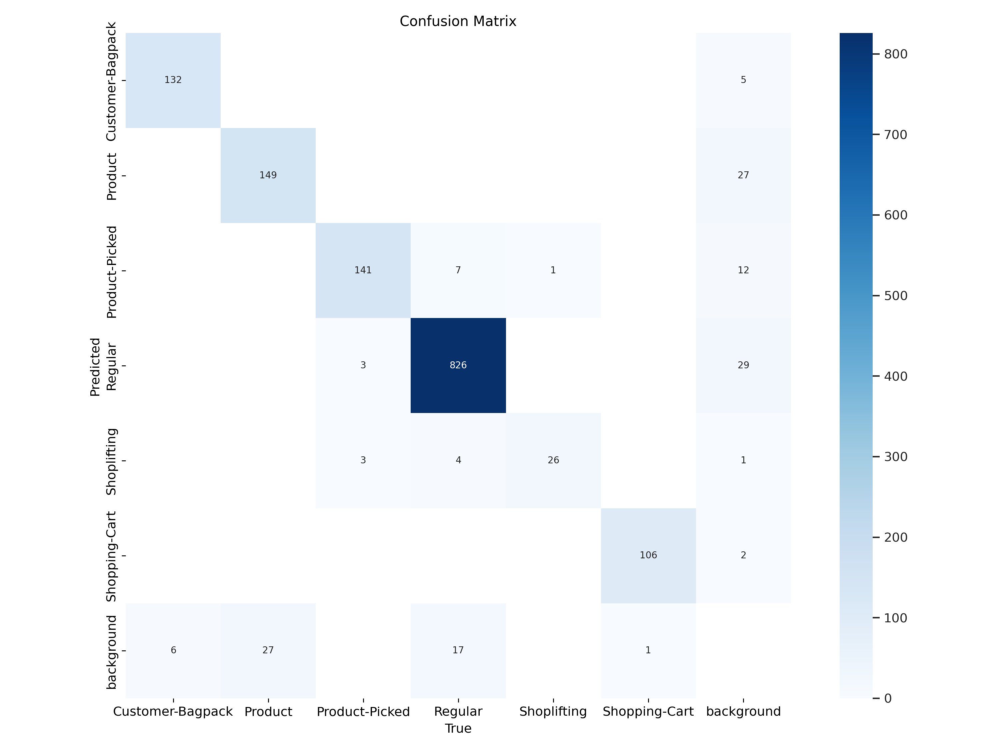

In [ ]:
from IPython.display import display, Image
Image(filename='/content/runs/detect/train82/confusion_matrix.png', width=600)

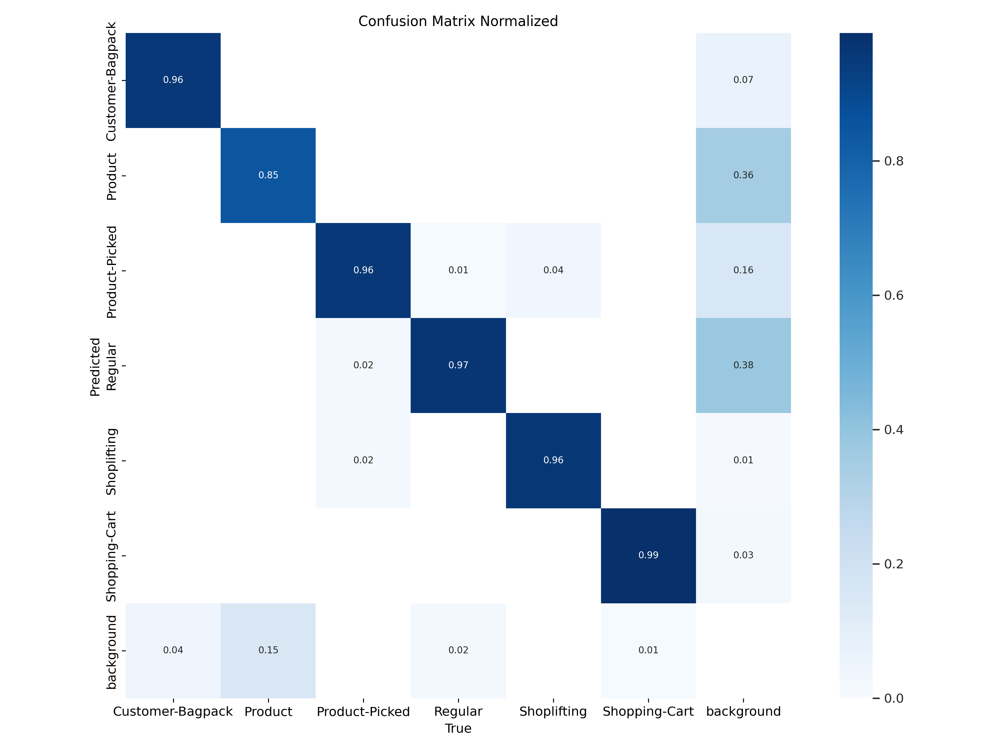

In [ ]:
Image(filename='/content/runs/detect/train82/confusion_matrix_normalized.png', width=600)

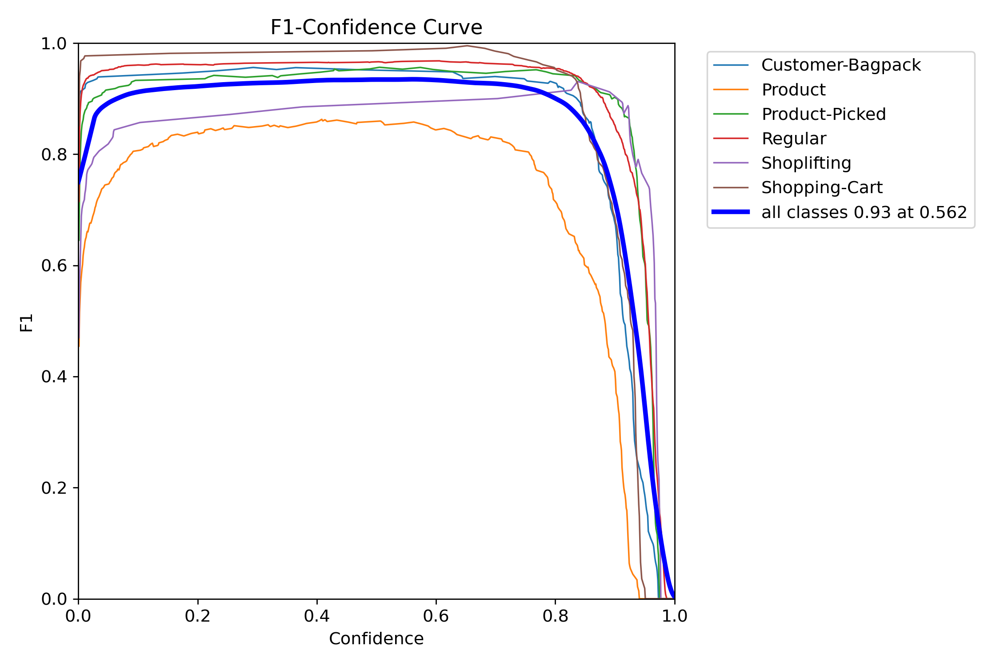

In [ ]:
Image(filename='/content/runs/detect/train82/F1_curve.png', width=600)

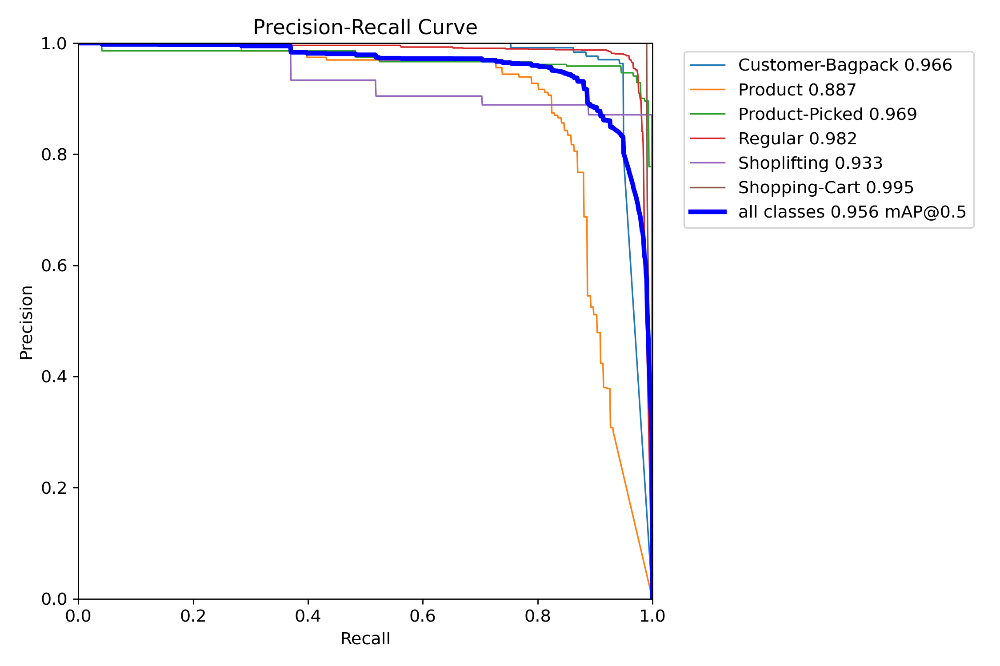

In [ ]:
Image(filename='/content/runs/detect/train82/PR_curve.png', width=600)

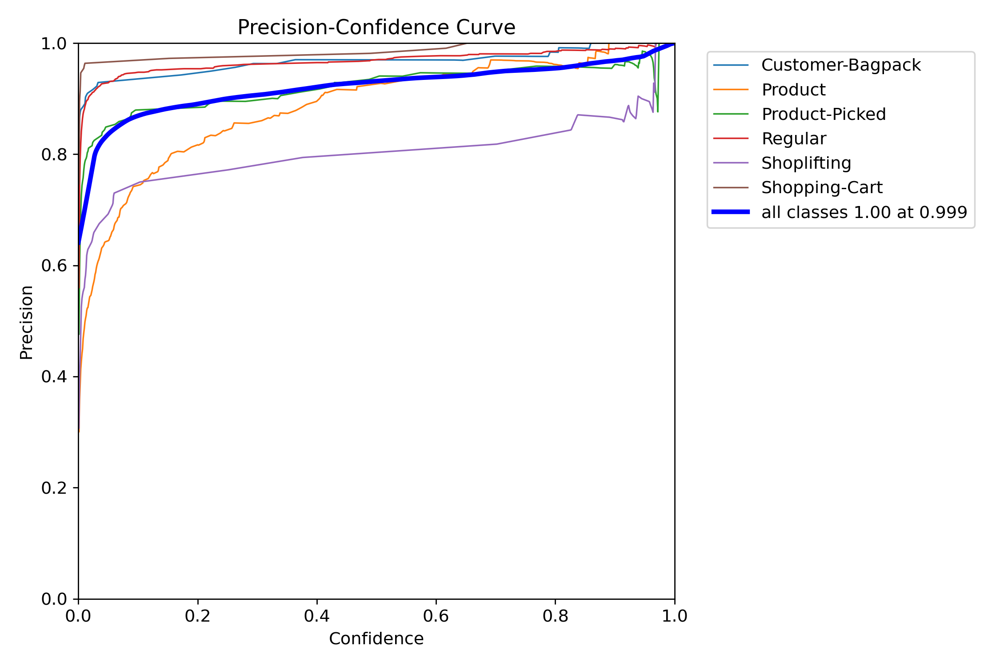

In [ ]:
Image(filename='/content/runs/detect/train82/P_curve.png', width=600)

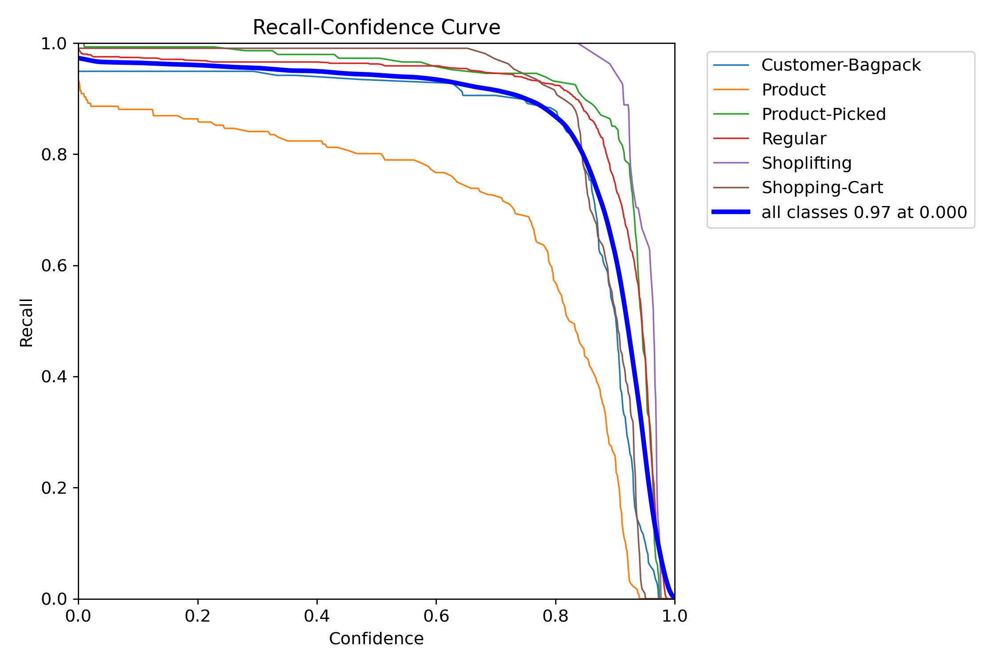

In [ ]:
Image(filename='/content/runs/detect/train82/R_curve.png', width=600)

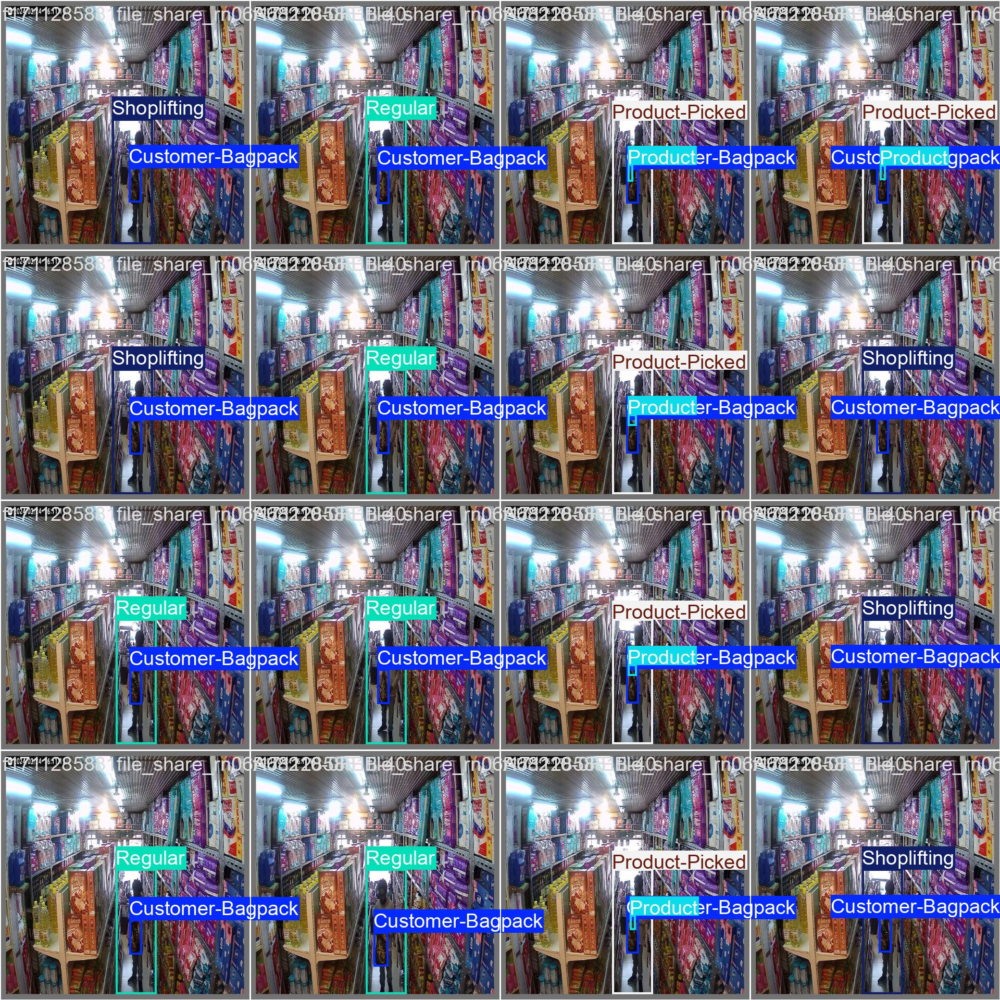

In [ ]:
Image(filename='/content/runs/detect/train82/val_batch2_labels.jpg', width=600)

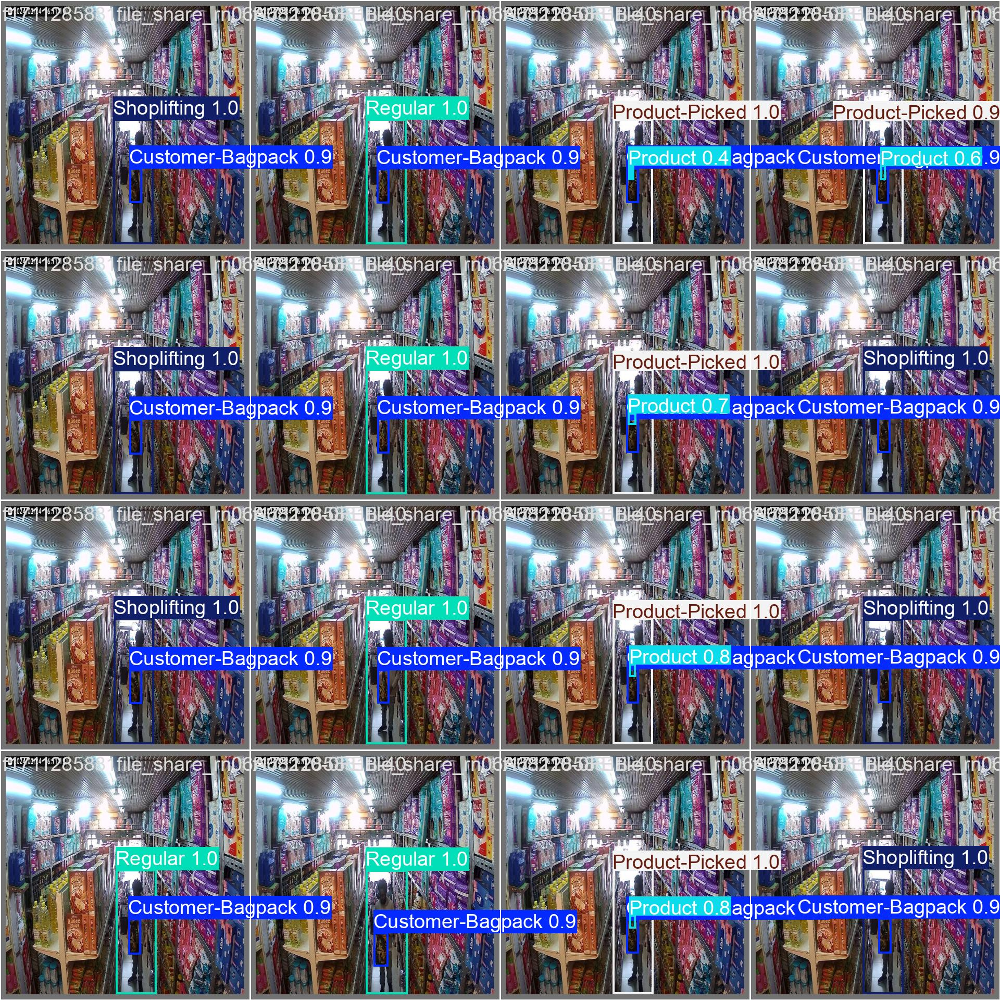

In [ ]:
Image(filename='/content/runs/detect/train82/val_batch2_pred.jpg', width=600)

# Final Prediction

Ultralytics YOLOv8.2.77 🚀 Python-3.10.12 torch-2.3.1+cu121 CUDA:0 (NVIDIA L4, 22700MiB)
Model summary (fused): 218 layers, 25,843,234 parameters, 0 gradients, 78.7 GFLOPs

image 1/1 /content/shoplifting_test.png: 352x640 1 Product-Picked, 153.0ms
Speed: 3.7ms preprocess, 153.0ms inference, 565.4ms postprocess per image at shape (1, 3, 352, 640)
Results saved to runs/detect/predict9
💡 Learn more at https://docs.ultralytics.com/modes/predict


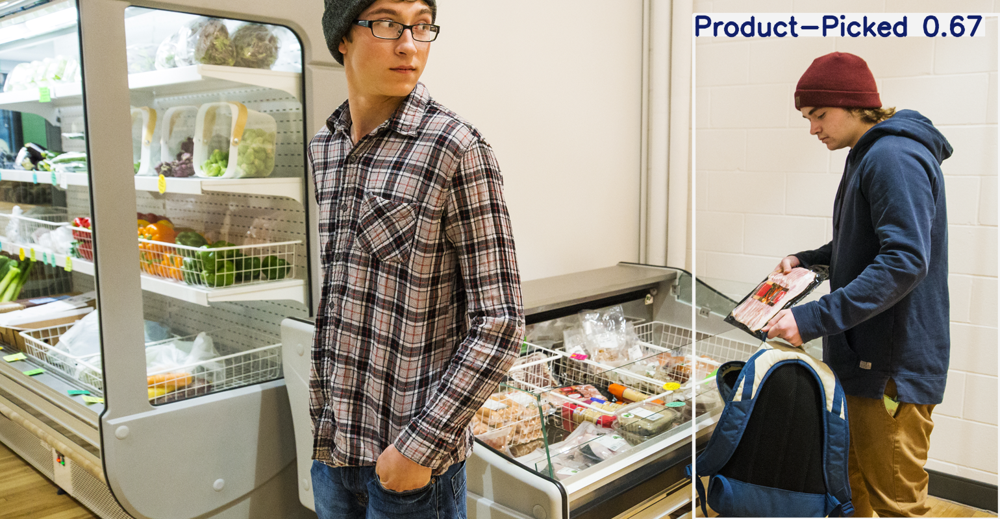

In [84]:
!yolo predict model=/content/runs/detect/train8/weights/best.pt source=/content/shoplifting_test.png
Image(filename='/content/runs/detect/predict8/shoplifting_test.png', width=600)

In [87]:
!yolo predict model=/content/runs/detect/train8/weights/best.pt source=/content/shoplifting_test1.png

Ultralytics YOLOv8.2.77 🚀 Python-3.10.12 torch-2.3.1+cu121 CUDA:0 (NVIDIA L4, 22700MiB)
Model summary (fused): 218 layers, 25,843,234 parameters, 0 gradients, 78.7 GFLOPs

image 1/1 /content/shoplifting_test1.png: 480x640 (no detections), 149.9ms
Speed: 4.7ms preprocess, 149.9ms inference, 37.0ms postprocess per image at shape (1, 3, 480, 640)
Results saved to runs/detect/predict9
💡 Learn more at https://docs.ultralytics.com/modes/predict


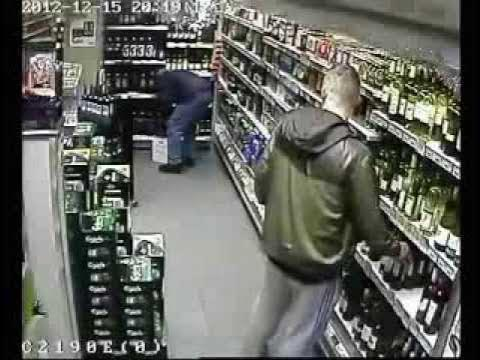

In [88]:
Image(filename='/content/runs/detect/predict9/shoplifting_test1.png', width=600)

In [ ]:
from google.colab import files
!zip -r /content/runs.zip /content/runs
files.download("/content/runs.zip")

  adding: content/runs/ (stored 0%)
  adding: content/runs/detect/ (stored 0%)
  adding: content/runs/detect/train72/ (stored 0%)
  adding: content/runs/detect/train72/val_batch1_labels.jpg (deflated 7%)
  adding: content/runs/detect/train72/confusion_matrix.png (deflated 23%)
  adding: content/runs/detect/train72/val_batch2_pred.jpg (deflated 4%)
  adding: content/runs/detect/train72/val_batch2_labels.jpg (deflated 5%)
  adding: content/runs/detect/train72/P_curve.png (deflated 11%)
  adding: content/runs/detect/train72/confusion_matrix_normalized.png (deflated 21%)
  adding: content/runs/detect/train72/val_batch0_labels.jpg (deflated 7%)
  adding: content/runs/detect/train72/PR_curve.png (deflated 13%)
  adding: content/runs/detect/train72/val_batch0_pred.jpg (deflated 7%)
  adding: content/runs/detect/train72/R_curve.png (deflated 9%)
  adding: content/runs/detect/train72/F1_curve.png (deflated 8%)
  adding: content/runs/detect/train72/val_batch1_pred.jpg (deflated 6%)
  adding: con

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

In [80]:
from google.colab import drive
drive.mount('/content/drive')
!cp -r /content/runs /content/drive/MyDrive

Mounted at /content/drive


# Live Prediction

In [84]:
import cv2
from ultralytics import YOLO
from IPython.display import display, clear_output
import PIL.Image
import time

In [87]:
def shoplifting_detection(model_path, video_source, threshold=0.5):
    """Detect shoplifting in video using YOLO and display live with boundary boxes."""
    model = YOLO(model_path)
    cap = cv2.VideoCapture(video_source)

    # Get the FPS of the video
    fps = cap.get(cv2.CAP_PROP_FPS)
    frame_duration = 1 / fps  # Duration of each frame in seconds

    # Speed factor: how much faster the playback should be
    speed_factor = 30
    frame_duration_fast = frame_duration / speed_factor  # Adjust frame duration for fast playback

    # Time tracking for frame display
    last_frame_time = time.time()

    while cap.isOpened():
        ret, frame = cap.read()
        if not ret:
            break

        current_time = time.time()

        # Process and display frame
        try:
            results = model(frame)
            
            for result in results:
                boxes = result.boxes
                
                for box in boxes:
                    x1, y1, x2, y2 = map(int, box.xyxy[0])
                    confidence = box.conf[0]
                    label = box.cls[0]
                    
                    if confidence > threshold:
                        class_name = model.names[int(label)]
                        
                        # Draw the bounding box
                        cv2.rectangle(frame, (x1, y1), (x2, y2), (0, 255, 0), 2)
                        
                        # Create a filled rectangle as background for the text
                        text = f'{class_name}: {confidence:.2f}'
                        (text_width, text_height), baseline = cv2.getTextSize(text, cv2.FONT_HERSHEY_SIMPLEX, 0.7, 2)
                        text_x = x1 - text_width - 10  # Position text to the left of the bounding box
                        text_y = y1 + text_height + 10  # Position text below the top edge of the bounding box
                        
                        # Ensure text is within the frame
                        if text_x < 0:
                            text_x = x1 + 10
                        
                        # Draw the filled rectangle for the text background
                        cv2.rectangle(frame, (text_x, text_y - text_height - 10), (text_x + text_width, text_y + 10), (0, 255, 0), -1)
                        
                        # Put the text on the filled rectangle
                        cv2.putText(frame, text, (text_x, text_y),
                                    cv2.FONT_HERSHEY_SIMPLEX, 0.7, (0, 0, 0), 2, lineType=cv2.LINE_AA)
        except Exception as e:
            print(f"Error during model prediction: {e}")

        # Convert BGR to RGB for IPython display
        frame_rgb = cv2.cvtColor(frame, cv2.COLOR_BGR2RGB)
        pil_img = PIL.Image.fromarray(frame_rgb)
        
        # Display the image using IPython display
        clear_output(wait=True)
        display(pil_img)

        # Speed up playback by reducing the delay
        frame_end_time = time.time()
        time_to_wait = frame_duration_fast - (frame_end_time - last_frame_time)
        if time_to_wait > 0:
            time.sleep(time_to_wait)
        
        # Update the time for the next frame
        last_frame_time = time.time()

    cap.release()

In [96]:
video_path = r'C:\Users\user\Downloads\istockphoto-1995820194-640_adpp_is.mp4'
shoplifting_detection(r'C:\Users\user\Downloads\fine_tune_best.pt', video_source=video_path, threshold=0.5)

KeyboardInterrupt: 

In [93]:
from ultralytics import YOLO
import ultralytics
import supervision as sv
import cv2
import numpy as np

model = YOLO(r'C:\Users\user\Downloads\fine_tune_best.pt')
#model = YOLO('/content/yolov8n.pt')

In [95]:
cap = cv2.VideoCapture('/content/istockphoto-1995820194-640_adpp_is.mp4')
cap.set(cv2.CAP_PROP_FRAME_WIDTH, 1280)
cap.set(cv2.CAP_PROP_FRAME_HEIGHT, 780)

# Initialize the BoxAnnotator with the required thickness
box_annotator = sv.BoxAnnotator(thickness=1)
label_annotator = sv.LabelAnnotator(text_scale=0.4, text_padding=1, text_position=sv.Position.CENTER_LEFT)

while True:
    ret, frame = cap.read()

    if not ret:
        break  # Break the loop if no more frames are returned

    result = model(frame)[0]
    detections = sv.Detections.from_ultralytics(result)

    # Create labels for detections
    labels = [
        f"{model.model.names[class_id]} {confidence:0.2f}"
        for class_id, confidence in zip(detections.class_id, detections.confidence)
    ]

    # Annotate the frame with bounding boxes and labels
    frame = box_annotator.annotate(
        scene=frame,
        detections=detections
    )
    frame = label_annotator.annotate(
        scene=frame,
        detections=detections,
        labels=labels
    )

    # Display the annotated frame
    cv2.imshow(frame)
    time.sleep(0.04)

    if cv2.waitKey(30) == 27:  # 27 is the ASCII code for the 'Esc' key
        break

cap.release()  # Release the video capture object
cv2.destroyAllWindows()  # Close all OpenCV windows

error: OpenCV(4.9.0) D:\a\opencv-python\opencv-python\opencv\modules\highgui\src\window.cpp:1266: error: (-2:Unspecified error) The function is not implemented. Rebuild the library with Windows, GTK+ 2.x or Cocoa support. If you are on Ubuntu or Debian, install libgtk2.0-dev and pkg-config, then re-run cmake or configure script in function 'cvDestroyAllWindows'
